# **Inference of Cardiac Category from Biomedical Data**

## **Conclusions:**
- **E_A_ratio is the only parameter necessary to predict Cardiac Category**
    - E_A_ratio has the highest feature importance by far
    - 3 Classifiers had 100% Cross-Validation (CV) score for predicting Cardiac Category when E_A_ratio is present 
- **Removing E_A_ratio worsens model performance significantly, little to no predictive power remains.**
    - RandomForestClassifier has the best performance in this case, with CV score of 62% and MeanSquaredError of 61.64%. (Not great at all)
- **Physical functional parameters, and all other parameters, have little to no power in predicting E_A_ratio**
    - Correlation index of PhysFuncParams to E_A_ratio is low.
    - Even with ALL parameters present, scores for predicting E_A_ratio using regression is still negative for all reg models.
    - Even with hyperparameter tuning for RandomForestRegressor to predict E_A_ratio using PhysFuncParams, accuracy is still low


In [4]:
# Cell 1
"""
Ideas for a one-size-fits-all pipeline:

Check if target column is categorical or continuous
Apply from dict of classification or regression models based on above
Check if each column is categorical or continous
perform one-hot encoding for categorical columns
Apply appropriate data visualisations to each
Apply correlations Matrix
Apply scaling and PCA if too many features (>20?)

IMPORTANT: Modify pipeline such that imputation of NA values are done using median of train
set AFTER the split. Save this median for use in test set

Next steps: 
- Remove white columns (look at original excel sheet)  (Done)
- Group features by colors according to excel sheet (Done)
- Check for level of correlation (correlation matrix) (Done)
- Visualise correlation matrix (Done)
- Apply scaling (standard/minmax) (Done)
- Use PCA to reduce dimension (Skipped) https://www.datacamp.com/community/tutorials/principal-component-analysis-in-python
- Apply classification algos for each color (Done)
- Apply above for everything combined (Done)
- Implement hyperparameter tuning (Optional)
- Additional data visualisation for each parameter (Split into categorical and continous)(Optional)
- Apply unsupervised learning to check for clustering
- Cleanup
- Write clear comments for future reference
- Write and present data nicely
"""
import math
import warnings
import pandas as pd
import numpy as np
import sklearn 
import seaborn as sn
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from pathlib import Path
import os
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, cross_val_score, RepeatedStratifiedKFold, KFold, StratifiedKFold
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,roc_curve, roc_auc_score,plot_roc_curve
from sklearn.feature_selection import RFECV
from sklearn.pipeline import Pipeline
from sklearn.svm import SVR, SVC
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import ShuffleSplit, GridSearchCV
from sklearn.pipeline import make_pipeline, make_union
from sklearn.linear_model import LinearRegression,LogisticRegression 
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import BaggingRegressor, ExtraTreesClassifier
from sklearn.neighbors import KNeighborsRegressor,KNeighborsClassifier
from sklearn.tree import DecisionTreeRegressor,DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingRegressor,GradientBoostingClassifier, ExtraTreesClassifier
from tpot.builtins import StackingEstimator
from tpot.export_utils import set_param_recursive

import itertools
from xgboost import XGBRegressor, XGBClassifier
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier
from lightgbm import LGBMRegressor,LGBMClassifier

import seaborn as sns
import warnings
from scipy import stats
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)


data = pd.read_csv("kohsm1.csv",encoding='latin1')

#Removal of irrelevant white columns
data.drop('IDshort', axis=1, inplace=True)
data.drop('SERNO', axis=1, inplace=True)

#Full Data containing only each category as targets
data_full = data.drop('Cardiac_Category EE (0=good; 1=poor)', axis=1)
# dataEE_full = data.drop('Cardiac_Category (0=good; 1=poor)', axis=1)

#List of columns according to color category
#Blue
clinParamsCols=["IDshort","Age","Weightkg","Heightcm","Pulse","WaistCircumferencecm","SERNO","Gender","SBP","DBP","Hips_Circumference__cm","Hypertension__Yes_1_No_0","Dyslipidemia__Yes_1_No_0","Diabetes_mellitus__Yes_1_No_0","Smoking__Never_0_Current_1_Past","DiabetesmellitusDietcontrol","AlcoholNever0Current1Past"]

#Teal
exerciseCols=["PhysicalactivityfrequencyIna","IntensityTakeiteasy1Heavy","Duration15min116to30min","VO2Max"]

#Violet
echoCols=["BSA__m2","IVSD__cm","IVSS__cm","LVIDD_cm","LVIDS_cm","LVPWD_cm","LVPWS_cm","LVOT__cm","AO_cm","LA_cm","LVEF","LVFS","LVmass_echo","LVmass_index_echo","Left_atrial_volume","Left_atrial_volume_index","MV_E_peak__m_s","MV_A_peak__m_s","E_A_ratio","MV_DT__ms","PASP__mmHg","PVS__cm_s","PVD__cm_s","PVA__cm_s","PVADur","MVADur","septalS","Septal_E","Septal_A","Lateral_S","lateralE","lateralA","sinuscm","sinus_tubular_junctioncm","ave_Eprime","E_Eprime_ratio"]

#Grey
cmrCols=["LV_Mass_on_mri__g","LV_EDV","EDV067","LV_ESV","LV_SV","LVEF_A","Ss","Se","Sa","SRs","SRe","SRa","SRe_SRaratio","LVGLS","LVGCS","LVGRS","RVGLS","LAGlobalGLS","LAGlobalGCS","LAvolumeminml","LAvolumemaxml","LAEFTotal","LVMassg","LVEDVImlm2","LVESVImlm2","LVSVImlm2"]

#Beige
bloodBioCols=["MCP1pgmL","MMP9ngmL","BNP","HSTNI","GALECTIN3","sUPAR","qTL","extra_urea","extra_creatinine","extra_total_cholesterol","extra_triglycerides","extra_HDL","extra_LDL","extra_tc_HDL_ratio","extra_albumin","extra_hsCRP","HbA1c"]

#Green
physFuncParamsCols=["Gripmax","G1L","G2L","G1R","G2R","SMM","BFM","PBF","WHR","Fitness_score","BMR","Lean_LA","Lean_RA","Lean_LL","Lean_RL","Lean_T","ALM"]

#Orange
curMetaCols=["TC","FC","C2","C3","C4","C51","C5","C4OH","C6","C5OHC3DC","C4DCC6OH","C81","C8","C5DC","C81OHC61DC","C8OHC6DC","C103","C102","C101","C10","C7DC","C81DC","C8DC","C122","C121","C12","C122OHC102DC","C121OH","C12OHC10DC","C143","C142","C141","C14","C143OHC123DC","C142OH","C141OH","C14OHC12DC","C163","C162","C161","C16","C163OHC143DC","C162OH","C161OHC141DC","C16OH","C183","C182","C181","C18","C183OHC163DC","C182OHC162DC","C181OHC161DC","C18OHC16DC","C204","C203","C202","C201","C20","C203OHC183DC","C202OHC182DC","C201OHC181DC","C20OHC18DC","C225","C224","C223","C222","C221","C22","C24","C26","C28","Gly1","Ala1","Ser1","Pro1","Val1","Leu1","IleLeu1","Orn1","Met1","His1","Phe1","Arg1","Cit1","Tyr1","Asp1","Glu1","Trp1"]

#Yellow
histMetaCols=["HistoC2","HistoC3","HistoC4","HistoC51","HistoC5","HistoC4NDOH","HistoC6","HistoC5NDOHC3NDDC","HistoC4NDDCC6NDOH","HistoC81","HistoC8","HistoC5NDDC","HistoC81NDOHC61NDDC","HistoC8NDOHC6NDDC","HistoC103","HistoC102","HistoC101","HistoC10","HistoC7NDDC","HistoC81NDDC","HistoC8NDDC","HistoC122","HistoC121","HistoC12","HistoC122NDOHC102NDDC","HistoC121NDOH","HistoC12NDOHC10NDDC","HistoC143","HistoC142","HistoC141","HistoC14","HistoC143NDOHC123NDDC","HistoC142NDOH","HistoC141NDOH","HistoC14NDOHC12NDDC","HistoC163","HistoC162","HistoC161","HistoC16","HistoC163NDOHC143NDDC","HistoC162NDOH","HistoC161NDOHC141NDDC","HistoC16NDOH","HistoC183","HistoC182","HistoC181","HistoC18","HistoC183NDOHC163NDDC","HistoC182NDOHC162NDDC","HistoC181NDOHC161NDDC","HistoC18NDOHC16NDDC","HistoC204","HistoC203","HistoC202","HistoC201","HistoC20","HistoC203NDOHC183NDDC","HistoC202NDOHC182NDDC","HistoC201NDOHC181NDDC","HistoC20NDOHC18NDDC","HistoC225","HistoC224","HistoC223","HistoC222","HistoC221","HistoC22","HistoC24","HistoC26","HistoC28","HistoCode","HistoGly1_ConcµM","HistoAla1_ConcµM","HistoSer1_ConcµM","HistoPro1_ConcµM","HistoVal1_ConcµM","HistoLeu1_ConcµM","HistoIle1_ConcµM","HistoOrn1_ConcµM","HistoMet1_ConcµM","HistoHis1_ConcµM","HistoPhe1_ConcµM","HistoCit1_ConcµM","HistoTyr1_ConcµM","HistoAsp1_ConcµM","HistoGlu1_ConcµM","HistoTrp1_ConcµM"]

targets=["Cardiac_Category (0=good; 1=poor)","Cardiac_Category EE (0=good; 1=poor)"]

# List comprising of params and Cardiac Category
clinParamsColsCC = clinParamsCols + [targets[0]] 
exerciseColsCC = exerciseCols + [targets[0]]
echoColsCC = echoCols + [targets[0]]
cmrColsCC = cmrCols + [targets[0]]
bloodBioColsCC = bloodBioCols + [targets[0]]
physFuncParamsColsCC = physFuncParamsCols + [targets[0]]
curMetaColsCC = curMetaCols + [targets[0]]
histMetaColsCC = histMetaCols + [targets[0]]

# List comprising of params and Cardiac Category_EE
"""
clinParamsColsCCEE = clinParamsCols + [targets[1]] 
histMetaColsCCEE = histMetaCols + [targets[1]]
exerciseColsCCEE = exerciseCols + [targets[1]]
echoColsCCEE = echoCols + [targets[1]]
cmrColsCCEE = cmrCols + [targets[1]]
bloodBioColsCCEE = bloodBioCols + [targets[1]]
physFuncParamsColsCCEE = physFuncParamsCols + [targets[1]]
curMetaColsCCEE = curMetaCols + [targets[1]]
"""
# https://stackoverflow.com/questions/48198021/filter-pandas-dataframe-with-specific-column-names-in-python

#Dataframe containing parameters and Cardiac Category
clinParamsColsCC_df=data.loc[:, data.columns.isin(clinParamsColsCC)]
exerciseColsCC_df=data.loc[:, data.columns.isin(exerciseColsCC)]
echoColsCC_df=data.loc[:, data.columns.isin(echoColsCC)]
cmrColsCC_df=data.loc[:, data.columns.isin(cmrColsCC)]
bloodBioColsCC_df=data.loc[:, data.columns.isin(bloodBioColsCC)]
physFuncParamsColsCC_df=data.loc[:, data.columns.isin(physFuncParamsColsCC)]
curMetaColsCC_df=data.loc[:, data.columns.isin(curMetaColsCC)]
histMetaColsCC_df=data.loc[:, data.columns.isin(histMetaColsCC)]

#Dataframe containing parameters and Cardiac CategoryEE
""" 
clinParamsColsCCEE_df=data.loc[:, data.columns.isin(clinParamsColsCCEE)] 
exerciseColsCCEE_df=data.loc[:, data.columns.isin(exerciseColsCCEE)]
echoColsCCEE_df=data.loc[:, data.columns.isin(echoColsCCEE)]
cmrColsCCEE_df=data.loc[:, data.columns.isin(cmrColsCCEE)]
bloodBioColsCCEE_df=data.loc[:, data.columns.isin(bloodBioColsCCEE)]
physFuncParamsColsCCEE_df=data.loc[:, data.columns.isin(physFuncParamsColsCCEE)]
curMetaColsCCEE_df=data.loc[:, data.columns.isin(curMetaColsCCEE)]
histMetaColsCCEE_df=data.loc[:, data.columns.isin(histMetaColsCCEE)]
 """
#Dict of dataframes of each color cateogry for cardiac category
cc_dfDict = {
    "clinParams":clinParamsColsCC_df,
    "exercise":exerciseColsCC_df,
    "echo":echoColsCC_df,
    "cmr":cmrColsCC_df,
    "bloodBio":bloodBioColsCC_df,
    "physFuncParams":physFuncParamsColsCC_df,
    "curMeta":curMetaColsCC_df,
    "histMeta":histMetaColsCC_df
}

#Dict of dataframes of each color cateogry for cardiac category EE
""" 
ccee_dfDict = {
    "clinParams":clinParamsColsCCEE_df,
    "exercise":exerciseColsCCEE_df,
    "echo":echoColsCCEE_df,
    "cmr":cmrColsCCEE_df,
    "bloodBio":bloodBioColsCCEE_df,
    "physFuncParams":physFuncParamsColsCCEE_df,
    "curMeta":curMetaColsCCEE_df,
    "histMeta":histMetaColsCCEE_df
}
"""

for key in cc_dfDict:
    print(f"Shape of {key}: {cc_dfDict[key].shape}")

""" 
for key in ccee_dfDict:
    print(f"Shape of {key+'(EE)'}: {cc_dfDict[key].shape}") 
"""

Shape of clinParams: (86, 16)
Shape of exercise: (86, 5)
Shape of echo: (86, 37)
Shape of cmr: (86, 27)
Shape of bloodBio: (86, 18)
Shape of physFuncParams: (86, 18)
Shape of curMeta: (86, 89)
Shape of histMeta: (86, 87)


' \nfor key in ccee_dfDict:\n    print(f"Shape of {key+\'(EE)\'}: {cc_dfDict[key].shape}") \n'

In [5]:
# Cell 2
#https://stackoverflow.com/questions/45515031/how-to-remove-columns-with-too-many-missing-values-in-python
"""
def missing(dff):
    print (round((dff.isnull().sum() * 100/ len(dff)),2).sort_values(ascending=False))
"""

# Helper function
def rmissingvaluecol(df, threshold,verbose=False):
    # If threshold is 80 it means we are going to drop columns having more than 80% of missing values
    l = []
    l = list(df.drop(df.loc[:,list((100*(df.isnull().sum()/len(df.index)) >= threshold))].columns, 1).columns.values)
    if verbose:
        print("Number of columns having more than %s percent missing values: "%threshold, (df.shape[1] - len(l)))
        print("These columns are:\n", list(set(list((df.columns.values))) - set(l)))
    # Returns columns that are missing less than threshold % of data
    return l
    
def preprocessDf(df,threshold=40,verbose=False):
    if verbose:
        print("Preprocessing dataframe...")
    originalShape = df.shape
    newDf = df.copy()
    
    for col in newDf:
        #Checks for categorical columns that only have 2 values, and converts them to binary
        uniqueVals = pd.unique(newDf[col])
        if len(uniqueVals) == 2:
            if not(np.int64(0) in uniqueVals and np.int64(1) in uniqueVals):
                if verbose:
                    print(f"{col} column contains only 2 values. Converting to binary")
                    print(uniqueVals[0])
                newDf[col] = np.where(newDf[col] == uniqueVals[0],np.int64(0),newDf[col])
                newDf[col] = np.where(newDf[col] == uniqueVals[1],np.int64(1),newDf[col])
                #Renames column with labels for binary values
                newDf.rename(columns={col:col + f"_{uniqueVals[0]}_0_{uniqueVals[1]}_1"}, inplace=True)
    
    # Converting values that are non-numeric to NA
    newDf = newDf.apply(pd.to_numeric,errors='coerce')
    if verbose:
        print("Converting values that are non-numeric AND non-binary to NaN...")
    newCols = rmissingvaluecol(newDf,threshold,verbose=verbose) #Removes columns with more than threshold of missing data
    if verbose:
        print("Columns with missing values (%):")
    newDf_missing = newDf.isna().sum()
    newDf_missing = newDf_missing[newDf_missing > 0].dropna().sort_values(ascending=False)
    newDf_missing = newDf_missing.apply(lambda x: np.round((x/originalShape[0])*100,2))
    if verbose:
        print(newDf_missing)
    newDf = newDf[newCols]

    if verbose:
        print(f"Original Shape:{df.shape}")
        print(f"Final Shape:{newDf.shape}")
        print("______________________________")
    return newDf

#https://stackoverflow.com/questions/17778394/list-highest-correlation-pairs-from-a-large-correlation-matrix-in-pandas

# Helper function for get_top_abs_correlations. returns list of redundant pairs to be dropped
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

# Function that returns a table of correlation indexes in descending order
def get_top_abs_correlations(df, threshold=0.6):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[au_corr>=threshold]


# Because of mixed data type (Binary and Non-binary), it would probably be 
# more correct to use Factor analysis of mixed data (FAMD) instead of simple PCA. 
# https://github.com/MaxHalford/prince#factor-analysis-of-mixed-data-famd

# Function currently not being used
def scaleAndPca(df,target,explainabilityThreshold = 0.85):
    #print(df)
    # Removes target column
    newDf = df.drop([target], axis=1)
    
    featuresLength = newDf.shape[1]
    
    """
    nonBinary = newDf.columns[~newDf.isin([0,1]).all()]
    binary = newDf.columns[newDf.isin([0,1]).all()]
    """
    scaler = StandardScaler()
    scaler.fit(newDf)
    
    newDf = scaler.transform(newDf)
    # https://towardsdatascience.com/one-hot-encoding-standardization-pca-data-preparation-steps-for-segmentation-in-python-24d07671cf0b
    # Loop Function to identify number of principal components that explain at least threshold% of the variance
    for comp in range(1, featuresLength):
        pca = PCA(n_components= comp, random_state=0)
        pca.fit(newDf)
        comp_check = pca.explained_variance_ratio_
        final_comp = comp
        if comp_check.sum() > explainabilityThreshold:
            break 
    Final_PCA = PCA(n_components= final_comp,random_state=0)
    Final_PCA.fit(newDf)
    cluster_newDf = Final_PCA.transform(newDf)
    cluster_newDf = pd.DataFrame(cluster_newDf) 
    combinedDf = pd.concat([cluster_newDf, df[target]], axis=1)
    num_comps = comp_check.shape[0]
    print(f"Reducing {featuresLength} features to {final_comp} components, we can explain {comp_check.sum()}% of the variability in the original data.")
    return combinedDf

#scaleAndPca(cc_dfDictNew["clinParams"],"Cardiac_Category (0=good; 1=poor)")


In [6]:
# Cell 3
# Display correlation data above given threshold
def outputCorrData(df,threshold=0.6,filename="Output",generateFiles=False):
    df = preprocessDf(df)
    df = df.fillna(df.median())
    # Creates correlation matrix
    corrDf = df.corr()
    # Creates corr matrix, showing correlations above given threshold
    filteredDf = corrDf[((corrDf >= threshold) | (corrDf <= -threshold)) & (corrDf !=1.000)]
    plt.figure(figsize=(20,17))
    sn.heatmap(filteredDf, annot=True, cmap="Reds")
    plt.title(f"{filename} Correlation Heatmap (Threshold: >= abs{threshold})",fontsize=20)
    # Returns a table of correlation indexes in descending order
    
    cmrCorrTable = get_top_abs_correlations(df, threshold).to_frame()
    cmrCorrTable.columns =['Abs Corr Idx']
    plt.show

    # Generates excel and png files of output in your system for future reference
    if generateFiles:
        if not os.path.exists('Outputs/Plots'):
            os.makedirs('Outputs/Plots')
        if not os.path.exists('Outputs/Tables'):
            os.makedirs('Outputs/Tables')
        plt.savefig(f'Outputs/Plots/corr_{filename}_heatmap.png')
        cmrCorrTable.to_excel(f'Outputs/Tables/corr_{filename}_table.xlsx') 
    return corrDf




def plot_feature_importance(importance,names,title):
    # Adapted from https://www.analyseup.com/learn-python-for-data-science/python-random-forest-feature-importance-plot.html
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sn.barplot(x=fi_df['feature_importance'][:20], y=fi_df['feature_names'][:20])
    
    #Add chart labels
    plt.title(title)
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')
    print(f"Top 10 features: {list(fi_df['feature_names'][:10])}")
    plt.show()
    return fi_df # returns full feature importance dataframe

#https://analyticsindiamag.com/how-to-implement-ml-models-with-small-datasets/

# https://stats.stackexchange.com/questions/416553/can-k-fold-cross-validation-cause-overfitting#:~:text=2%20Answers&text=K%2Dfold%20cross%20validation%20is,fold%20cross%2Dvalidation%20removes%20overfitting.

# Adapted from https://www.kaggle.com/brsdincer/heart-attack-prediction-detailed-explanation

# k-fold CV is used to DETECT overfitting, since it trains the model from scratch each time 


def compareClasModelVer2(df,target,test_size=0.25,title="Dataset",showImportance=False,confusionMatrix=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df,verbose=True)
    
    print("Initialising models...")
    xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=0)
    xTrain = xTrain.fillna(xTrain.median())
    xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LogisticRegression().fit(xTrain,yTrain)
    gnb = GaussianNB().fit(xTrain,yTrain)
    knnc = KNeighborsClassifier().fit(xTrain,yTrain)
    dtc = DecisionTreeClassifier(random_state=0).fit(xTrain,yTrain)
    rfc = RandomForestClassifier(random_state=0,verbose=False).fit(xTrain,yTrain)
    gbmc = GradientBoostingClassifier(verbose=False).fit(xTrain,yTrain)
    xgbc = XGBClassifier(eval_metric="auc").fit(xTrain,yTrain)
    lgbmc = LGBMClassifier().fit(xTrain,yTrain)
    sv = SVC().fit(xTrain,yTrain)

    models = [lr,gnb,knnc,dtc,rfc,gbmc,xgbc,lgbmc,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","AccuracyScore","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        yPred = model.predict(xTest)
        accuracy = accuracy_score(yTest,yPred)
        #confusionMatrixArray = confusion_matrix(yTest, predict)
        #plt.figure()
        #plot_roc_curve(model, xTest, yTest)  
        #plt.show()

        # Note here that imputation in this manner would lead to some data leakages into the test set
        # during the cross validation process. Data for imputation should ideally be confined to
        # the train set within each fold. 
        # However, for sake of expediency, I am just going to impute using the whole data
        imputedX = x.fillna(x.median())
        cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)

        cvAccuracyScore = cross_val_score(model,imputedX,y,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,imputedX,y,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,imputedX,y,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,imputedX,y,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,imputedX,y,cv=cv,scoring='f1').mean()
        """
        cvAccuracyScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,xTest,yTest,cv=cv,scoring='f1').mean()
        """
        #error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=cv,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,accuracy,cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score]],columns=["Model","AccuracyScore","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
        comparison = comparison.append(result)
        
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name)
            except AttributeError:
                continue
    
    print(comparison)

    comparisonMelted = pd.melt(comparison,id_vars=['Model'])
    plt.figure(figsize=(14,8))

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Percentage Score')
    plt.xlim(0, 1)
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    
    return comparison


In [7]:
# Cell 4.5
"""for key in cc_dfDict:
    width = max(cc_dfDict[key].shape[1]*2,14)
    height = max(cc_dfDict[key].shape[1],7)
    ax = cc_dfDict[key].hist(figsize=(width,height))
    plt.suptitle(key, fontsize=width+height, ha='center', va ='center')
    plt.show()"""

"for key in cc_dfDict:\n    width = max(cc_dfDict[key].shape[1]*2,14)\n    height = max(cc_dfDict[key].shape[1],7)\n    ax = cc_dfDict[key].hist(figsize=(width,height))\n    plt.suptitle(key, fontsize=width+height, ha='center', va ='center')\n    plt.show()"

In [8]:
key = "clinParams"
mainDf = preprocessDf(featureEngineeredDf,verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)

for idx,column in enumerate(mainDf.columns):
    #plt.figure()    
    # use bins of mainDf, dropping na values in the process         
    bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
    sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
    sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
    #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
#plt.tight_layout()
fig.suptitle(title,fontsize=20, ha='center', va ='center')
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
plt.show()
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')

NameError: name 'featureEngineeredDf' is not defined

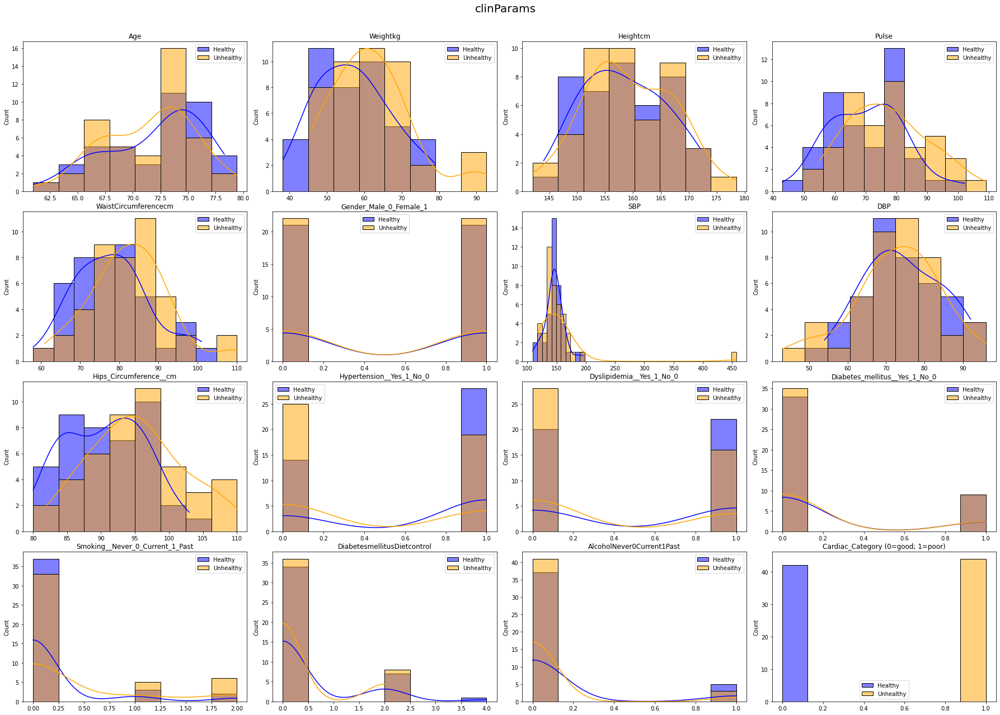

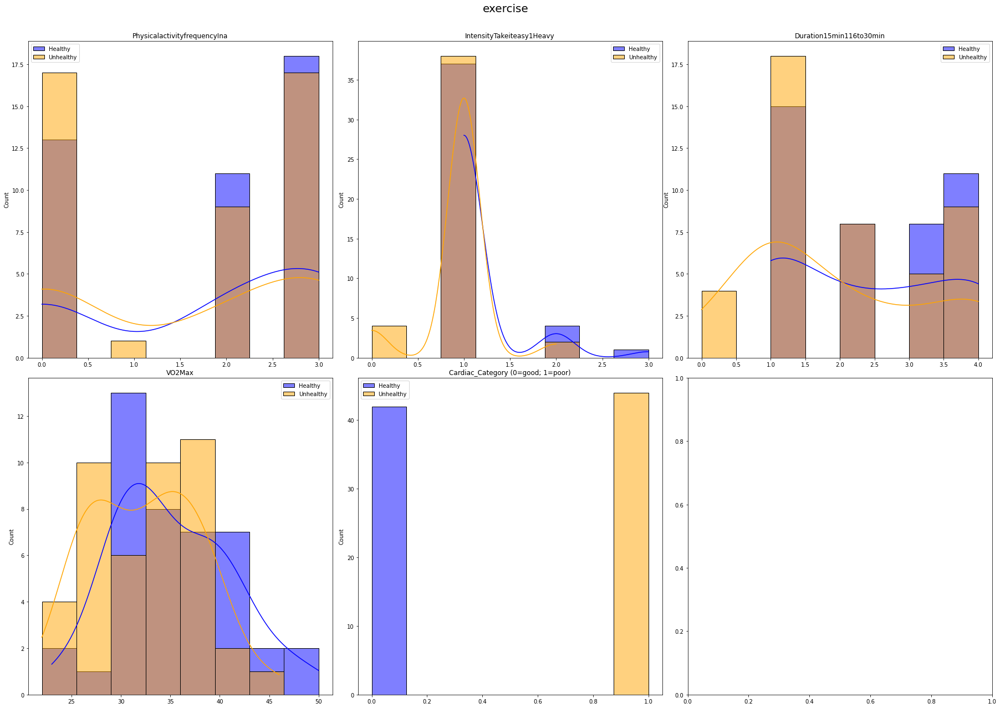

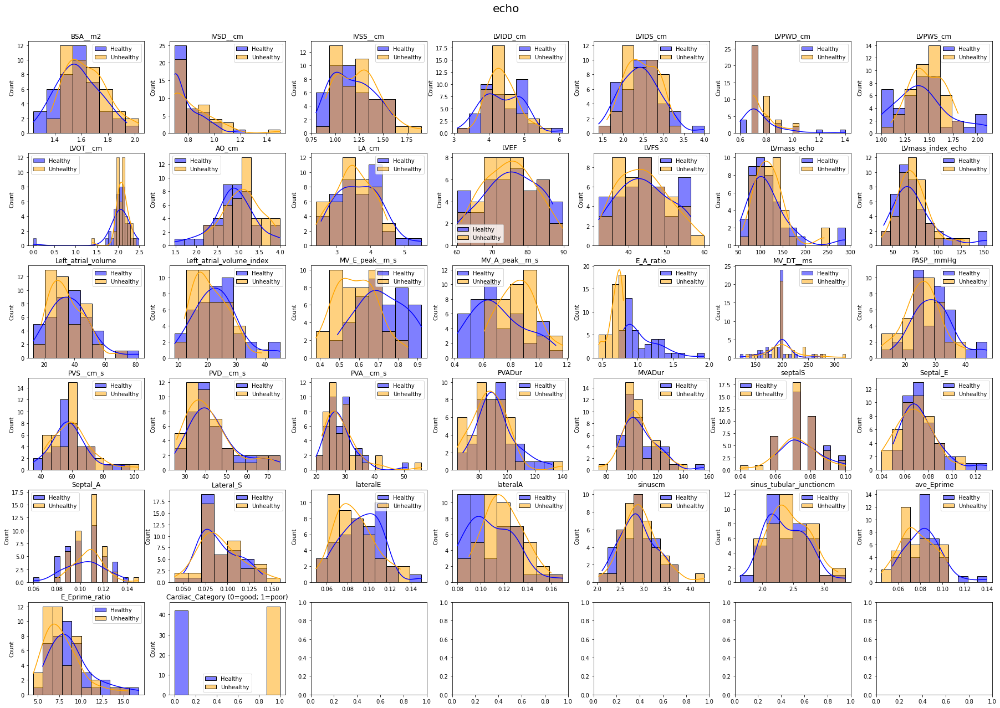

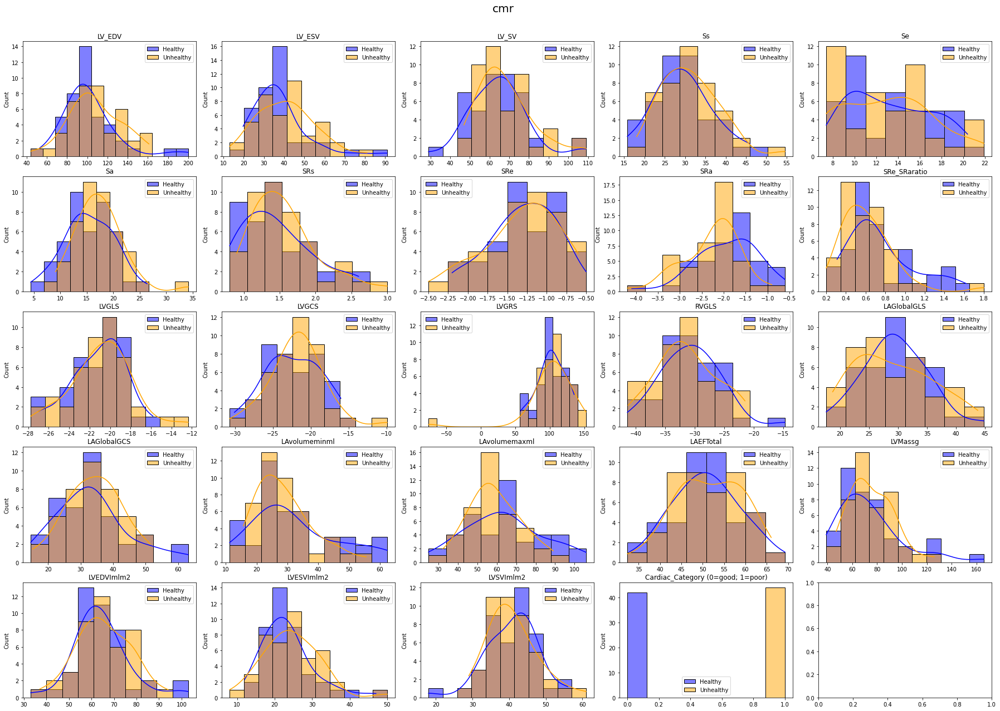

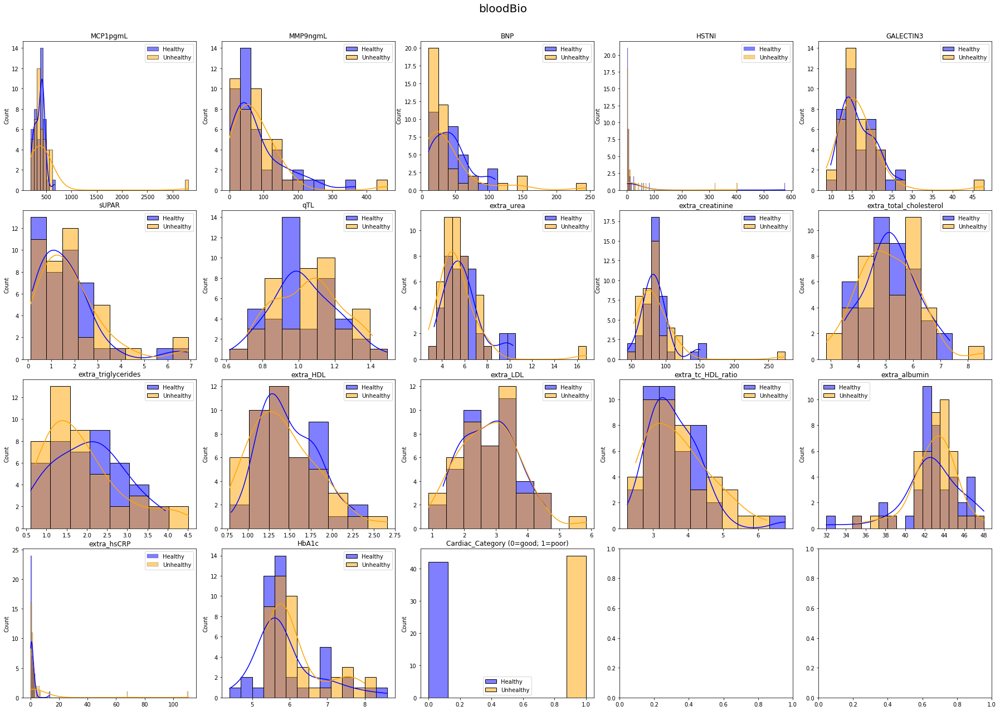

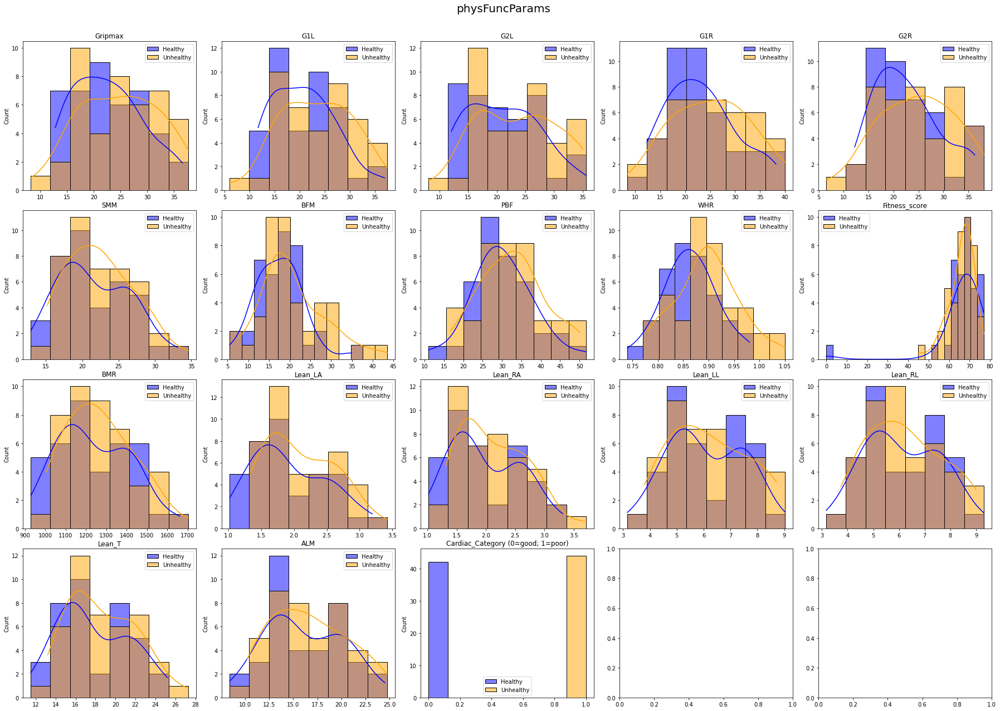

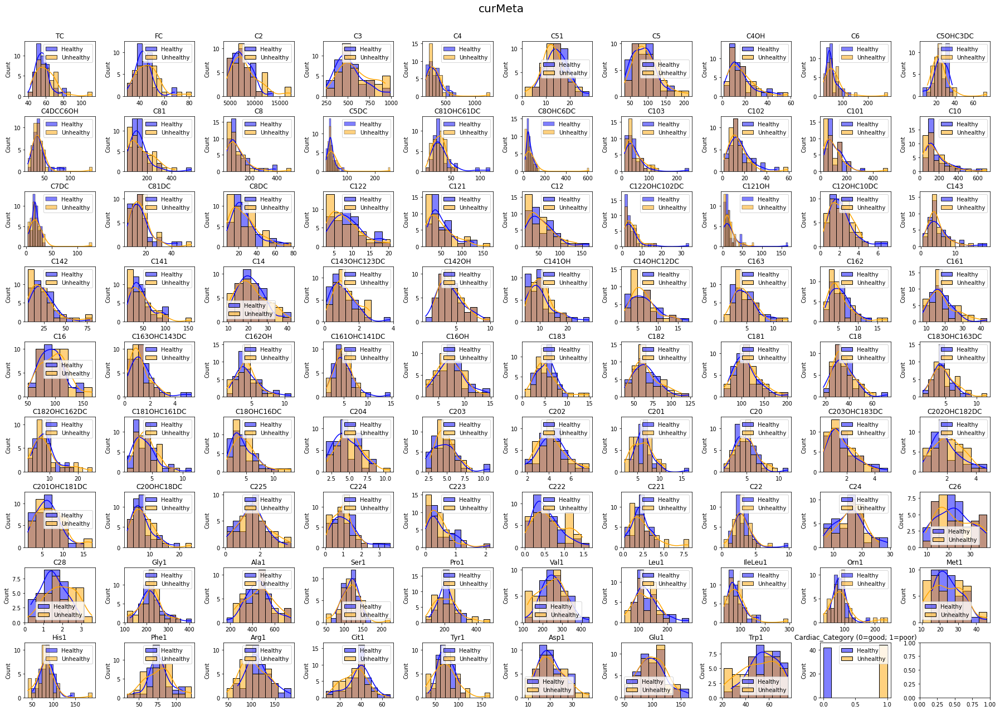

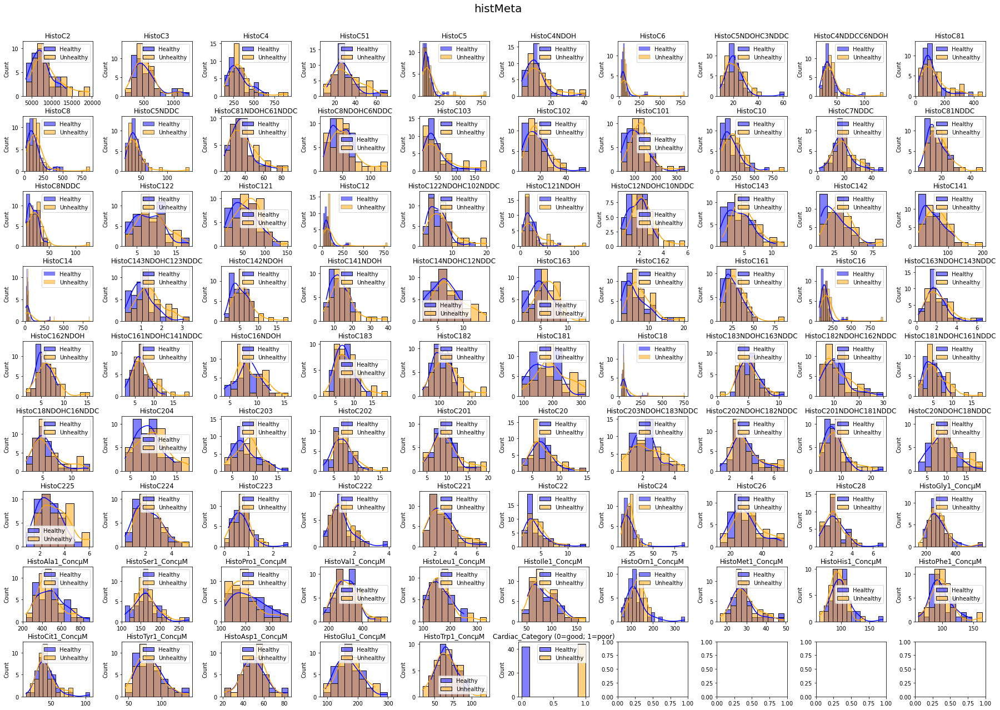

In [6]:
#print(15//6 + 1)
for key in cc_dfDict:

    mainDf = preprocessDf(cc_dfDict[key],verbose=False)
    healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
    unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
    numberOfCols = len(mainDf.columns)
    PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

    #bins = np.histogram_bin_edges(healthyDf, bins='auto')
    width = max(mainDf.shape[1]*1.5,14)
    height = max(mainDf.shape[1],7)
    fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
    fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
    #fig.subplots_adjust(top=width)

    for idx,column in enumerate(mainDf.columns):
        #plt.figure()    
        # use bins of mainDf, dropping na values in the process         
        bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
        sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
        sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
        axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
        #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
    #plt.tight_layout()
    fig.suptitle(key,fontsize=20, ha='center', va ='center')
    fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
    plt.show()
    

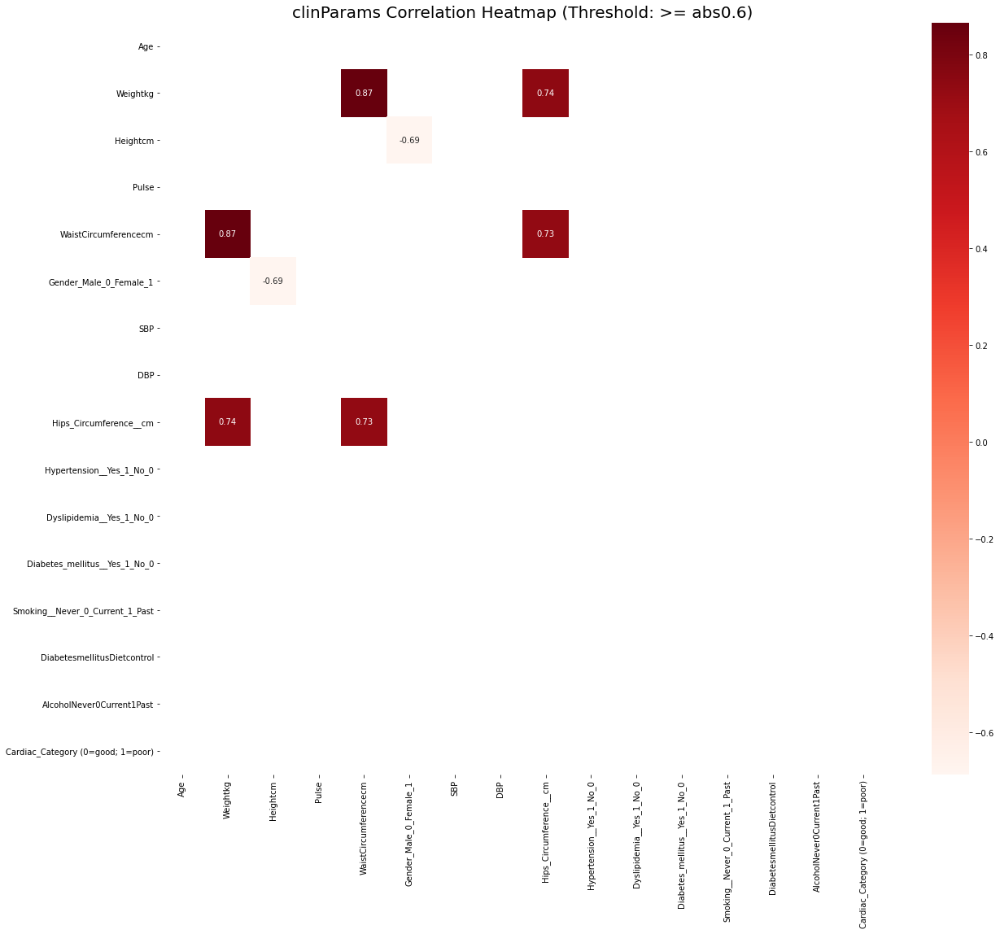

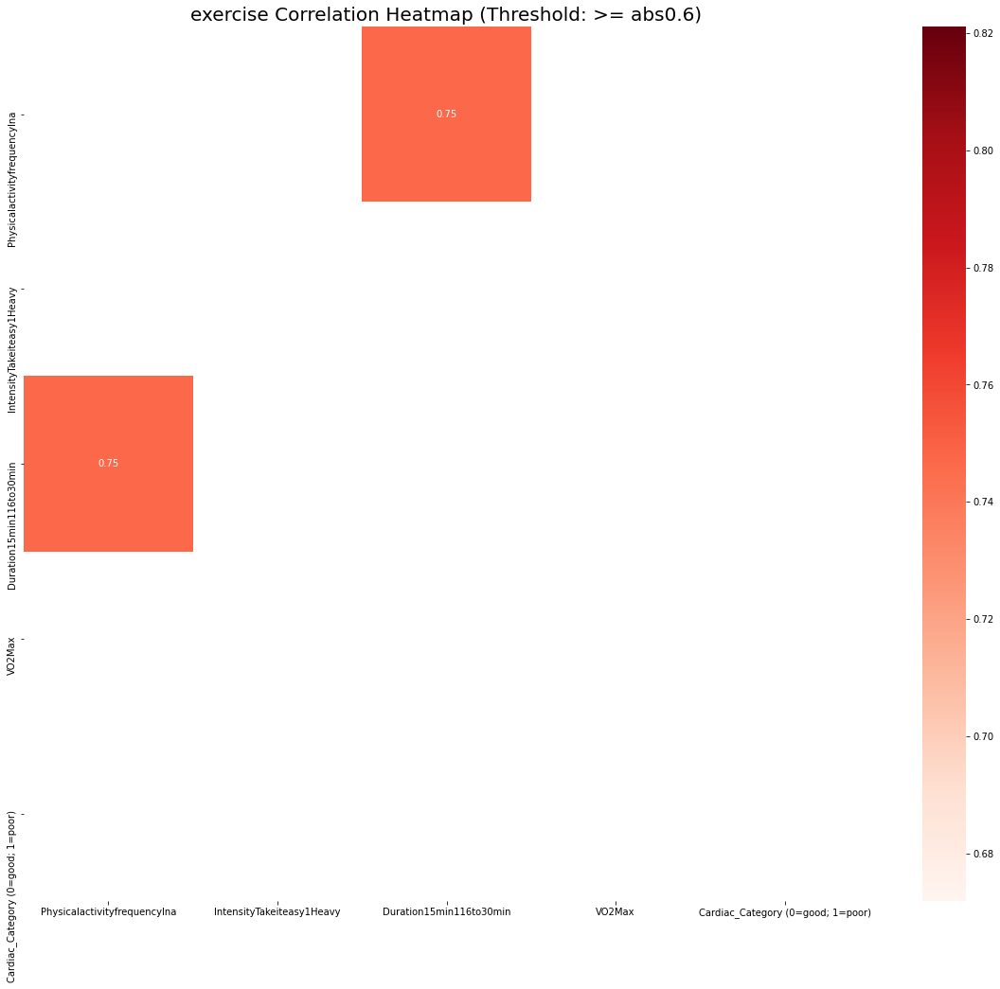

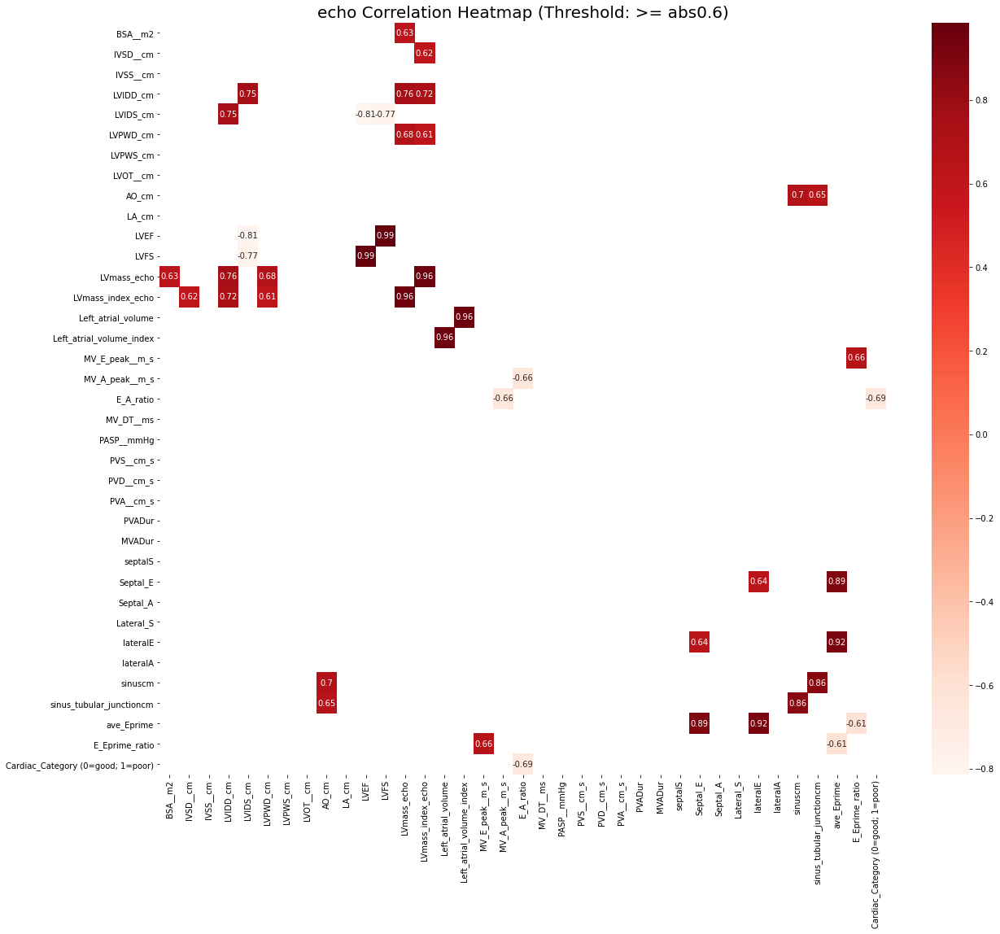

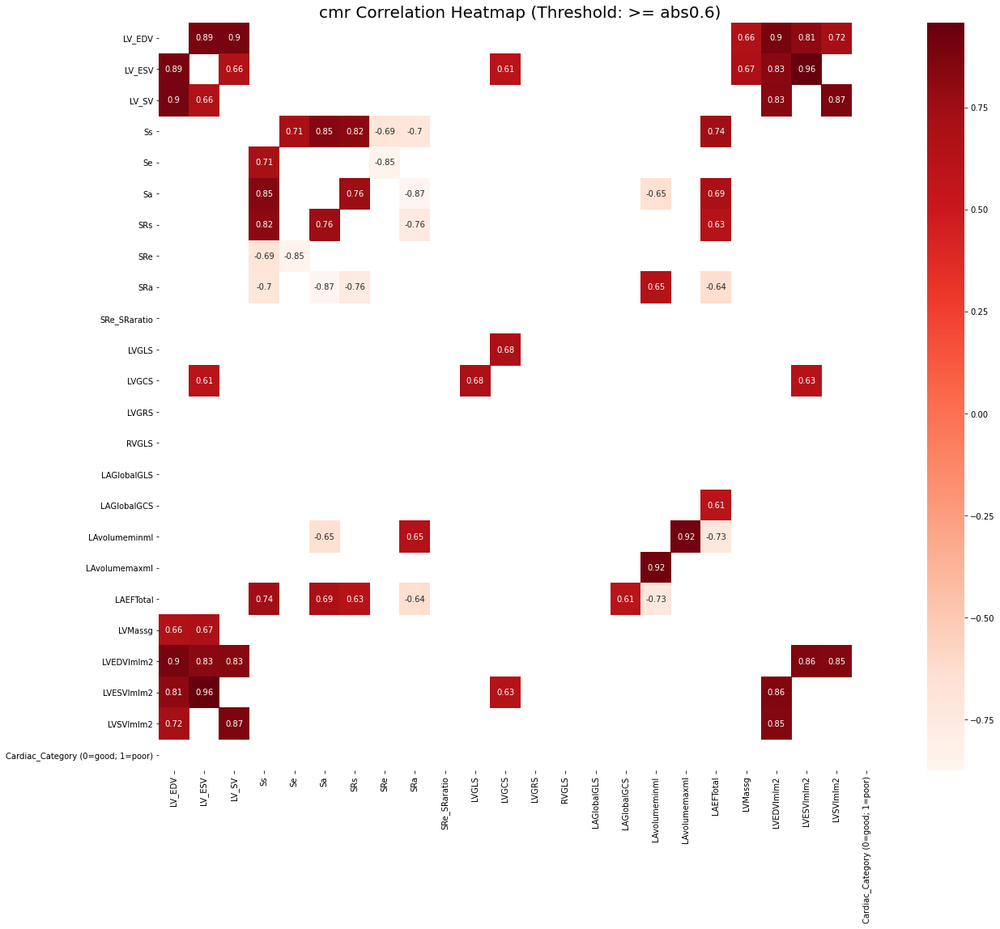

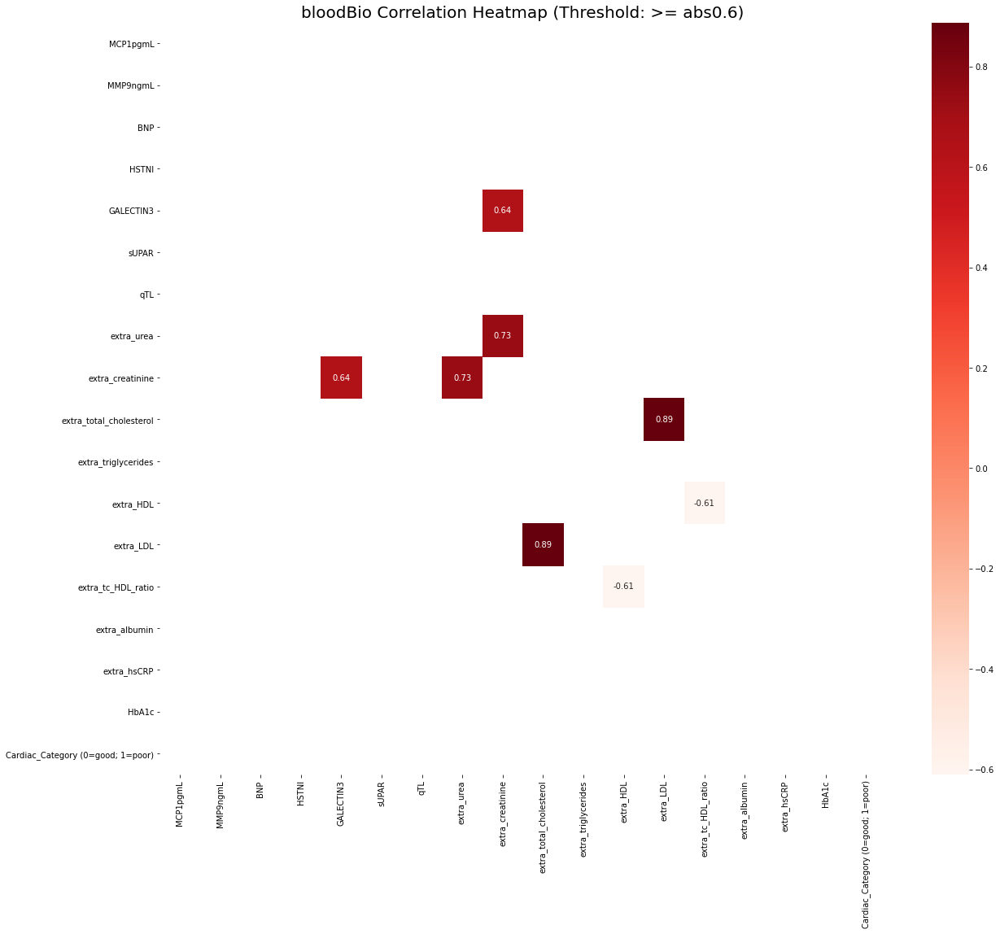

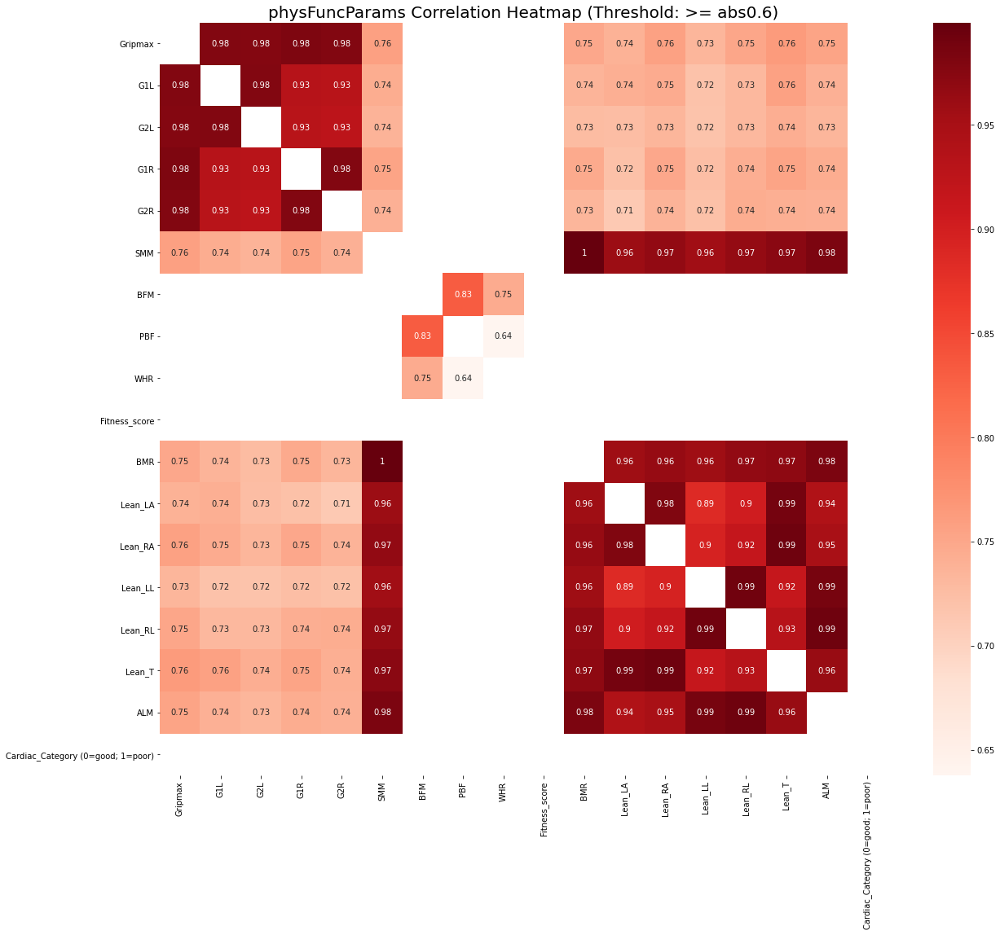

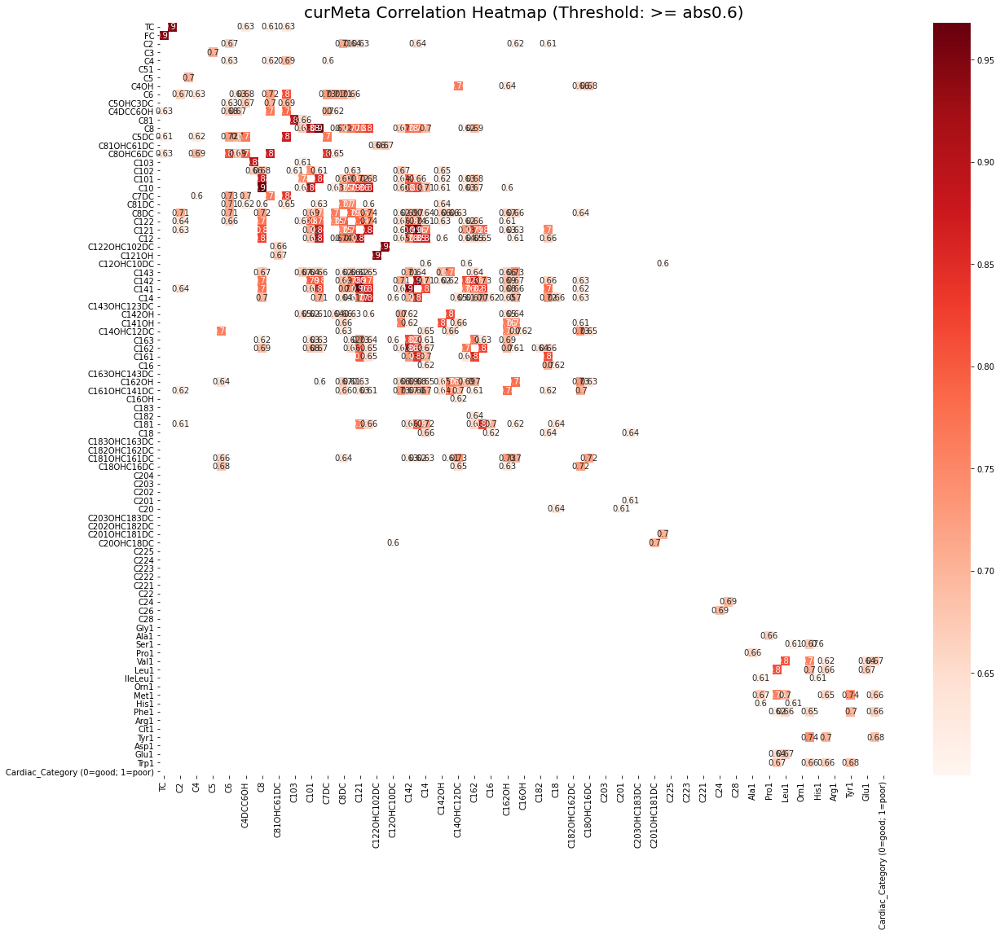

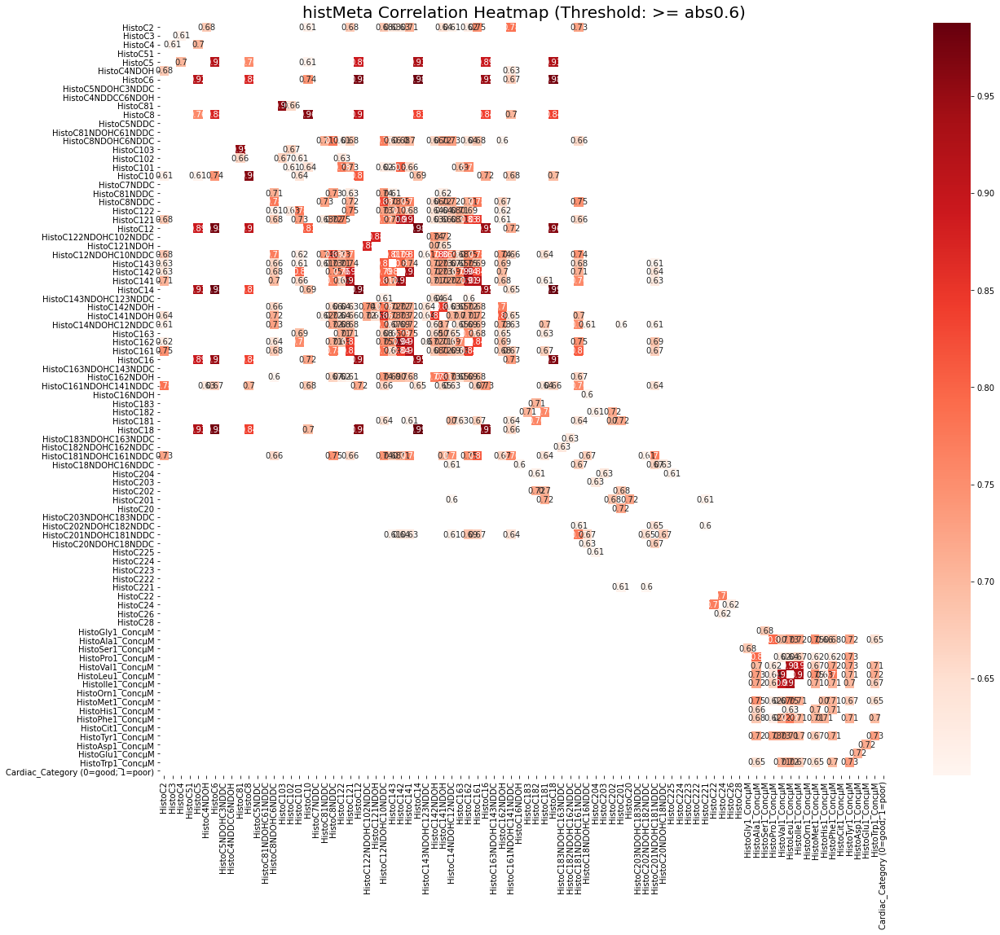

In [7]:
# Cell 5
# Churn out batches of correlation figures and tables
# Might be abit slow

for key in cc_dfDict:
    #print(f"Working on {key}")
    outputCorrData(cc_dfDict[key],filename=key,generateFiles=False)



,Gripmax,G1L,G2L,G1R,G2R,SMM,BFM,PBF,WHR,Fitness_score,BMR,Lean_LA,Lean_RA,Lean_LL,Lean_RL,Lean_T,ALM,LVEF
Gripmax,1.000000,0.978465,0.977215,0.981332,0.978025,0.758203,-0.141253,-0.509535,0.051581,-0.038496,0.750100,0.738887,0.757050,0.734841,0.751589,0.763942,0.753783,-0.153585
G1L,0.978465,1.000000,0.978355,0.933079,0.930976,0.743985,-0.113186,-0.481093,0.080991,-0.038808,0.736220,0.742243,0.745942,0.720873,0.732290,0.756467,0.739838,-0.115122
G2L,0.977215,0.978355,1.000000,0.930490,0.927135,0.738014,-0.119764,-0.488339,0.043897,-0.063748,0.728167,0.726471,0.734105,0.718348,0.731614,0.743138,0.734558,-0.147289
G1R,0.981332,0.933079,0.930490,1.000000,0.979068,0.754292,-0.165590,-0.521632,0.034949,-0.009292,0.746746,0.721659,0.750480,0.724302,0.742608,0.753810,0.743914,-0.156343
G2R,0.978025,0.930976,0.927135,0.979068,1.000000,0.739910,-0.178644,-0.526134,0.018905,-0.032729,0.733937,0.711284,0.737454,0.721981,0.743777,0.741600,0.740325,-0.184609
SMM,0.758203,0.743985,0.738014,0.754292,0.739910,1.000000,0.063827,-0.422470,0.112320,0.062785,0.999153,0.959710,0.967510,0.956647,0.966631,0.972972,0.982642,-0.220597
BFM,-0.141253,-0.113186,-0.119764,-0.165590,-0.178644,0.063827,1.000000,0.832513,0.746244,-0.350894,0.064105,0.210529,0.177713,-0.003803,0.002542,0.181930,0.054491,0.018108
PBF,-0.509535,-0.481093,-0.488339,-0.521632,-0.526134,-0.422470,0.832513,1.000000,0.637839,-0.313045,-0.423988,-0.265828,-0.295713,-0.476999,-0.471055,-0.299855,-0.429255,0.136584
WHR,0.051581,0.080991,0.043897,0.034949,0.018905,0.112320,0.746244,0.637839,1.000000,-0.377443,0.109173,0.323383,0.302505,-0.008852,0.019034,0.306681,0.095808,-0.026643
Fitness_score,-0.038496,-0.038808,-0.063748,-0.009292,-0.032729,0.062785,-0.350894,-0.313045,-0.377443,1.000000,0.059465,-0.070648,-0.053979,0.088441,0.038425,-0.051331,0.030122,0.091600


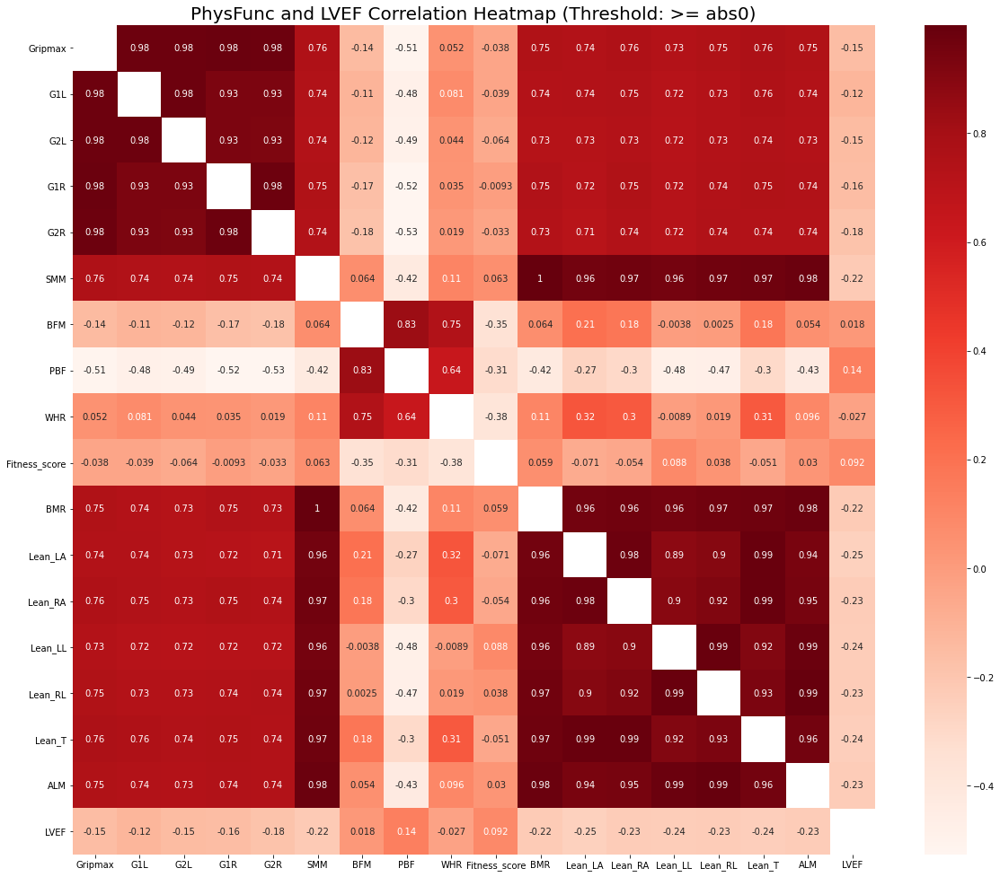

In [8]:
# Cell 6
# Output correlation data between phys func parameters and LVEF
regData1 = data[physFuncParamsCols + ["LVEF"]]
outputCorrData(regData1,threshold=0,filename="PhysFunc and LVEF")

,Gripmax,G1L,G2L,G1R,G2R,SMM,BFM,PBF,WHR,Fitness_score,BMR,Lean_LA,Lean_RA,Lean_LL,Lean_RL,Lean_T,ALM,E_A_ratio
Gripmax,1.000000,0.978465,0.977215,0.981332,0.978025,0.758203,-0.141253,-0.509535,0.051581,-0.038496,0.750100,0.738887,0.757050,0.734841,0.751589,0.763942,0.753783,0.003463
G1L,0.978465,1.000000,0.978355,0.933079,0.930976,0.743985,-0.113186,-0.481093,0.080991,-0.038808,0.736220,0.742243,0.745942,0.720873,0.732290,0.756467,0.739838,-0.030138
G2L,0.977215,0.978355,1.000000,0.930490,0.927135,0.738014,-0.119764,-0.488339,0.043897,-0.063748,0.728167,0.726471,0.734105,0.718348,0.731614,0.743138,0.734558,-0.013362
G1R,0.981332,0.933079,0.930490,1.000000,0.979068,0.754292,-0.165590,-0.521632,0.034949,-0.009292,0.746746,0.721659,0.750480,0.724302,0.742608,0.753810,0.743914,0.026848
G2R,0.978025,0.930976,0.927135,0.979068,1.000000,0.739910,-0.178644,-0.526134,0.018905,-0.032729,0.733937,0.711284,0.737454,0.721981,0.743777,0.741600,0.740325,0.017177
SMM,0.758203,0.743985,0.738014,0.754292,0.739910,1.000000,0.063827,-0.422470,0.112320,0.062785,0.999153,0.959710,0.967510,0.956647,0.966631,0.972972,0.982642,-0.035518
BFM,-0.141253,-0.113186,-0.119764,-0.165590,-0.178644,0.063827,1.000000,0.832513,0.746244,-0.350894,0.064105,0.210529,0.177713,-0.003803,0.002542,0.181930,0.054491,-0.298354
PBF,-0.509535,-0.481093,-0.488339,-0.521632,-0.526134,-0.422470,0.832513,1.000000,0.637839,-0.313045,-0.423988,-0.265828,-0.295713,-0.476999,-0.471055,-0.299855,-0.429255,-0.260349
WHR,0.051581,0.080991,0.043897,0.034949,0.018905,0.112320,0.746244,0.637839,1.000000,-0.377443,0.109173,0.323383,0.302505,-0.008852,0.019034,0.306681,0.095808,-0.377930
Fitness_score,-0.038496,-0.038808,-0.063748,-0.009292,-0.032729,0.062785,-0.350894,-0.313045,-0.377443,1.000000,0.059465,-0.070648,-0.053979,0.088441,0.038425,-0.051331,0.030122,0.108244


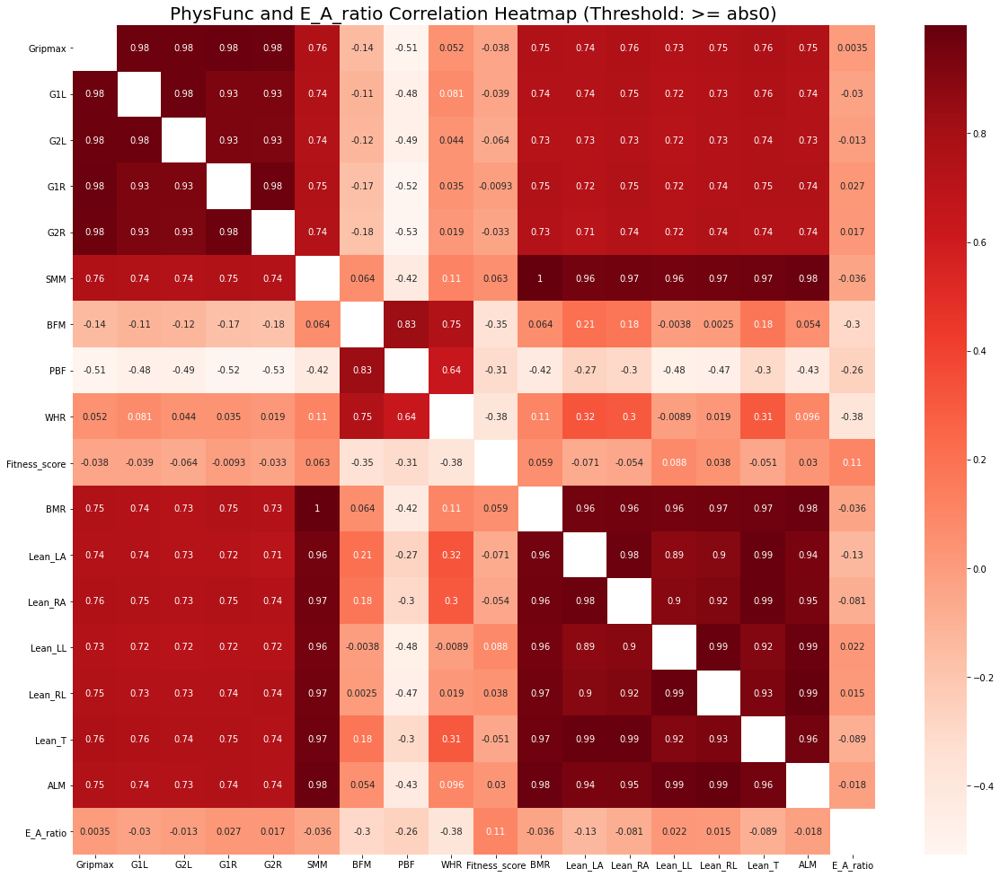

In [9]:
# Cell 7
# Output correlation data between phys func parameters and E_A_Ratio
regData2 = data[physFuncParamsCols + ["E_A_ratio"]]
outputCorrData(regData2,threshold=0,filename="PhysFunc and E_A_ratio")

Comparing models for Model comparison for clinParams, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Gender column contains only 2 values. Converting to binary
Male
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Series([], dtype: int64)
Original Shape:(86, 15)
Final Shape:(86, 15)
______________________________
Initialising models...
  feature_names  feature_importance
3         Pulse            0.329865
6           SBP            0.149405
7           DBP            0.138889
1      Weightkg            0.107143
2      Heightcm            0.063240


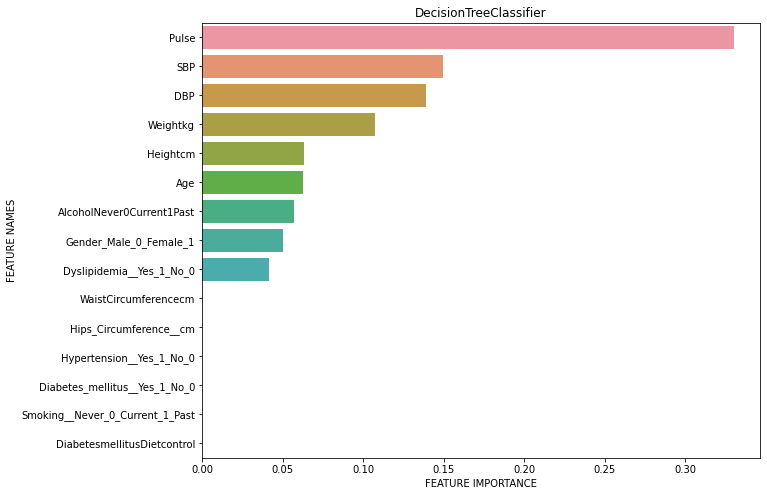

            feature_names  feature_importance
3                   Pulse            0.139384
1                Weightkg            0.111147
4    WaistCircumferencecm            0.110564
8  Hips_Circumference__cm            0.108912
7                     DBP            0.099596


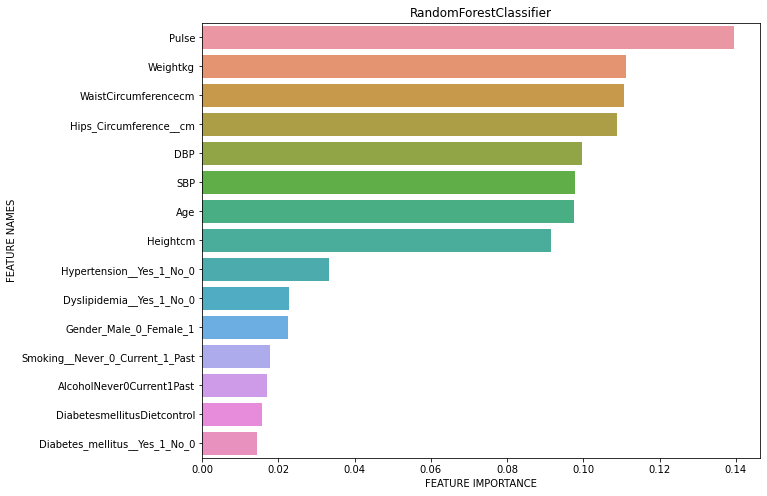

          feature_names  feature_importance
3                 Pulse            0.411226
1              Weightkg            0.112121
4  WaistCircumferencecm            0.103377
0                   Age            0.101369
6                   SBP            0.073694


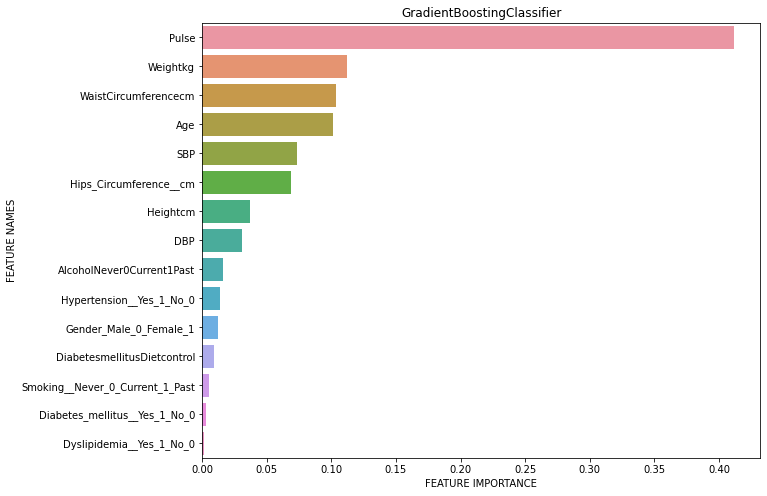

                  feature_names  feature_importance
13  DiabetesmellitusDietcontrol            0.261251
8        Hips_Circumference__cm            0.131051
5        Gender_Male_0_Female_1            0.114081
1                      Weightkg            0.104482
3                         Pulse            0.101873


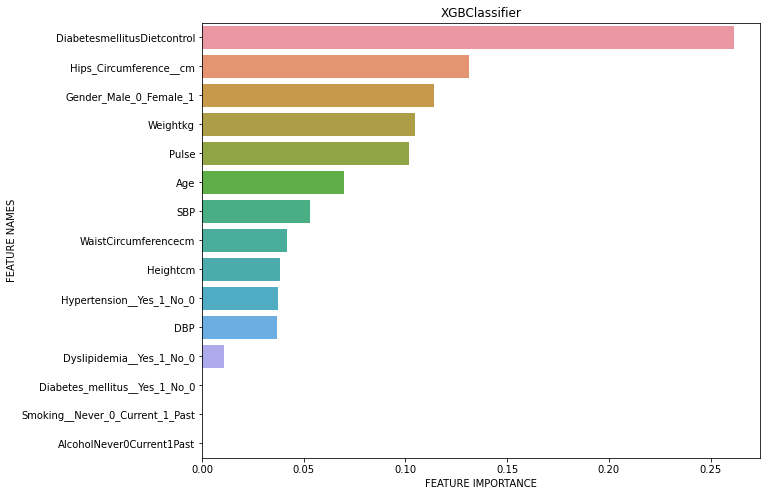

              feature_names  feature_importance
3                     Pulse                  48
0                       Age                  23
4      WaistCircumferencecm                  18
9  Hypertension__Yes_1_No_0                  17
2                  Heightcm                  15


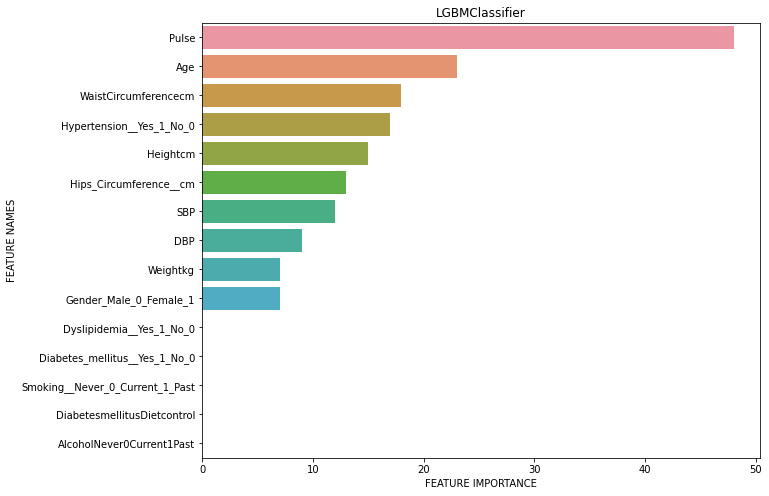

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.681818        0.637255      0.653457   
0                  GaussianNB       0.409091        0.555948      0.601574   
0        KNeighborsClassifier       0.636364        0.529935      0.524120   
0      DecisionTreeClassifier       0.454545        0.489608      0.489444   
0      RandomForestClassifier       0.454545        0.522092      0.524475   
0  GradientBoostingClassifier       0.318182        0.497778      0.502253   
0               XGBClassifier       0.590909        0.507712      0.510957   
0              LGBMClassifier       0.363636        0.510261      0.555540   
0                         SVC       0.590909        0.514118      0.639907   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.635000              0.653033       0.635031  
0           0.447500              0.583574       0.493635  
0           0.490556              0.546

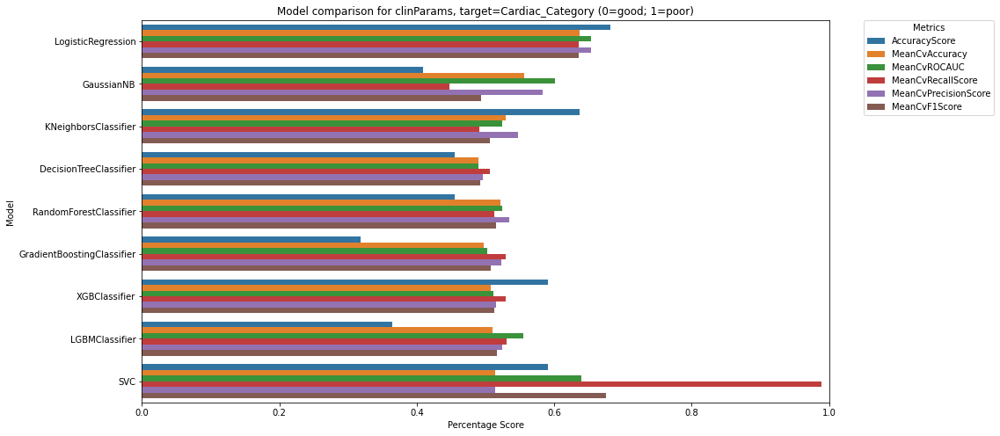

***********************************************
Comparing models for Model comparison for exercise, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Series([], dtype: int64)
Original Shape:(86, 4)
Final Shape:(86, 4)
______________________________
Initialising models...
                  feature_names  feature_importance
3                        VO2Max            0.519911
2       Duration15min116to30min            0.213307
0  PhysicalactivityfrequencyIna            0.174787
1     IntensityTakeiteasy1Heavy            0.091995


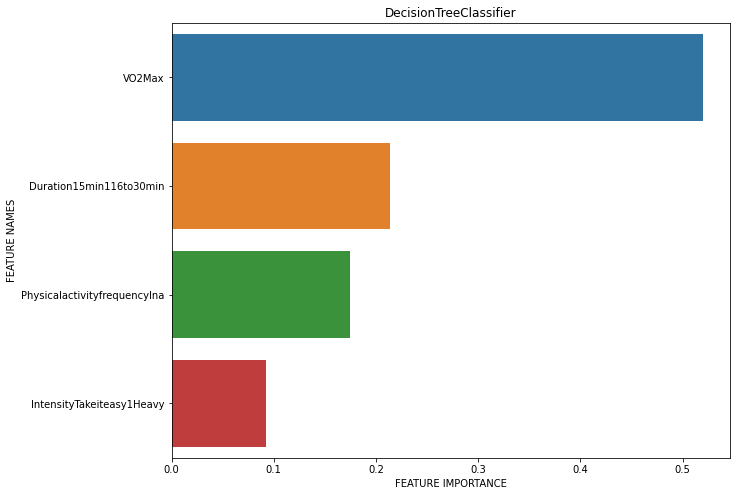

                  feature_names  feature_importance
3                        VO2Max            0.634643
2       Duration15min116to30min            0.159883
0  PhysicalactivityfrequencyIna            0.146647
1     IntensityTakeiteasy1Heavy            0.058827


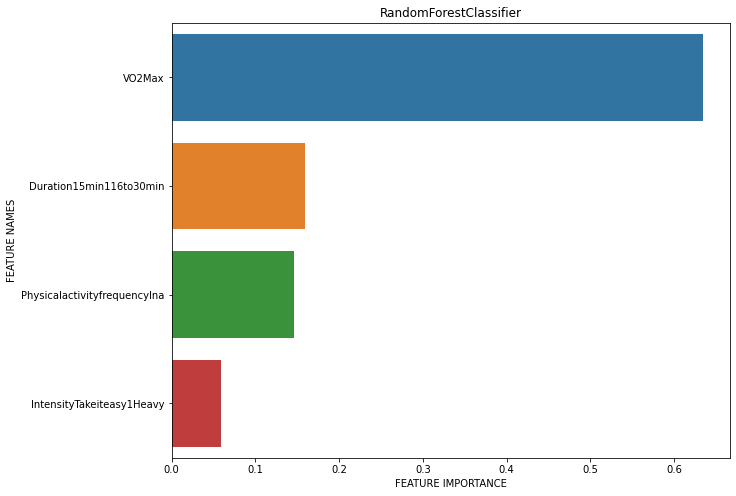

                  feature_names  feature_importance
3                        VO2Max            0.615259
0  PhysicalactivityfrequencyIna            0.168612
2       Duration15min116to30min            0.162350
1     IntensityTakeiteasy1Heavy            0.053779


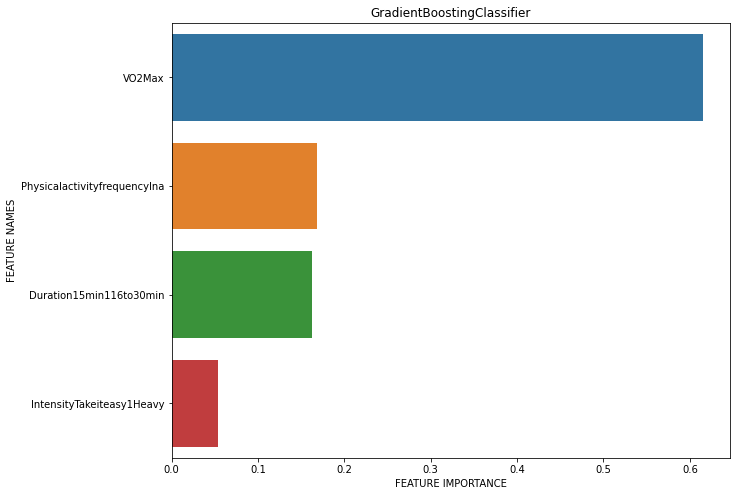

                  feature_names  feature_importance
1     IntensityTakeiteasy1Heavy            0.332447
3                        VO2Max            0.319546
0  PhysicalactivityfrequencyIna            0.191701
2       Duration15min116to30min            0.156306


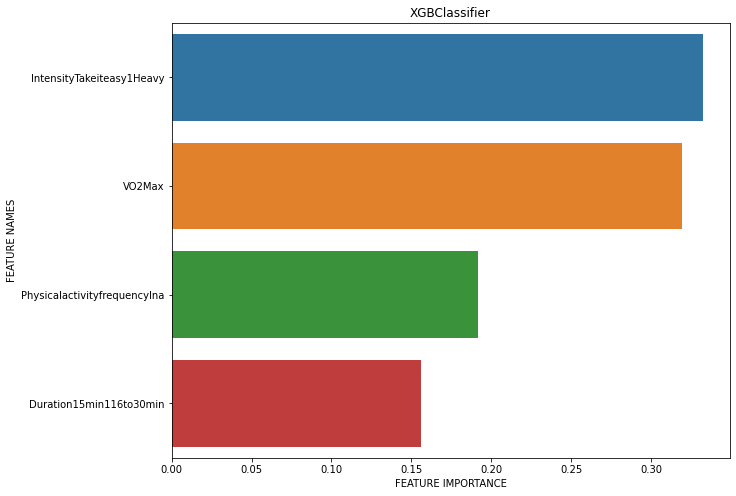

                  feature_names  feature_importance
3                        VO2Max                 102
2       Duration15min116to30min                  20
0  PhysicalactivityfrequencyIna                   0
1     IntensityTakeiteasy1Heavy                   0


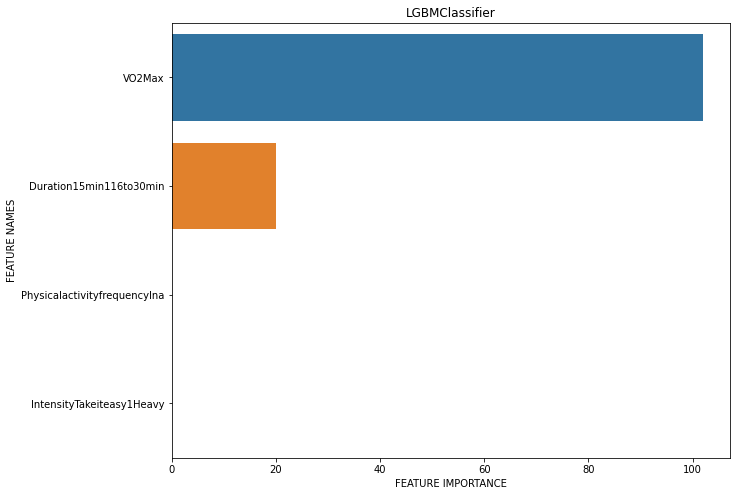

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.500000        0.554183      0.601250   
0                  GaussianNB       0.500000        0.488039      0.546682   
0        KNeighborsClassifier       0.636364        0.654052      0.631420   
0      DecisionTreeClassifier       0.590909        0.531111      0.544012   
0      RandomForestClassifier       0.681818        0.600719      0.628812   
0  GradientBoostingClassifier       0.636364        0.547386      0.585000   
0               XGBClassifier       0.636364        0.552288      0.568194   
0              LGBMClassifier       0.454545        0.499608      0.500648   
0                         SVC       0.454545        0.545033      0.624799   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.645278              0.557536       0.592715  
0           0.586111              0.497337       0.532290  
0           0.683333              0.664

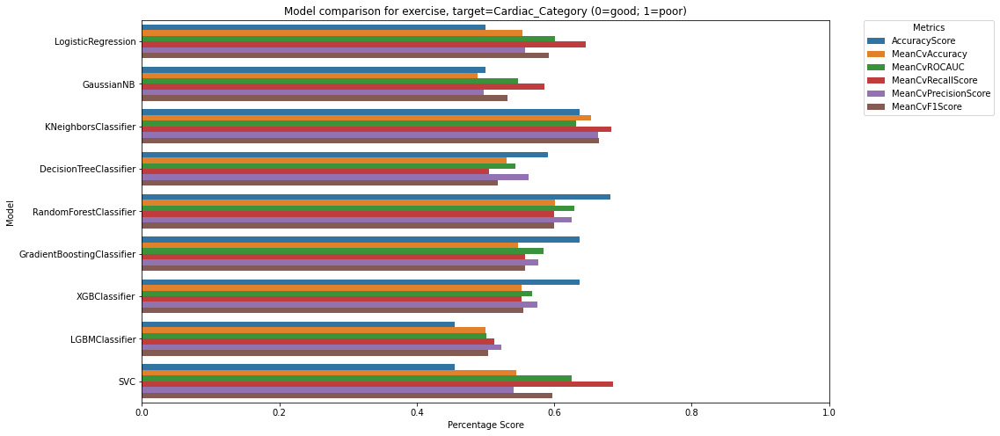

***********************************************
Comparing models for Model comparison for echo, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
PASP__mmHg                  8.14
PVS__cm_s                   2.33
PVD__cm_s                   2.33
PVA__cm_s                   2.33
PVADur                      2.33
sinuscm                     2.33
sinus_tubular_junctioncm    2.33
LVFS                        1.16
Left_atrial_volume          1.16
Left_atrial_volume_index    1.16
MV_DT__ms                   1.16
dtype: float64
Original Shape:(86, 36)
Final Shape:(86, 36)
______________________________
Initialising models...
   feature_names  feature_importance
18     E_A_ratio                 1.0
1       IVSD__cm                 0.0
20    PASP__mmHg                 0.0
21     PVS__cm_s          

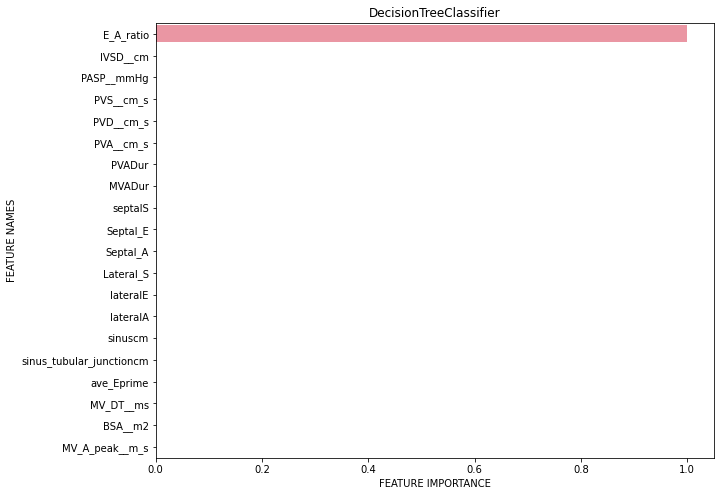

     feature_names  feature_importance
18       E_A_ratio            0.378091
16  MV_E_peak__m_s            0.089252
17  MV_A_peak__m_s            0.052386
20      PASP__mmHg            0.033502
31        lateralA            0.031151


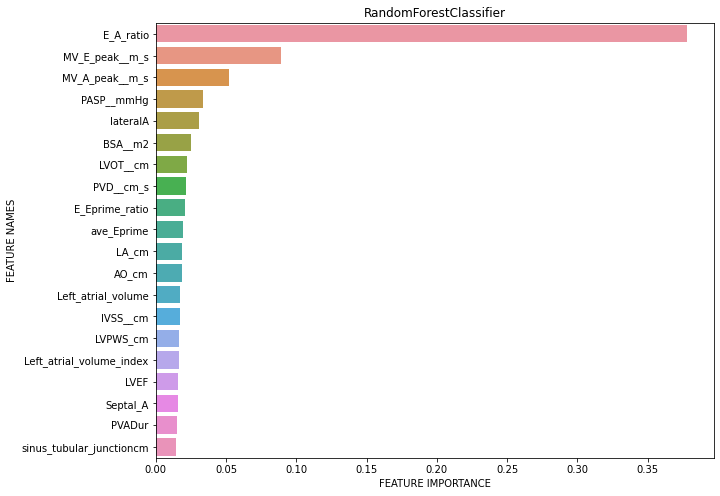

               feature_names  feature_importance
18                 E_A_ratio        1.000000e+00
34                ave_Eprime        2.277466e-16
33  sinus_tubular_junctioncm        8.341954e-17
1                   IVSD__cm        7.831557e-17
15  Left_atrial_volume_index        6.696195e-17


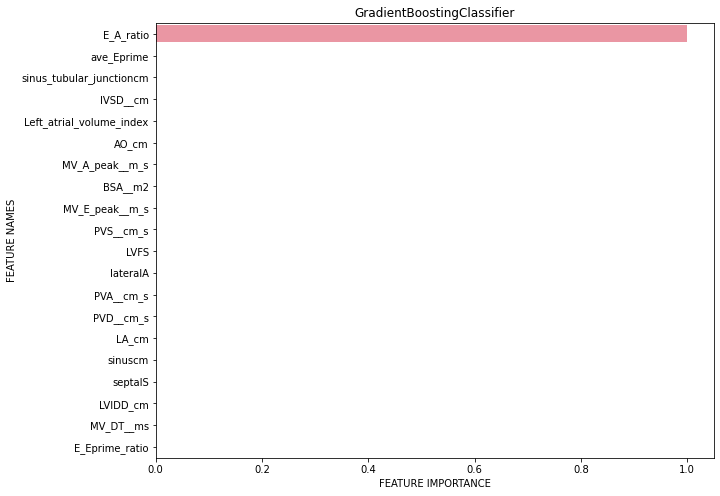

   feature_names  feature_importance
18     E_A_ratio                 1.0
1       IVSD__cm                 0.0
20    PASP__mmHg                 0.0
21     PVS__cm_s                 0.0
22     PVD__cm_s                 0.0


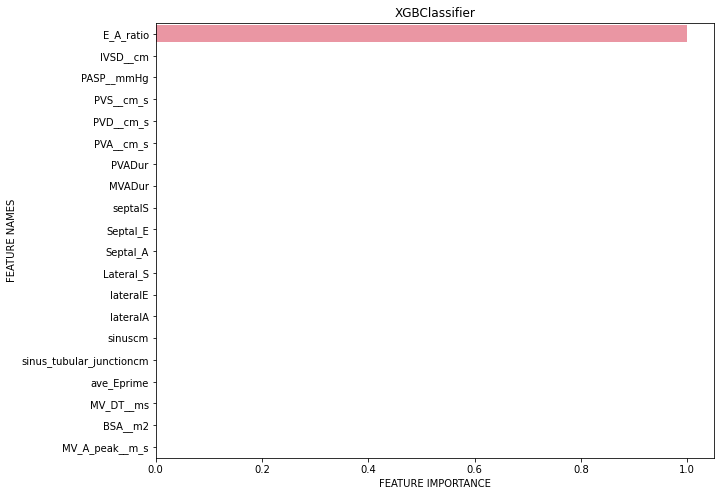

     feature_names  feature_importance
18       E_A_ratio                  62
3         LVIDD_cm                  20
17  MV_A_peak__m_s                  15
16  MV_E_peak__m_s                   9
24          PVADur                   9


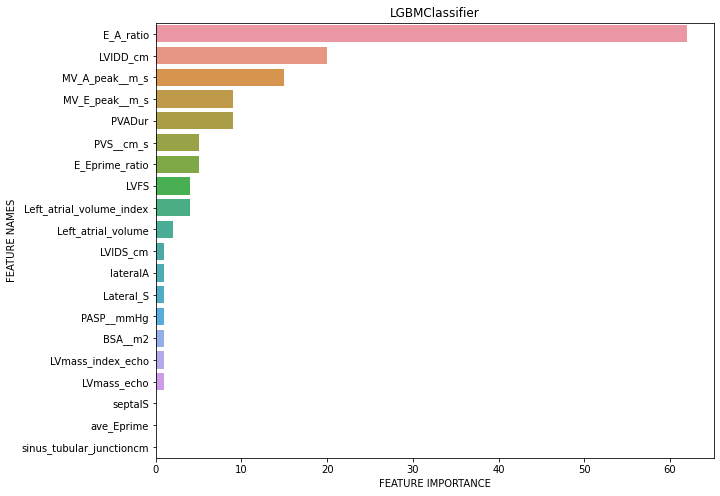

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.636364        0.581242      0.608025   
0                  GaussianNB       0.772727        0.772092      0.845185   
0        KNeighborsClassifier       0.454545        0.446536      0.403102   
0      DecisionTreeClassifier       1.000000        0.990784      0.990833   
0      RandomForestClassifier       1.000000        0.973399      0.998148   
0  GradientBoostingClassifier       1.000000        0.990784      0.991944   
0               XGBClassifier       1.000000        0.990784      0.993302   
0              LGBMClassifier       0.954545        0.983791      0.998056   
0                         SVC       0.500000        0.495752      0.504383   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.641111              0.583045       0.604425  
0           0.790833              0.782154       0.779490  
0           0.492500              0.454

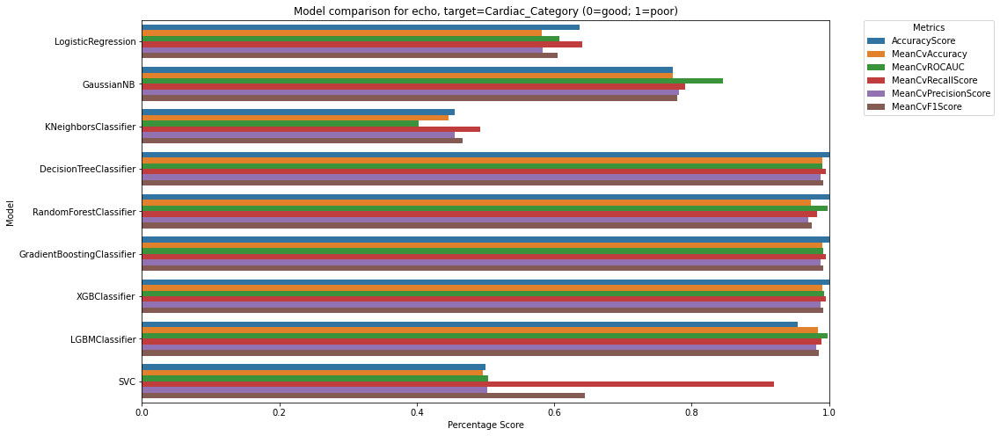

***********************************************
Comparing models for Model comparison for cmr, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  3
These columns are:
 ['LV_Mass_on_mri__g', 'LVEF_A', 'EDV067']
Columns with missing values (%):
EDV067               65.12
LVEF_A               65.12
LV_Mass_on_mri__g    43.02
LAGlobalGLS           4.65
LAGlobalGCS           4.65
LVGCS                 1.16
LVGRS                 1.16
dtype: float64
Original Shape:(86, 26)
Final Shape:(86, 23)
______________________________
Initialising models...
   feature_names  feature_importance
14   LAGlobalGLS            0.287031
19       LVMassg            0.207905
8            SRa            0.155353
1         LV_ESV            0.123397
0         LV_EDV            0.097222


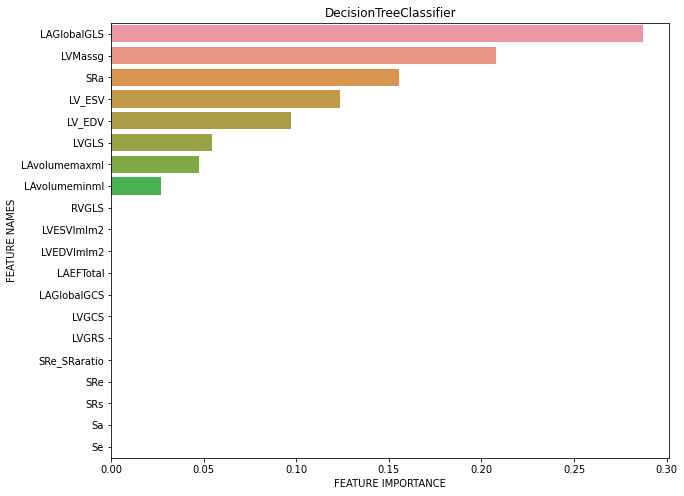

   feature_names  feature_importance
8            SRa            0.061163
18     LAEFTotal            0.057699
0         LV_EDV            0.056081
1         LV_ESV            0.053714
15   LAGlobalGCS            0.052982


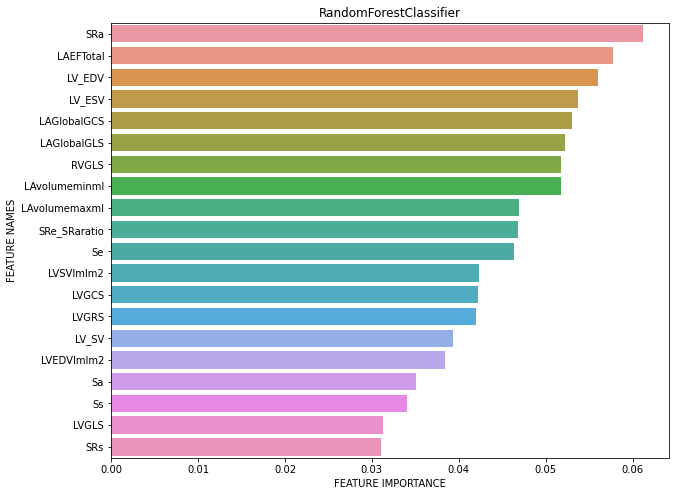

    feature_names  feature_importance
14    LAGlobalGLS            0.142471
8             SRa            0.139829
16  LAvolumeminml            0.098847
1          LV_ESV            0.095083
4              Se            0.076147


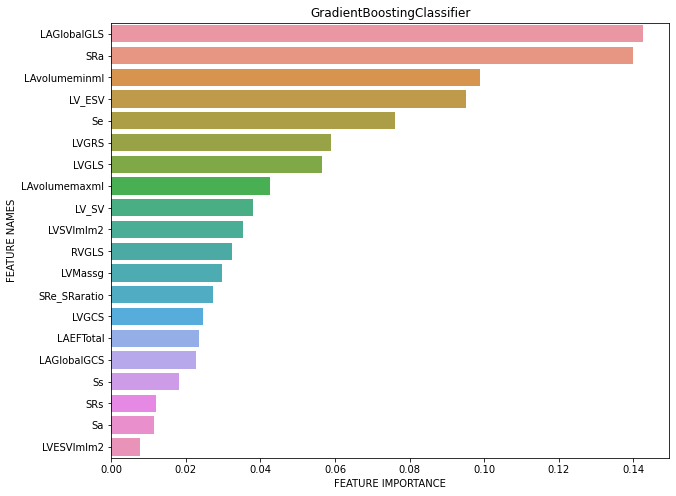

    feature_names  feature_importance
16  LAvolumeminml            0.183636
10          LVGLS            0.084593
8             SRa            0.071069
14    LAGlobalGLS            0.060167
1          LV_ESV            0.059532


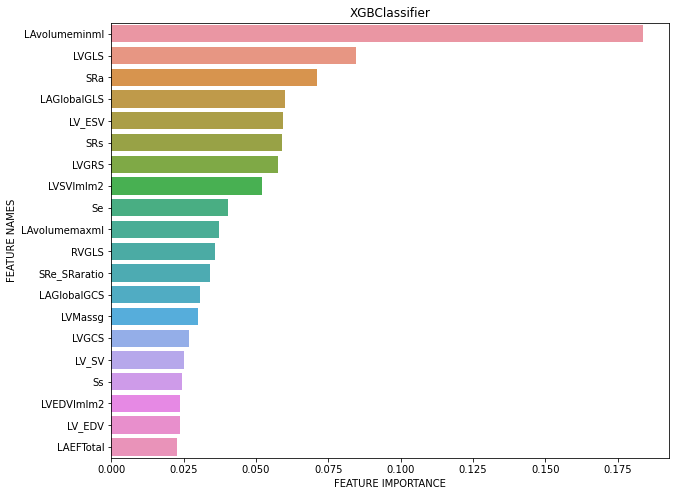

    feature_names  feature_importance
14    LAGlobalGLS                  33
17  LAvolumemaxml                  18
1          LV_ESV                  18
8             SRa                  17
19        LVMassg                  11


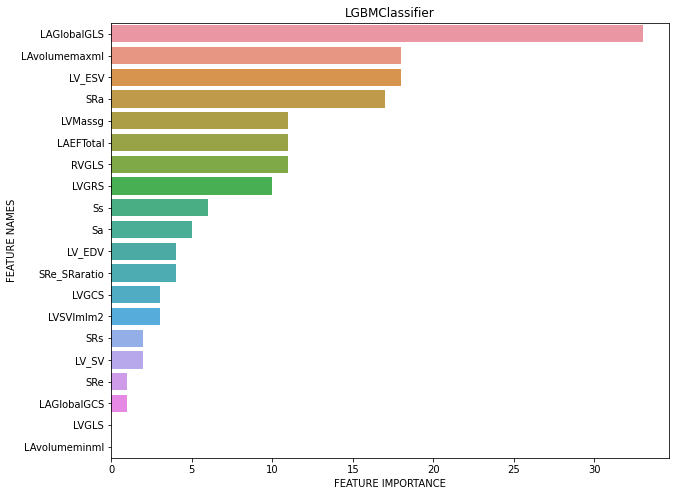

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.636364        0.561242      0.594259   
0                  GaussianNB       0.636364        0.513399      0.531296   
0        KNeighborsClassifier       0.545455        0.503595      0.522886   
0      DecisionTreeClassifier       0.727273        0.532941      0.533611   
0      RandomForestClassifier       0.681818        0.594967      0.618040   
0  GradientBoostingClassifier       0.772727        0.561307      0.572963   
0               XGBClassifier       0.681818        0.567974      0.606698   
0              LGBMClassifier       0.727273        0.635556      0.655154   
0                         SVC       0.636364        0.515752      0.579074   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.545278              0.579070       0.552398  
0           0.563056              0.518753       0.532606  
0           0.507778              0.518

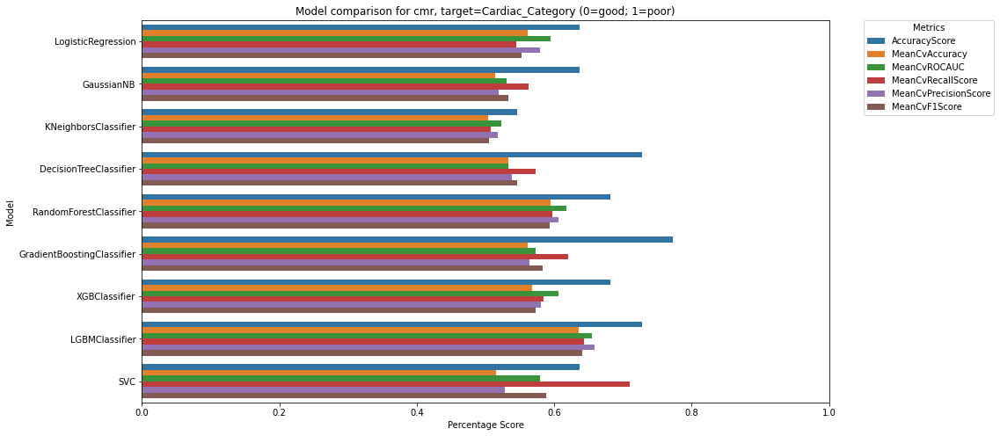

***********************************************
Comparing models for Model comparison for bloodBio, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
BNP          5.81
GALECTIN3    5.81
HSTNI        4.65
MMP9ngmL     2.33
sUPAR        1.16
qTL          1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
       feature_names  feature_importance
16             HbA1c            0.203822
8   extra_creatinine            0.180909
3              HSTNI            0.172654
6                qTL            0.155924
4          GALECTIN3            0.103535


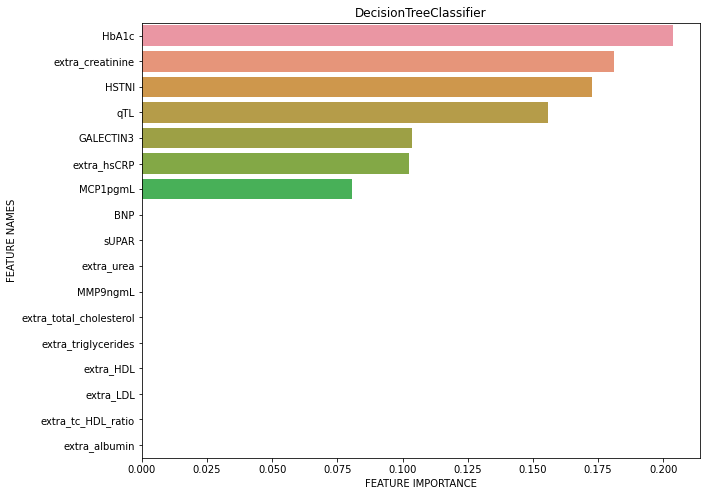

          feature_names  feature_importance
6                   qTL            0.090735
2                   BNP            0.085267
15          extra_hsCRP            0.078006
5                 sUPAR            0.064936
10  extra_triglycerides            0.064637


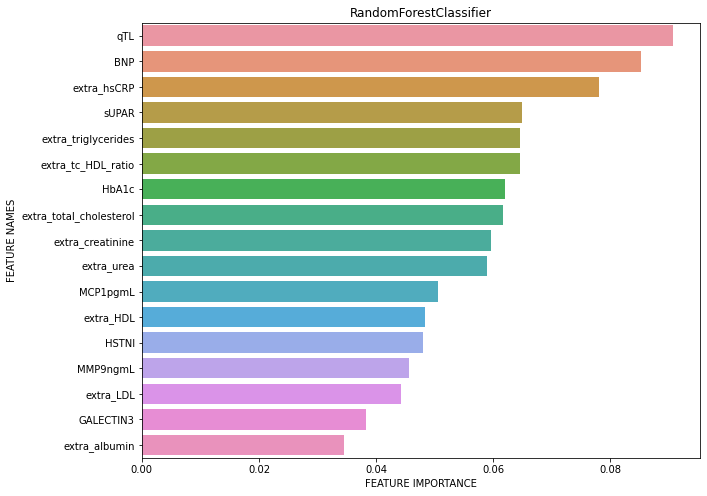

       feature_names  feature_importance
6                qTL            0.147954
15       extra_hsCRP            0.135849
16             HbA1c            0.112346
8   extra_creatinine            0.091617
2                BNP            0.086342


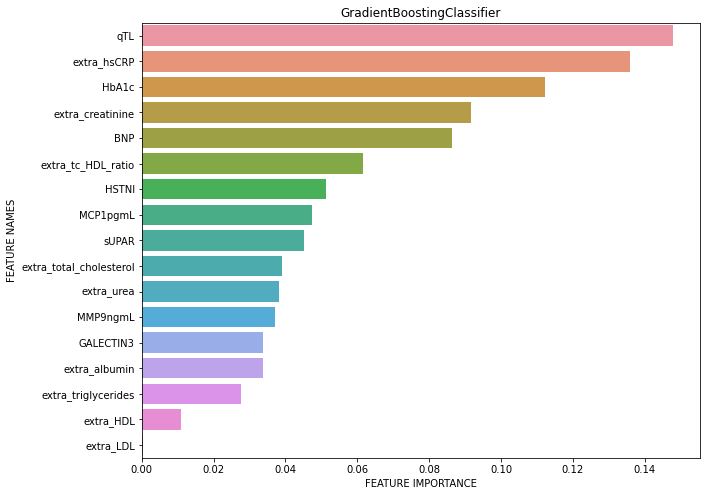

             feature_names  feature_importance
2                      BNP            0.144015
3                    HSTNI            0.132369
0                 MCP1pgmL            0.105214
9  extra_total_cholesterol            0.086159
6                      qTL            0.085827


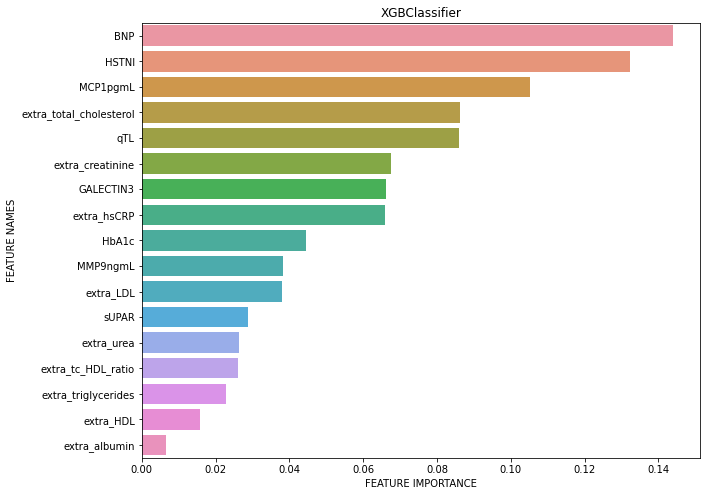

         feature_names  feature_importance
6                  qTL                  30
15         extra_hsCRP                  22
8     extra_creatinine                  17
13  extra_tc_HDL_ratio                  16
2                  BNP                  11


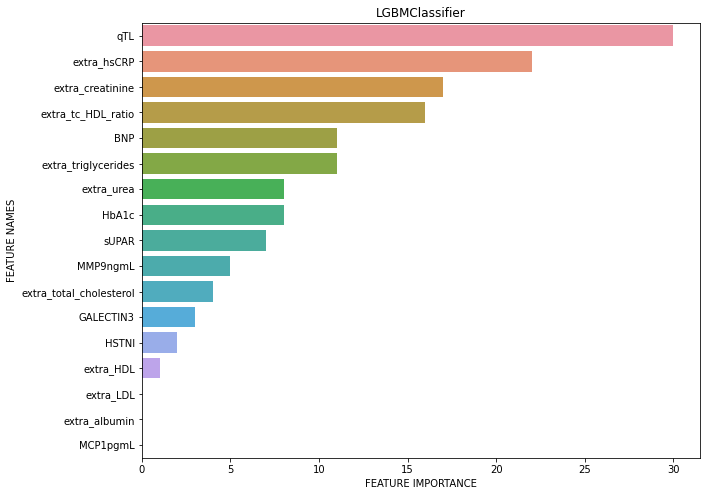

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.727273        0.532418      0.547438   
0                  GaussianNB       0.545455        0.456797      0.448148   
0        KNeighborsClassifier       0.545455        0.536405      0.565571   
0      DecisionTreeClassifier       0.500000        0.513791      0.514306   
0      RandomForestClassifier       0.545455        0.526078      0.535463   
0  GradientBoostingClassifier       0.409091        0.509739      0.516296   
0               XGBClassifier       0.363636        0.519281      0.537346   
0              LGBMClassifier       0.681818        0.535163      0.572469   
0                         SVC       0.590909        0.455033      0.422531   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.531667              0.552342       0.530648  
0           0.124444              0.386524       0.181572  
0           0.488056              0.559

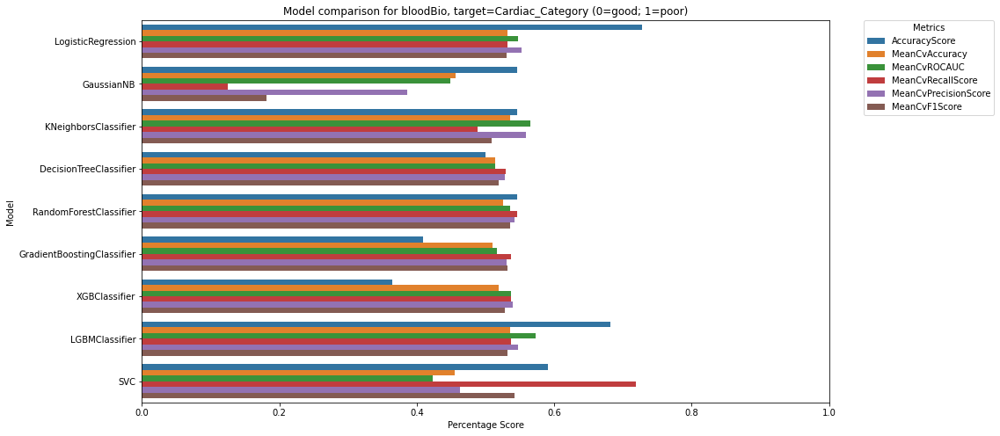

***********************************************
Comparing models for Model comparison for physFuncParams, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Fitness_score    6.98
WHR              5.81
Lean_T           5.81
Lean_RL          5.81
Lean_LL          5.81
Lean_RA          5.81
Lean_LA          5.81
BMR              5.81
ALM              5.81
PBF              5.81
BFM              5.81
SMM              5.81
G1L              1.16
G2R              1.16
G1R              1.16
G2L              1.16
Gripmax          1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
   feature_names  feature_importance
8            WHR            0.211258
1            G1L            0.147699
5            SMM            0.107143
11   

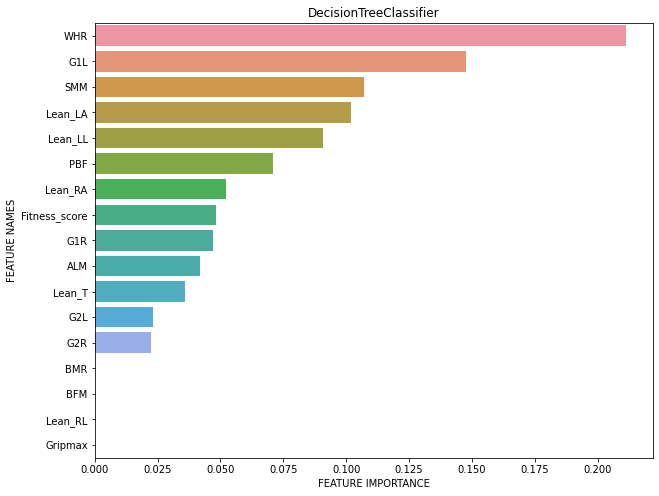

   feature_names  feature_importance
8            WHR            0.092530
12       Lean_RA            0.083752
6            BFM            0.073017
4            G2R            0.071952
0        Gripmax            0.069096


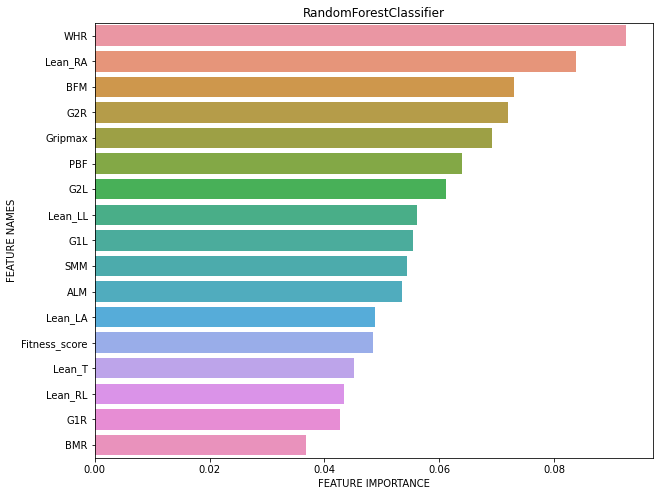

   feature_names  feature_importance
8            WHR            0.160082
12       Lean_RA            0.133003
0        Gripmax            0.103255
16           ALM            0.085642
4            G2R            0.074117


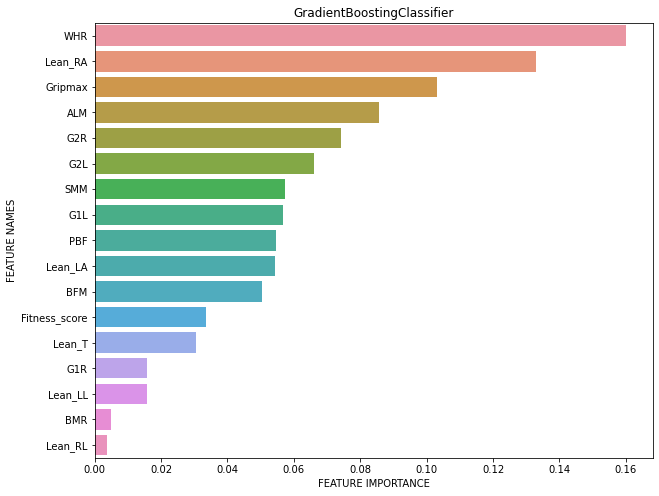

   feature_names  feature_importance
8            WHR            0.108705
12       Lean_RA            0.084892
13       Lean_LL            0.083738
2            G2L            0.077779
4            G2R            0.070988


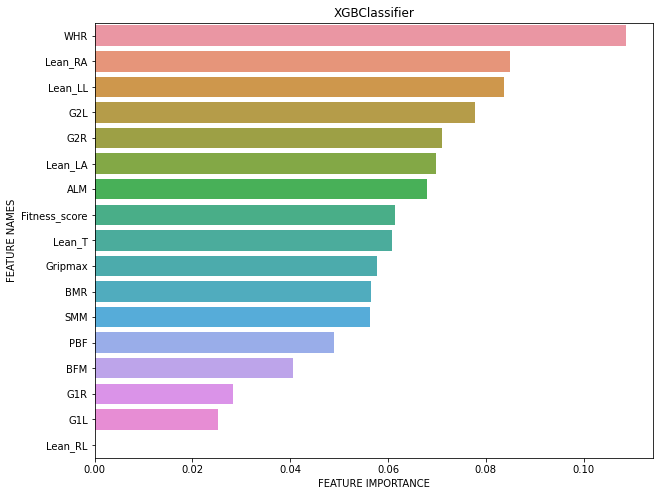

   feature_names  feature_importance
8            WHR                  21
12       Lean_RA                  18
6            BFM                  15
7            PBF                  14
4            G2R                  13


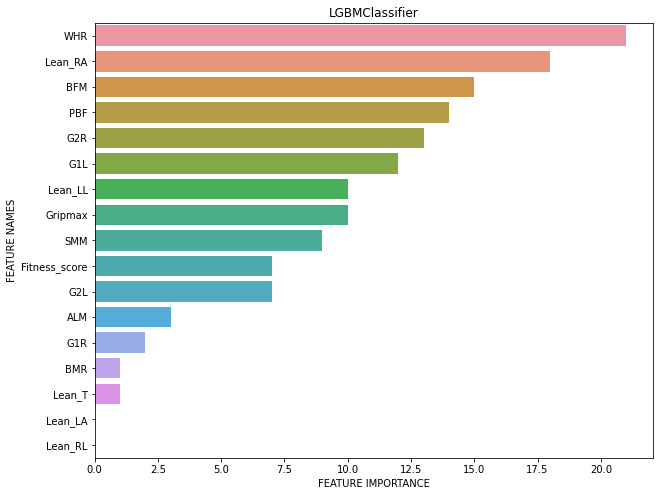

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.681818        0.551242      0.574228   
0                  GaussianNB       0.409091        0.556797      0.581543   
0        KNeighborsClassifier       0.409091        0.504444      0.499892   
0      DecisionTreeClassifier       0.545455        0.444052      0.442500   
0      RandomForestClassifier       0.363636        0.494444      0.472114   
0  GradientBoostingClassifier       0.500000        0.480065      0.463858   
0               XGBClassifier       0.363636        0.470784      0.459630   
0              LGBMClassifier       0.636364        0.521242      0.521667   
0                         SVC       0.363636        0.514118      0.519043   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.565556              0.561126       0.554218  
0           0.549167              0.567177       0.552935  
0           0.540556              0.520

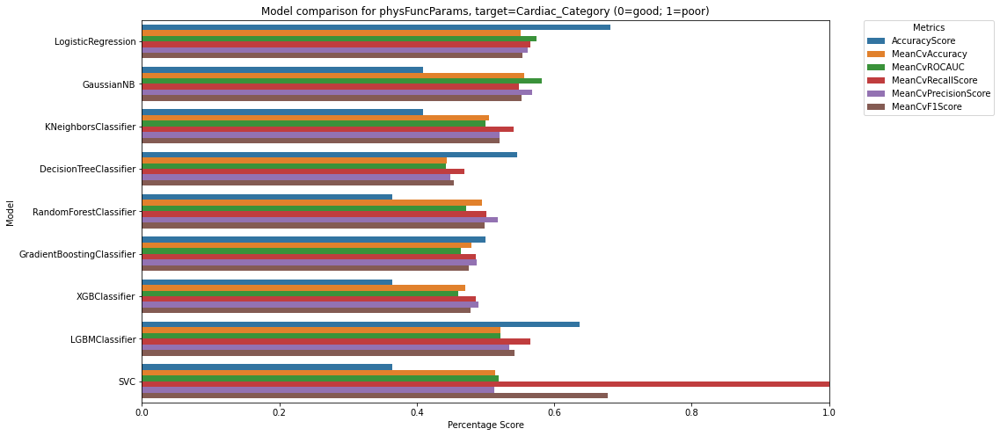

***********************************************
Comparing models for Model comparison for curMeta, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C24             13.95
C26             13.95
C28             13.95
Leu1            13.95
C102             6.98
C203OHC183DC     3.49
C183             2.33
C51              1.16
C101             1.16
C143OHC123DC     1.16
C163OHC143DC     1.16
C202OHC182DC     1.16
C225             1.16
C223             1.16
C222             1.16
dtype: float64
Original Shape:(86, 88)
Final Shape:(86, 88)
______________________________
Initialising models...
   feature_names  feature_importance
83          Cit1            0.166502
39          C161            0.125000
74          Pro1            0.124569
35        C141OH            0.093750
65          C222   

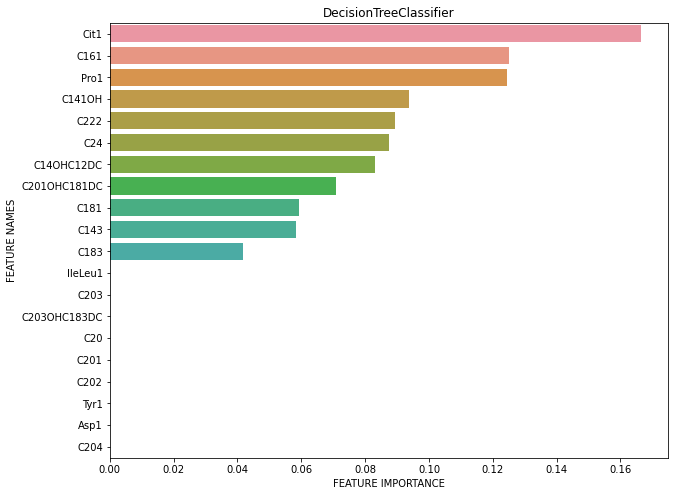

   feature_names  feature_importance
83          Cit1            0.043369
24          C121            0.027765
19           C10            0.022294
1             FC            0.021761
65          C222            0.021638


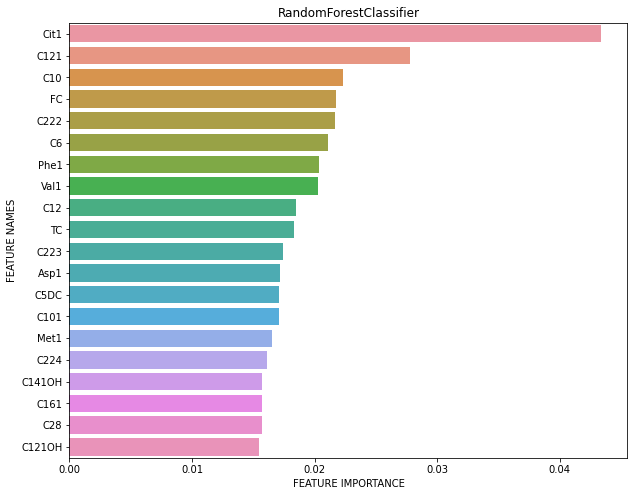

   feature_names  feature_importance
83          Cit1            0.138248
74          Pro1            0.088328
9       C5OHC3DC            0.070837
24          C121            0.052228
12            C8            0.051376


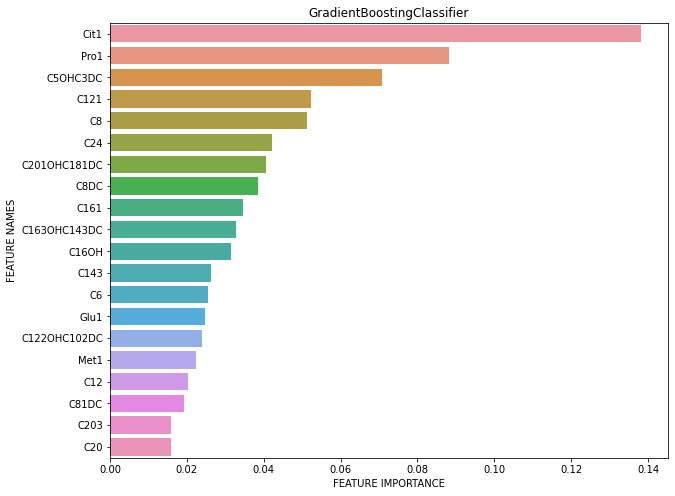

   feature_names  feature_importance
68           C24            0.086880
7           C4OH            0.070725
26  C122OHC102DC            0.057575
57           C20            0.050117
44         C16OH            0.049815


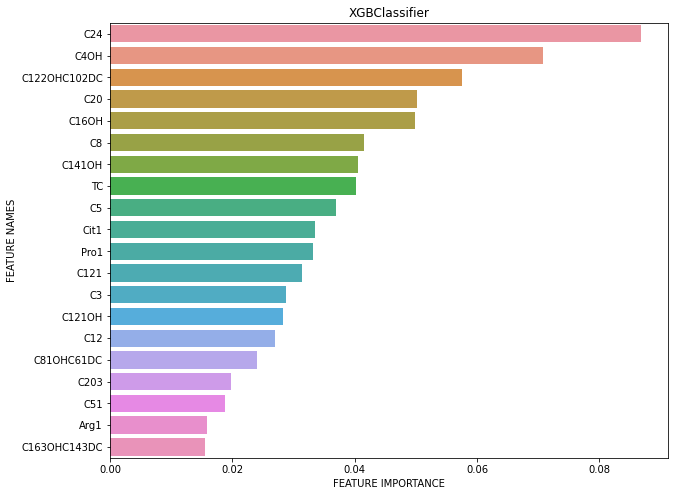

   feature_names  feature_importance
9       C5OHC3DC                  14
81          Phe1                  12
83          Cit1                  10
8             C6                  10
56          C201                   8


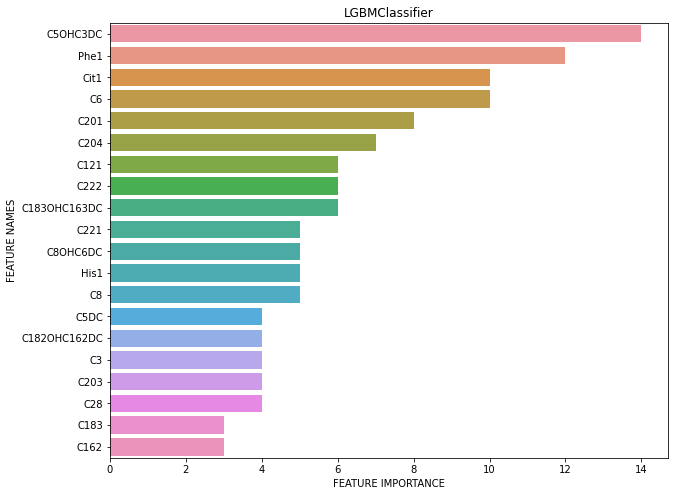

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.681818        0.497255      0.488025   
0                  GaussianNB       0.500000        0.469739      0.454954   
0        KNeighborsClassifier       0.500000        0.449673      0.475880   
0      DecisionTreeClassifier       0.318182        0.489869      0.489583   
0      RandomForestClassifier       0.545455        0.473660      0.471898   
0  GradientBoostingClassifier       0.500000        0.448889      0.410741   
0               XGBClassifier       0.545455        0.459216      0.428117   
0              LGBMClassifier       0.500000        0.452614      0.414938   
0                         SVC       0.500000        0.473333      0.503333   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.507500              0.511650       0.499285  
0           0.395278              0.480035       0.423997  
0           0.383333              0.451

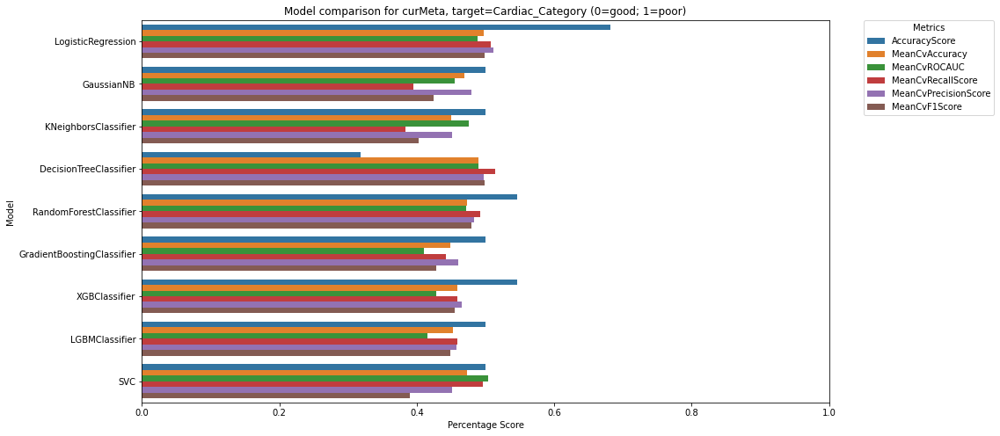

***********************************************
Comparing models for Model comparison for histMeta, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  1
These columns are:
 ['HistoCode']
Columns with missing values (%):
HistoCode    100.00
HistoC51       2.33
HistoC223      1.16
dtype: float64
Original Shape:(86, 86)
Final Shape:(86, 85)
______________________________
Initialising models...
            feature_names  feature_importance
36              HistoC162            0.222727
57  HistoC202NDOHC182NDDC            0.166667
40          HistoC162NDOH            0.159028
45              HistoC181            0.148897
72       HistoPro1_ConcµM            0.108333


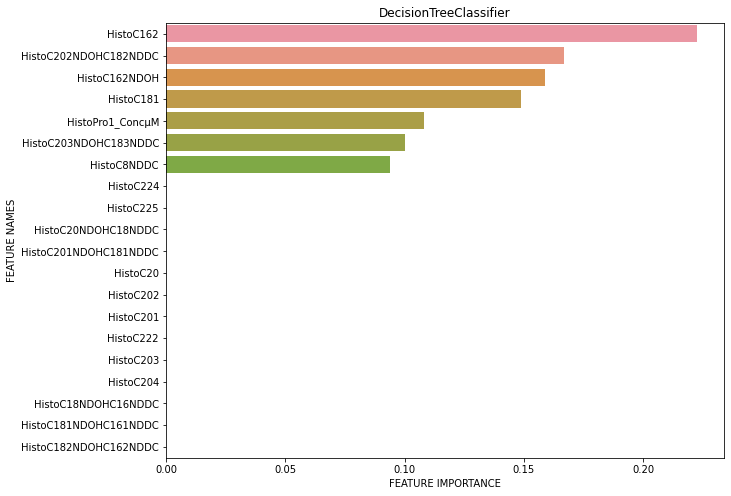

            feature_names  feature_importance
36              HistoC162            0.049530
25          HistoC121NDOH            0.027537
56  HistoC203NDOHC183NDDC            0.023125
28              HistoC142            0.022008
23               HistoC12            0.021504


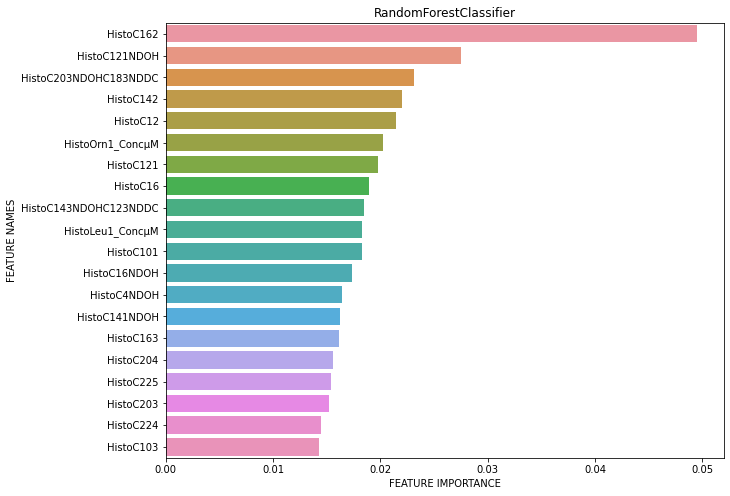

            feature_names  feature_importance
36              HistoC162            0.215925
45              HistoC181            0.093111
25          HistoC121NDOH            0.078363
34    HistoC14NDOHC12NDDC            0.056049
56  HistoC203NDOHC183NDDC            0.044208


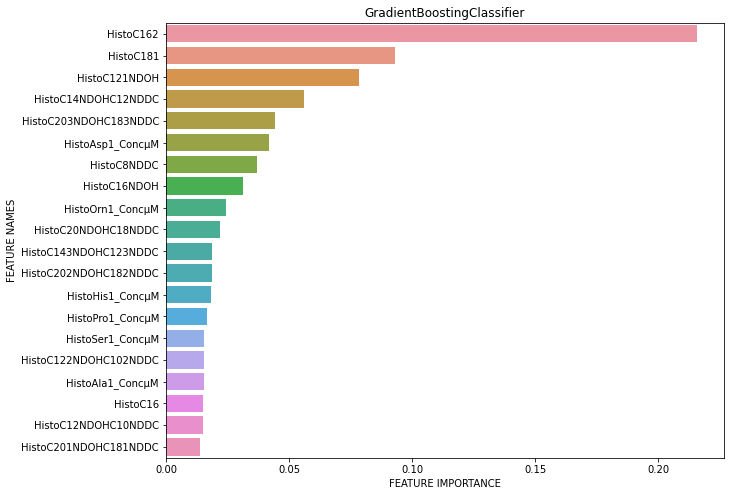

          feature_names  feature_importance
15            HistoC102            0.090442
59  HistoC20NDOHC18NDDC            0.071413
36            HistoC162            0.058080
6               HistoC6            0.054447
78     HistoHis1_ConcµM            0.054065


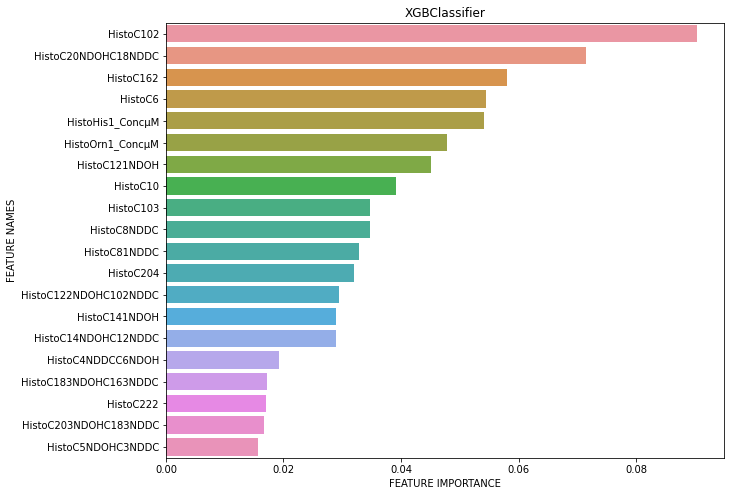

            feature_names  feature_importance
31  HistoC143NDOHC123NDDC                  18
36              HistoC162                  16
60              HistoC225                  14
42           HistoC16NDOH                  13
38               HistoC16                   9


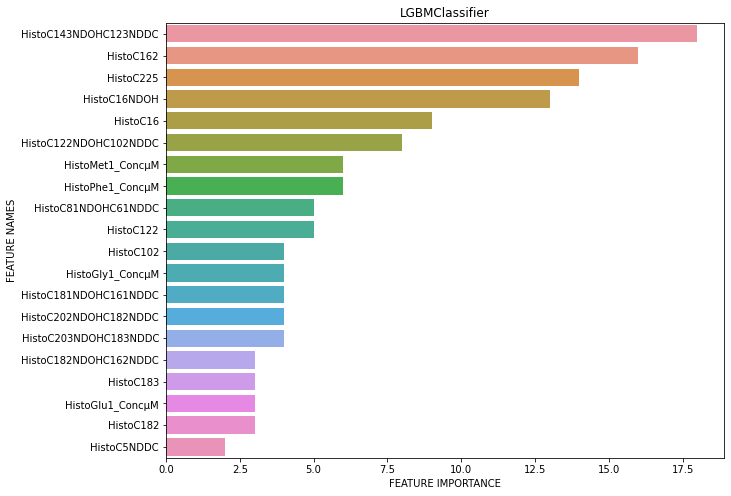

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.272727        0.465229      0.437315   
0                  GaussianNB       0.636364        0.495229      0.513179   
0        KNeighborsClassifier       0.590909        0.547582      0.554784   
0      DecisionTreeClassifier       0.772727        0.523203      0.524167   
0      RandomForestClassifier       0.545455        0.513725      0.543287   
0  GradientBoostingClassifier       0.545455        0.520523      0.524784   
0               XGBClassifier       0.590909        0.509150      0.521759   
0              LGBMClassifier       0.545455        0.505556      0.488272   
0                         SVC       0.545455        0.542222      0.607623   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.479722              0.480297       0.470097  
0           0.353889              0.531984       0.405303  
0           0.595833              0.550

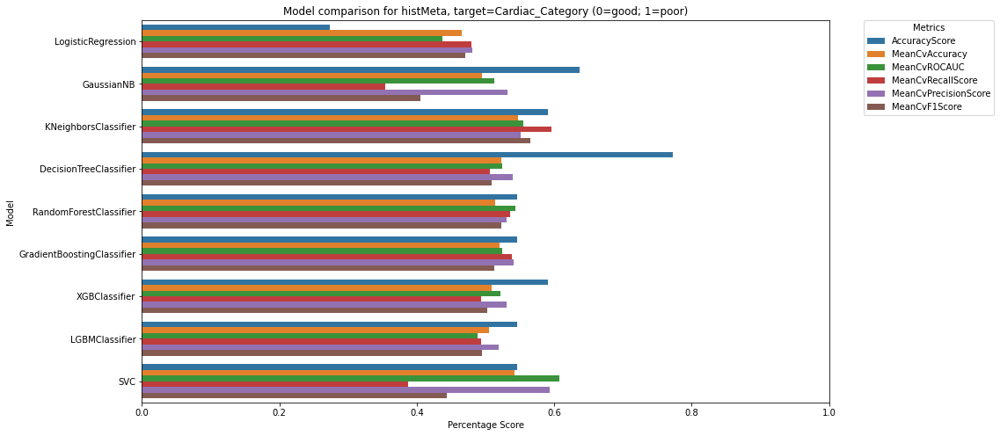

***********************************************


In [61]:
# Cell 9.5
warnings.filterwarnings(action='ignore', category=UserWarning)

# Use of each group of features to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
for key in cc_dfDict:
    compareClasModelVer2(cc_dfDict[key],targetFeat,title=f"Model comparison for {key}, target={targetFeat}",showImportance = True)

(86, 228)
Comparing models for Model comparison for truncated data, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Gender column contains only 2 values. Converting to binary
Male
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  1
These columns are:
 ['HistoCode']
Columns with missing values (%):
HistoCode        100.00
Leu1              13.95
C28               13.95
C26               13.95
C24               13.95
Fitness_score      6.98
C102               6.98
ALM                5.81
Lean_T             5.81
BNP                5.81
Lean_LL            5.81
Lean_RA            5.81
Lean_LA            5.81
BMR                5.81
Lean_RL            5.81
WHR                5.81
PBF                5.81
BFM                5.81
SMM                5.81
GALECTIN3          5.81
HSTNI              4.65
C203OHC183DC       3.49
HistoC51           2.33
C183               2.33
MMP9ngmL           2.33
C222

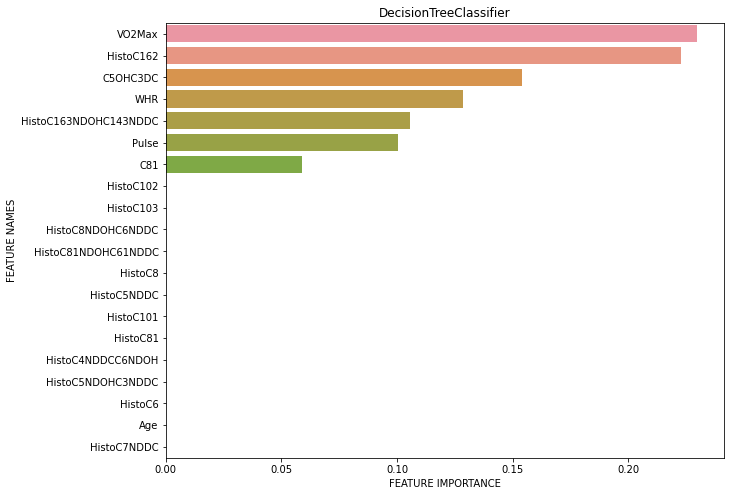

Top 10 features: ['HistoC162', 'HistoC143NDOHC123NDDC', 'HistoHis1_ConcµM', 'C222', 'Pulse', 'Cit1', 'HistoC10', 'VO2Max', 'HistoC203NDOHC183NDDC', 'HistoC143']


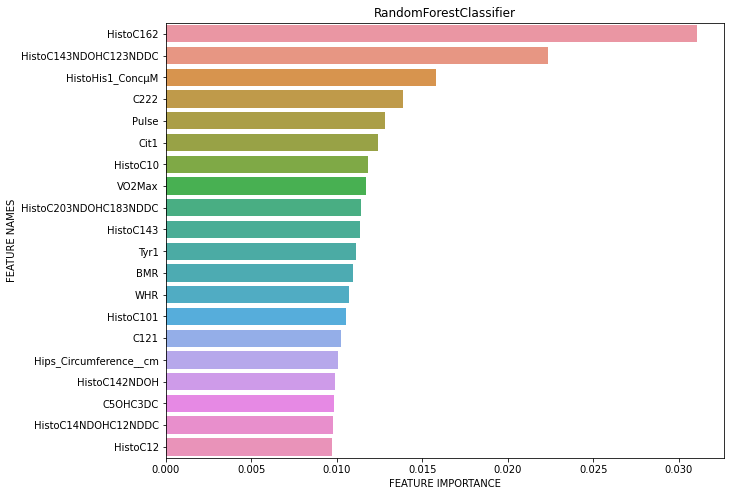

Top 10 features: ['HistoC162', 'C5OHC3DC', 'VO2Max', 'Pulse', 'HistoC203NDOHC183NDDC', 'C5DC', 'HistoC121NDOH', 'C28', 'Cit1', 'Tyr1']


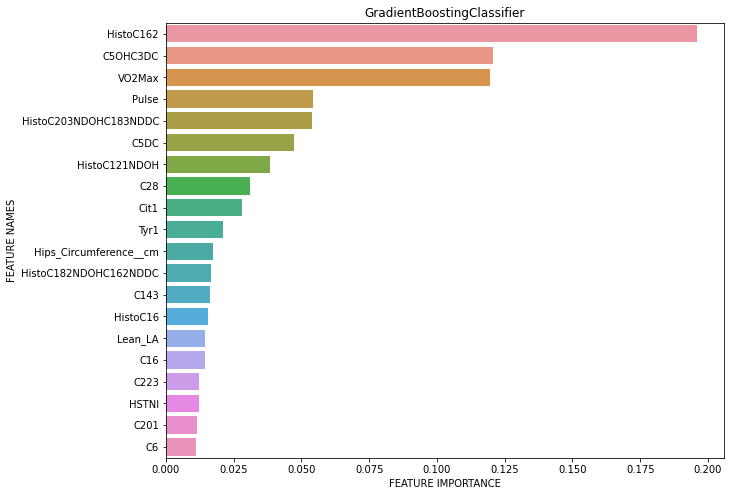

Top 10 features: ['C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C5OHC3DC', 'C102', 'Pulse']


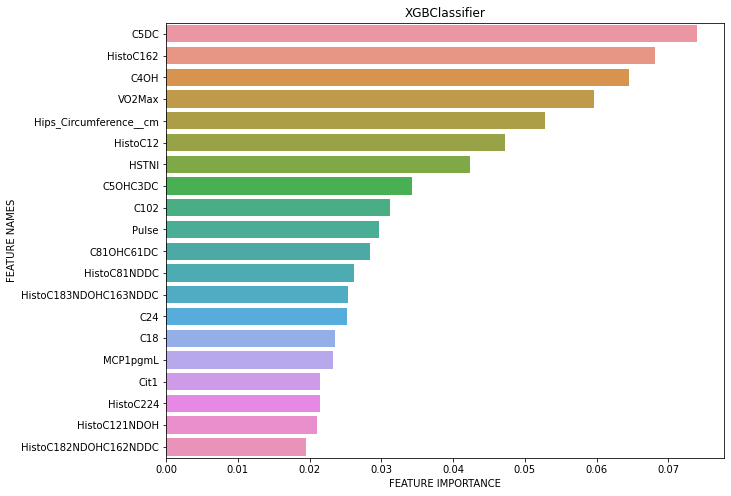

Top 10 features: ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101']


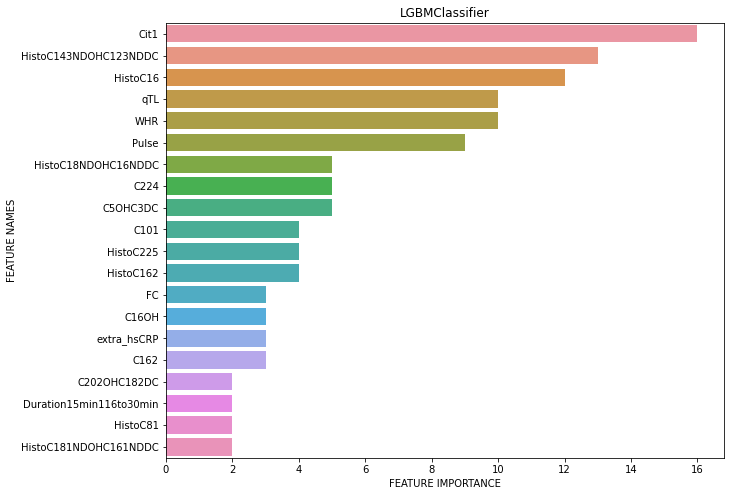

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.681818        0.516078      0.531944   
0                  GaussianNB       0.590909        0.489346      0.488056   
0        KNeighborsClassifier       0.318182        0.448954      0.443565   
0      DecisionTreeClassifier       0.500000        0.548824      0.548889   
0      RandomForestClassifier       0.500000        0.549935      0.556127   
0  GradientBoostingClassifier       0.454545        0.548105      0.556821   
0               XGBClassifier       0.636364        0.521046      0.510278   
0              LGBMClassifier       0.500000        0.468235      0.445494   
0                         SVC       0.590909        0.536144      0.594660   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.515556              0.521358       0.505937  
0           0.357222              0.504885       0.407981  
0           0.466389              0.456

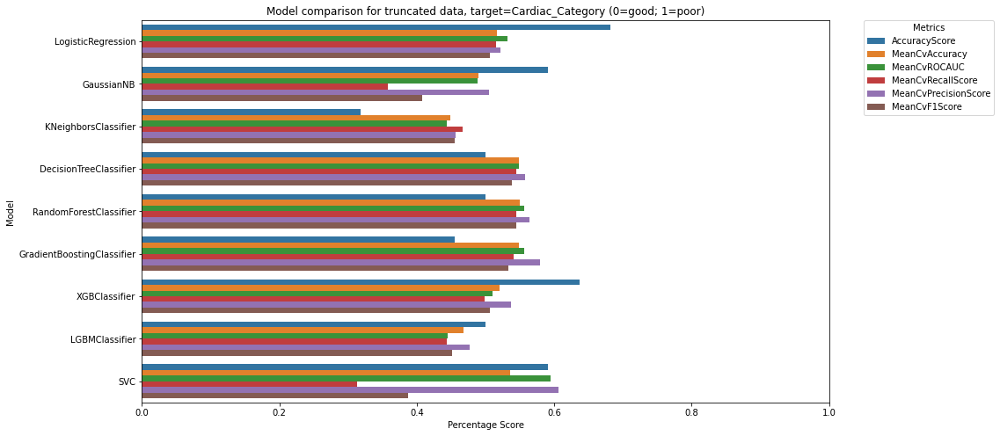

***********************************************


,Model,AccuracyScore,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.681818,0.516078,0.531944,0.515556,0.521358,0.505937
0,GaussianNB,0.590909,0.489346,0.488056,0.357222,0.504885,0.407981
0,KNeighborsClassifier,0.318182,0.448954,0.443565,0.466389,0.456805,0.455193
0,DecisionTreeClassifier,0.500000,0.548824,0.548889,0.545278,0.557904,0.538149
0,RandomForestClassifier,0.500000,0.549935,0.556127,0.545278,0.564375,0.544613
0,GradientBoostingClassifier,0.454545,0.548105,0.556821,0.540833,0.579890,0.533256
0,XGBClassifier,0.636364,0.521046,0.510278,0.499167,0.536997,0.506601
0,LGBMClassifier,0.500000,0.468235,0.445494,0.443056,0.476590,0.450831
0,SVC,0.590909,0.536144,0.594660,0.312500,0.606552,0.387324


In [68]:
# Cell 14
# Since echo and cmr are already known to have clinical significance, we now want to see if there are other features that can be used to predict cardiac category
# Also list down the most important features that we can combine to make a smaller and more curated set of features
# Classification on the whole dataset except for echo and cmr. Poor predictive power

data_trunc = data_full.drop(echoCols+cmrCols, axis=1)
print(data_trunc.shape) 
targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(data_trunc,targetFeat,title=f"Model comparison for truncated data, target={targetFeat}",showImportance = True)

Comparing models for Model comparison for curated data, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28    13.95
dtype: float64
Original Shape:(86, 16)
Final Shape:(86, 16)
______________________________
Initialising models...
             feature_names  feature_importance
6                HistoC162            0.222727
15               HistoC181            0.193528
2                      C28            0.158681
1   Hips_Circumference__cm            0.132546
10               HistoC143            0.118906


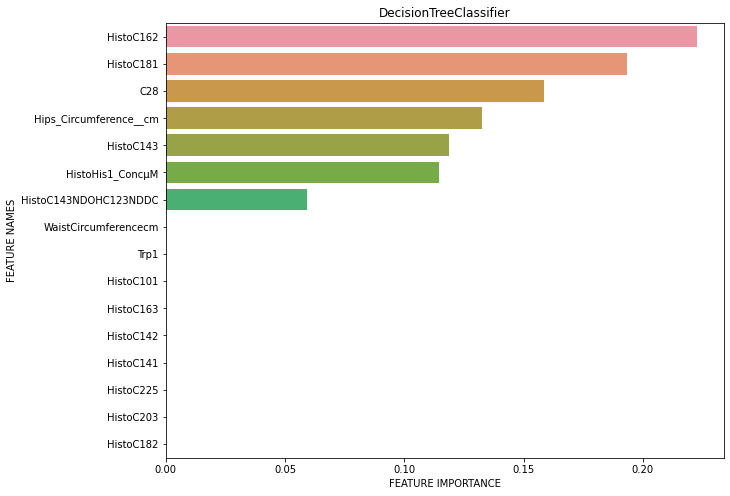

            feature_names  feature_importance
6               HistoC162            0.128322
12              HistoC225            0.088471
2                     C28            0.083320
15              HistoC181            0.079508
5   HistoC143NDOHC123NDDC            0.075628


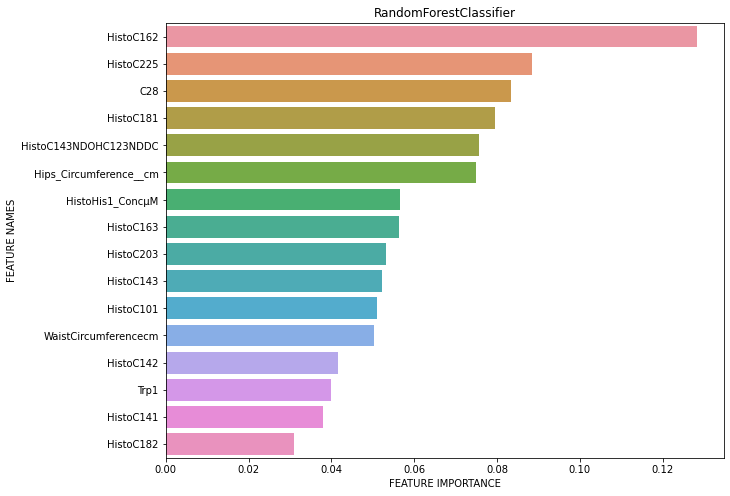

             feature_names  feature_importance
2                      C28            0.225801
6                HistoC162            0.205269
1   Hips_Circumference__cm            0.108970
15               HistoC181            0.096610
5    HistoC143NDOHC123NDDC            0.093069


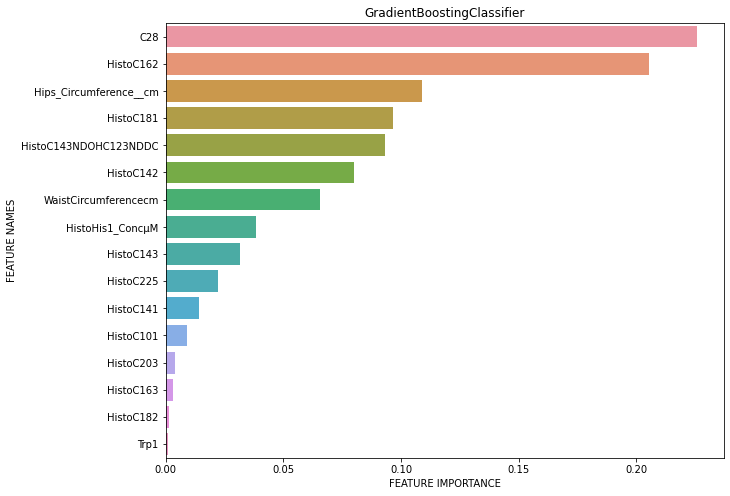

             feature_names  feature_importance
8                HistoC142            0.228065
6                HistoC162            0.118790
1   Hips_Circumference__cm            0.107374
11        HistoHis1_ConcµM            0.095529
15               HistoC181            0.095097


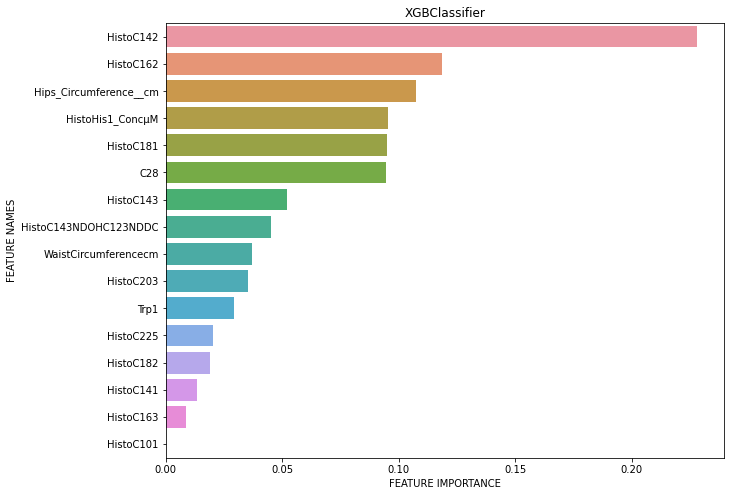

            feature_names  feature_importance
5   HistoC143NDOHC123NDDC                  26
12              HistoC225                  24
6               HistoC162                  20
14              HistoC182                  18
10              HistoC143                  14


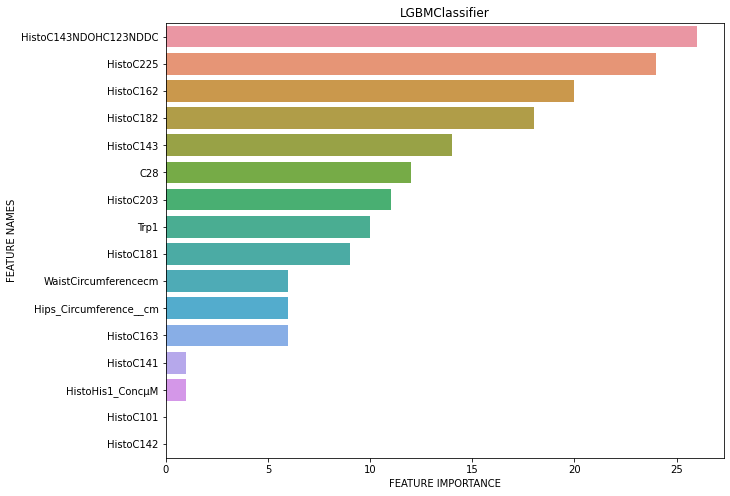

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.545455        0.640915      0.697160   
0                  GaussianNB       0.818182        0.682549      0.743241   
0        KNeighborsClassifier       0.636364        0.594706      0.636821   
0      DecisionTreeClassifier       0.590909        0.612941      0.611944   
0      RandomForestClassifier       0.681818        0.705752      0.747948   
0  GradientBoostingClassifier       0.590909        0.660458      0.691420   
0               XGBClassifier       0.636364        0.623464      0.662840   
0              LGBMClassifier       0.727273        0.622418      0.670355   
0                         SVC       0.636364        0.582353      0.653117   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.659167              0.666318       0.647144  
0           0.653611              0.712754       0.672680  
0           0.604167              0.619

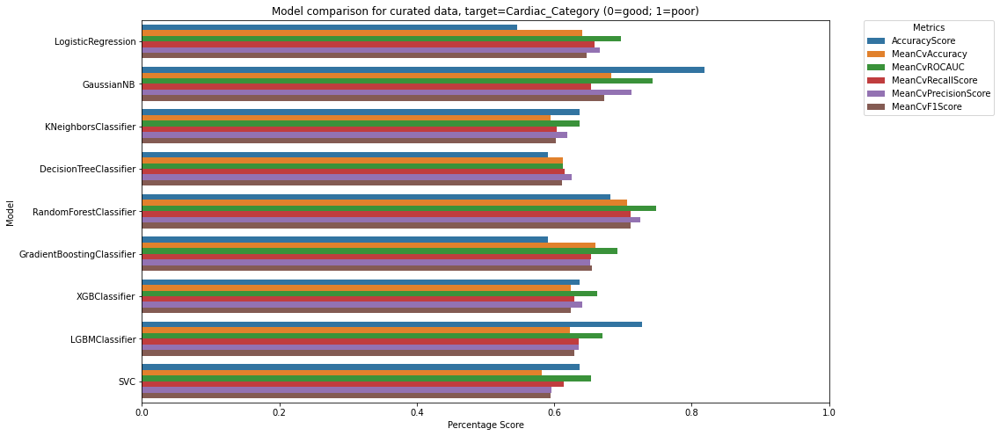

***********************************************


,Model,AccuracyScore,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.545455,0.640915,0.697160,0.659167,0.666318,0.647144
0,GaussianNB,0.818182,0.682549,0.743241,0.653611,0.712754,0.672680
0,KNeighborsClassifier,0.636364,0.594706,0.636821,0.604167,0.619243,0.602026
0,DecisionTreeClassifier,0.590909,0.612941,0.611944,0.615556,0.624822,0.610867
0,RandomForestClassifier,0.681818,0.705752,0.747948,0.711667,0.725058,0.710624
0,GradientBoostingClassifier,0.590909,0.660458,0.691420,0.653611,0.652340,0.654885
0,XGBClassifier,0.636364,0.623464,0.662840,0.628611,0.640180,0.624464
0,LGBMClassifier,0.727273,0.622418,0.670355,0.635833,0.635826,0.628994
0,SVC,0.636364,0.582353,0.653117,0.613889,0.595602,0.594737


In [63]:
# Cell 15 Ver 2.0: Self made
# Manually combine most important features
selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(curatedDf,targetFeat,title=f"Model comparison for curated data, target={targetFeat}",showImportance=True)

Comparing models for Model comparison for randomForestTop10, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C222    1.16
dtype: float64
Original Shape:(86, 10)
Final Shape:(86, 10)
______________________________
Initialising models...
Top 10 features: ['HistoC162' 'HistoC203NDOHC183NDDC' 'HistoC10' 'HistoC143' 'Pulse'
 'HistoC143NDOHC123NDDC' 'C222' 'HistoHis1_ConcµM' 'Cit1' 'VO2Max']


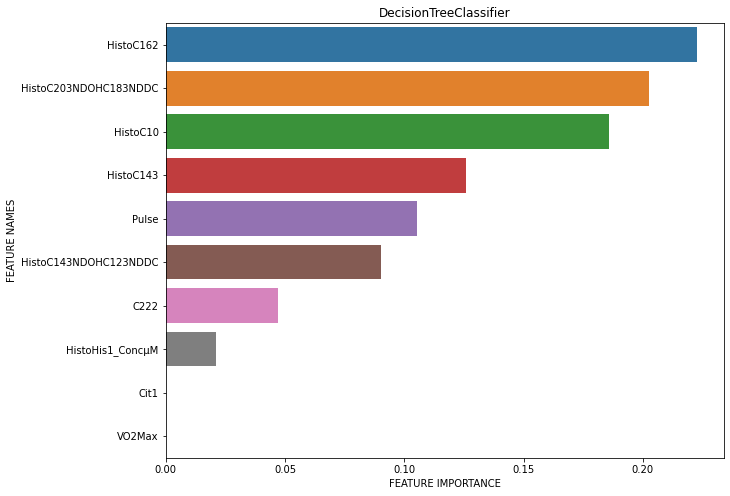

Top 10 features: ['Cit1' 'Pulse' 'HistoC162' 'HistoC143NDOHC123NDDC' 'VO2Max' 'HistoC143'
 'HistoHis1_ConcµM' 'C222' 'HistoC203NDOHC183NDDC' 'HistoC10']


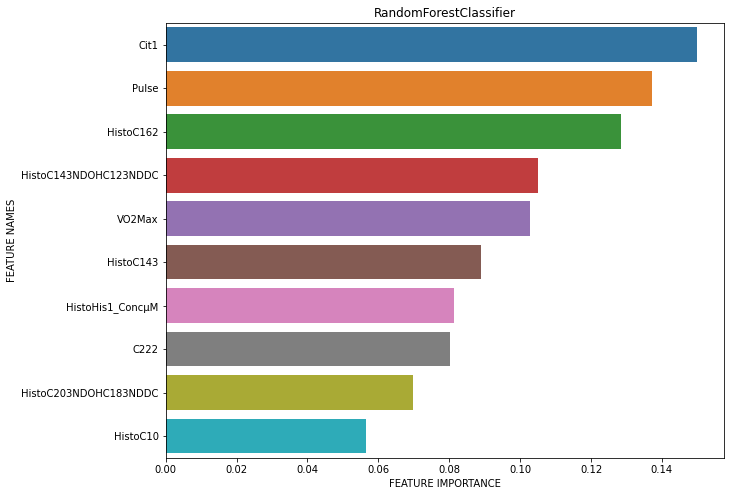

Top 10 features: ['HistoC162' 'Pulse' 'Cit1' 'HistoC143NDOHC123NDDC' 'HistoC143' 'VO2Max'
 'HistoC10' 'HistoC203NDOHC183NDDC' 'C222' 'HistoHis1_ConcµM']


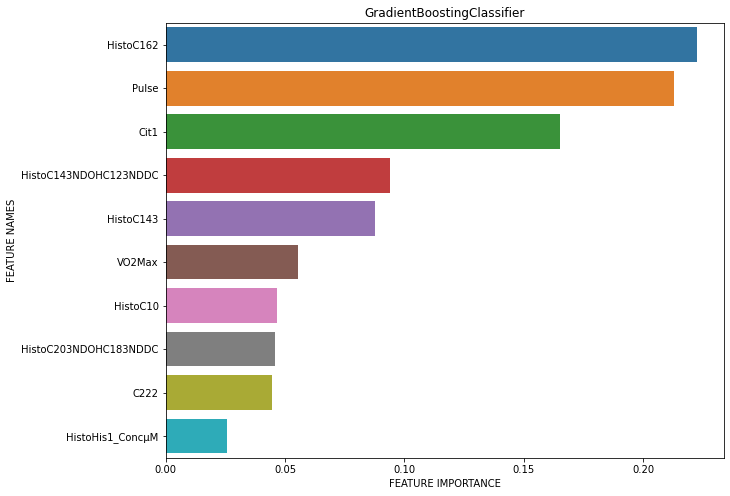

Top 10 features: ['HistoC162' 'Pulse' 'VO2Max' 'HistoC143' 'HistoC10'
 'HistoC203NDOHC183NDDC' 'Cit1' 'HistoC143NDOHC123NDDC' 'C222'
 'HistoHis1_ConcµM']


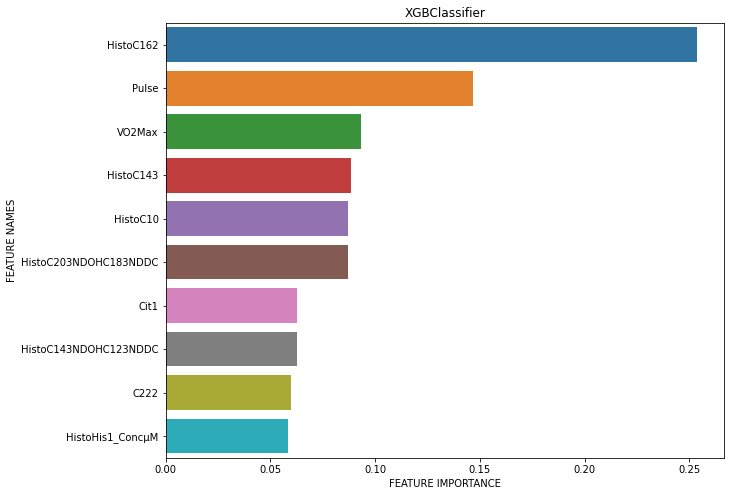

Top 10 features: ['Pulse' 'Cit1' 'HistoC143NDOHC123NDDC' 'HistoC143' 'HistoHis1_ConcµM'
 'HistoC203NDOHC183NDDC' 'HistoC10' 'VO2Max' 'HistoC162' 'C222']


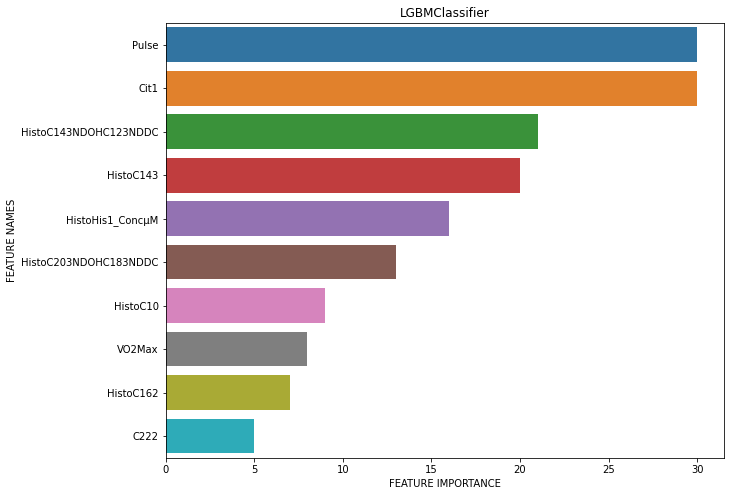

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.545455        0.613856      0.672315   
0                  GaussianNB       0.681818        0.628954      0.658302   
0        KNeighborsClassifier       0.363636        0.487843      0.496667   
0      DecisionTreeClassifier       0.409091        0.560065      0.560000   
0      RandomForestClassifier       0.590909        0.663922      0.716497   
0  GradientBoostingClassifier       0.636364        0.638366      0.685309   
0               XGBClassifier       0.545455        0.606013      0.661111   
0              LGBMClassifier       0.500000        0.602549      0.626759   
0                         SVC       0.590909        0.574575      0.607623   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.553611              0.654685       0.588999  
0           0.590833              0.666047       0.617214  
0           0.602500              0.497

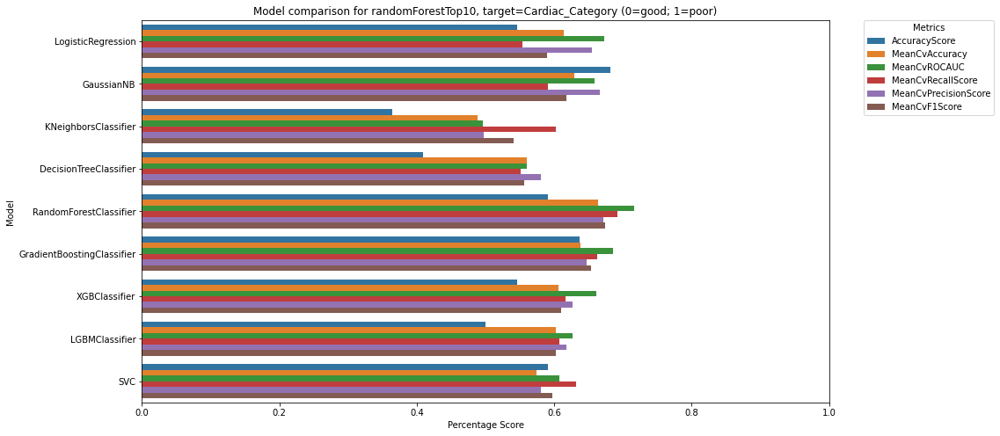

***********************************************


,Model,AccuracyScore,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.545455,0.613856,0.672315,0.553611,0.654685,0.588999
0,GaussianNB,0.681818,0.628954,0.658302,0.590833,0.666047,0.617214
0,KNeighborsClassifier,0.363636,0.487843,0.496667,0.602500,0.497456,0.540835
0,DecisionTreeClassifier,0.409091,0.560065,0.560000,0.550833,0.580385,0.556162
0,RandomForestClassifier,0.590909,0.663922,0.716497,0.691667,0.671358,0.673884
0,GradientBoostingClassifier,0.636364,0.638366,0.685309,0.662222,0.646771,0.652971
0,XGBClassifier,0.545455,0.606013,0.661111,0.616389,0.626165,0.609417
0,LGBMClassifier,0.500000,0.602549,0.626759,0.607222,0.617245,0.602136
0,SVC,0.590909,0.574575,0.607623,0.631667,0.580172,0.596985


In [66]:
# Using random forest top 10 features: ['HistoC162','HistoC143NDOHC123NDDC','HistoHis1_ConcµM','C222','Pulse','Cit1','HistoC10','VO2Max','HistoC203NDOHC183NDDC','HistoC143']
selfMadeCols = ['HistoC162','HistoC143NDOHC123NDDC','HistoHis1_ConcµM','C222','Pulse','Cit1','HistoC10','VO2Max','HistoC203NDOHC183NDDC','HistoC143',"Cardiac_Category (0=good; 1=poor)"]
randomForestTop10 = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(randomForestTop10,targetFeat,title=f"Model comparison for randomForestTop10, target={targetFeat}",showImportance=True)


Comparing models for Model comparison for combinedTopFeatImportanceDf, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28      13.95
C102      6.98
WHR       5.81
HSTNI     4.65
qTL       1.16
C101      1.16
C222      1.16
dtype: float64
Original Shape:(86, 31)
Final Shape:(86, 31)
______________________________
Initialising models...
Top 10 features: ['VO2Max', 'HistoC162', 'C5OHC3DC', 'HistoC163NDOHC143NDDC', 'Pulse', 'WHR', 'C28', 'Cit1', 'Tyr1', 'C81']


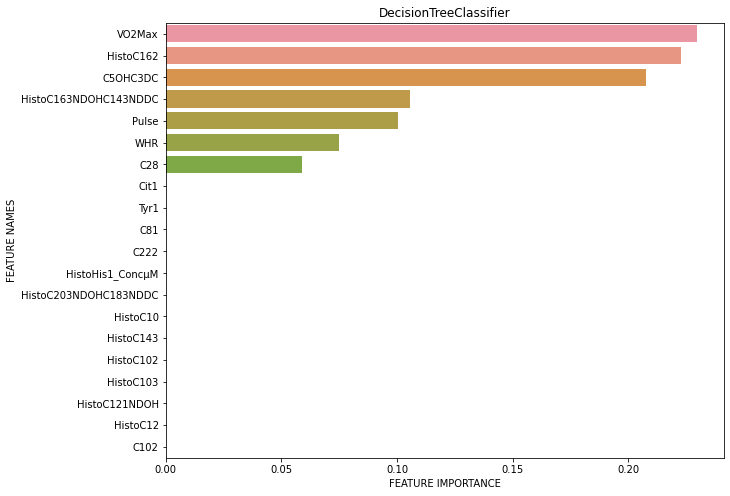

Top 10 features: ['HistoC143NDOHC123NDDC', 'Pulse', 'VO2Max', 'HistoC121NDOH', 'Cit1', 'HistoC162', 'WHR', 'HistoC16', 'Tyr1', 'Hips_Circumference__cm']


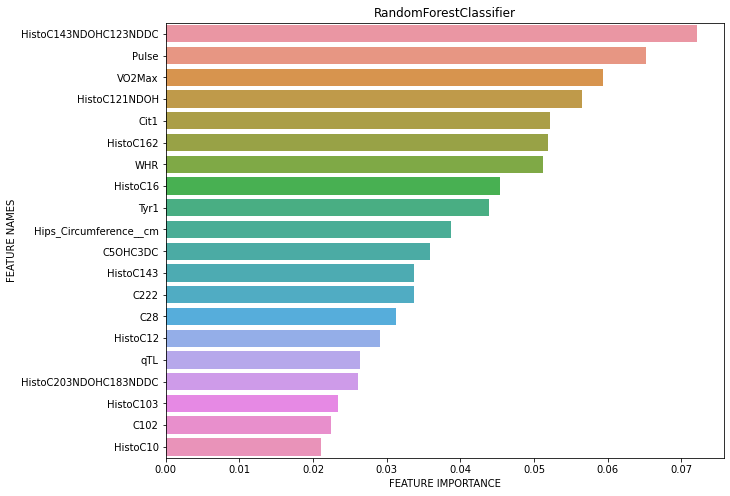

Top 10 features: ['HistoC162', 'VO2Max', 'C5OHC3DC', 'Pulse', 'HistoC121NDOH', 'C5DC', 'Tyr1', 'C28', 'HistoC203NDOHC183NDDC', 'Hips_Circumference__cm']


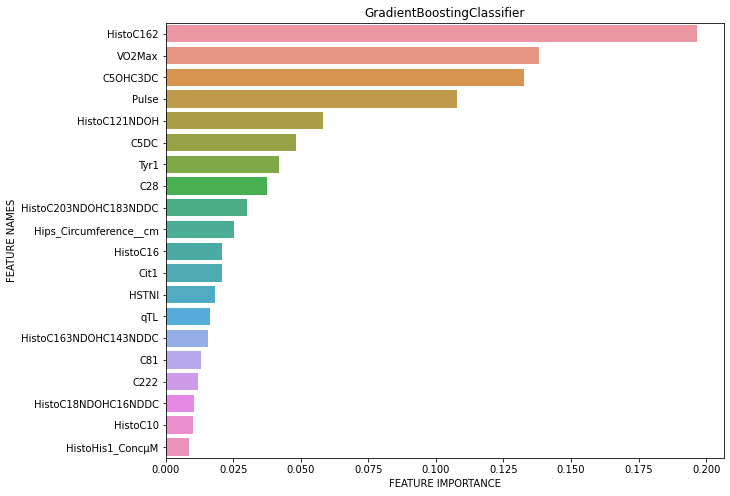

Top 10 features: ['HistoC162', 'VO2Max', 'HistoC121NDOH', 'C4OH', 'Pulse', 'C5OHC3DC', 'HSTNI', 'HistoC12', 'C5DC', 'Hips_Circumference__cm']


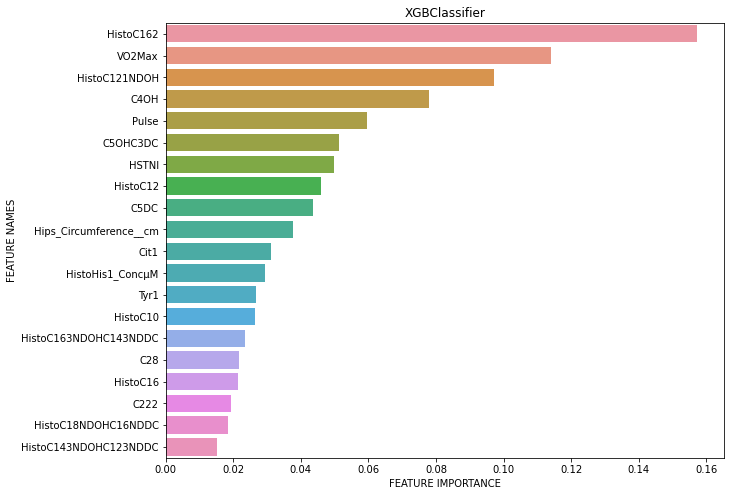

Top 10 features: ['Cit1', 'HistoC16', 'qTL', 'WHR', 'HistoC143NDOHC123NDDC', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C222']


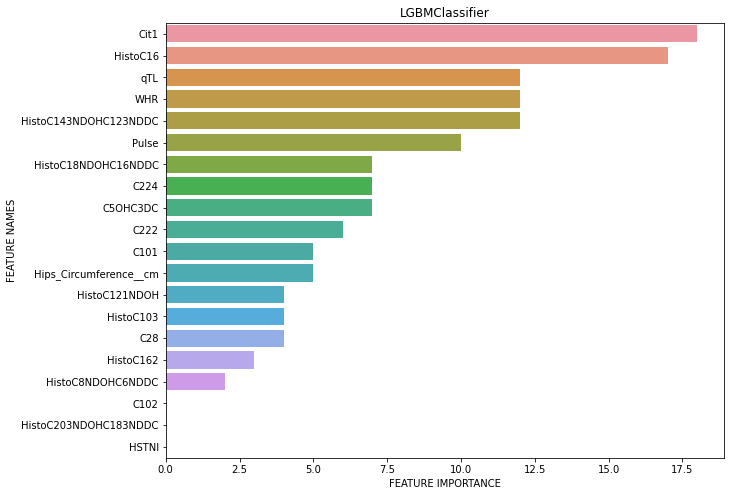

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.545455        0.585229      0.593364   
0                  GaussianNB       0.590909        0.566928      0.615293   
0        KNeighborsClassifier       0.545455        0.506013      0.540463   
0      DecisionTreeClassifier       0.500000        0.614837      0.614028   
0      RandomForestClassifier       0.681818        0.678170      0.740139   
0  GradientBoostingClassifier       0.636364        0.658170      0.721512   
0               XGBClassifier       0.545455        0.642353      0.688333   
0              LGBMClassifier       0.454545        0.599150      0.644352   
0                         SVC       0.636364        0.571307      0.586481   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.575000              0.614209       0.580281  
0           0.399444              0.635716       0.478463  
0           0.501111              0.517

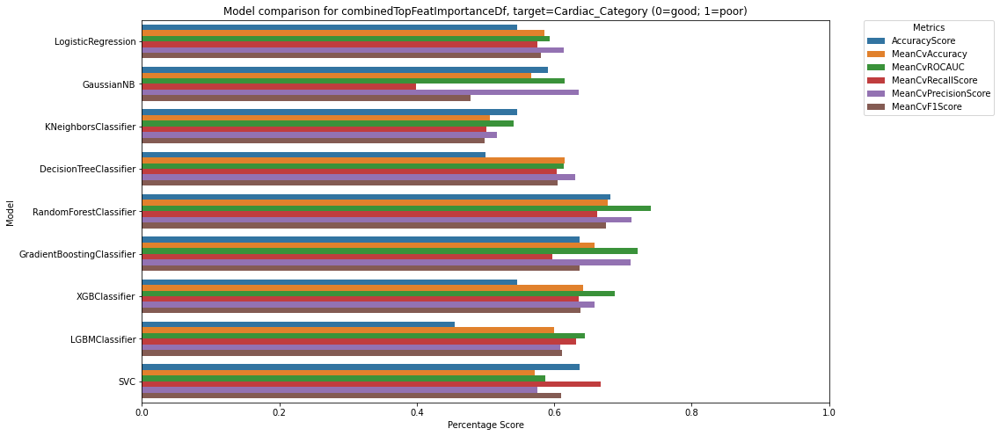

***********************************************


,Model,AccuracyScore,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.545455,0.585229,0.593364,0.575000,0.614209,0.580281
0,GaussianNB,0.590909,0.566928,0.615293,0.399444,0.635716,0.478463
0,KNeighborsClassifier,0.545455,0.506013,0.540463,0.501111,0.517053,0.498279
0,DecisionTreeClassifier,0.500000,0.614837,0.614028,0.603333,0.630099,0.605452
0,RandomForestClassifier,0.681818,0.678170,0.740139,0.662222,0.712608,0.674898
0,GradientBoostingClassifier,0.636364,0.658170,0.721512,0.596944,0.711771,0.636819
0,XGBClassifier,0.545455,0.642353,0.688333,0.635556,0.658747,0.638526
0,LGBMClassifier,0.454545,0.599150,0.644352,0.631389,0.608241,0.610998
0,SVC,0.636364,0.571307,0.586481,0.667222,0.575174,0.610476


In [71]:
# Combine top 10 features from each model, dropping repeated features
selfMadeCols =  ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']
combinedTopFeatImportanceDf = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(combinedTopFeatImportanceDf,targetFeat,title=f"Model comparison for combinedTopFeatImportanceDf, target={targetFeat}",showImportance=True)

In [131]:
mylist = ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101','C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C5OHC3DC', 'C102', 'Pulse','HistoC162', 'C5OHC3DC', 'VO2Max', 'Pulse', 'HistoC203NDOHC183NDDC', 'C5DC', 'HistoC121NDOH', 'C28', 'Cit1', 'Tyr1','VO2Max', 'HistoC162', 'C5OHC3DC', 'WHR', 'HistoC163NDOHC143NDDC', 'Pulse', 'C81', 'HistoC162', 'HistoC143NDOHC123NDDC', 'HistoHis1_ConcµM', 'C222', 'Pulse', 'Cit1', 'HistoC10', 'VO2Max', 'HistoC203NDOHC183NDDC', 'HistoC143','HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC',"Cardiac_Category (0=good; 1=poor)"]
uniqueList = list(dict.fromkeys(mylist))
print(uniqueList)
print(len(uniqueList))


['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']
32


In [80]:
# ARBITRARILY SELF MADE COLUMNS
# selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[selfMadeCols]

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=0,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=0,verbose=False).fit(xTrain,yTrain)

yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=0)
xImputed = x.fillna(x.median())
cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvAccuracyScore = cvAccuracyScoreArray.mean()
#cvRocAucScore = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc').mean()
#cvRecallScore = cross_val_score(model,xImputed,y,cv=cv,scoring='recall').mean()
#cvPrecisionScore = cross_val_score(model,xImputed,y,cv=cv,scoring='precision').mean()
#cvF1Score = cross_val_score(model,xImputed,y,cv=cv,scoring='f1').mean()

print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
cvAccuracyScoreArray

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28    13.95
dtype: float64
Original Shape:(86, 16)
Final Shape:(86, 16)
______________________________
Initialising models...
Accuracy: 0.6923076923076923
Predictions: 
[0 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1]
Answers: 
[0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1]
cvAccuracyScore: 0.6942483660130719


array([0.72222222, 0.64705882, 0.76470588, 0.82352941, 0.76470588,
       0.83333333, 0.70588235, 0.58823529, 0.70588235, 0.64705882,
       0.66666667, 0.70588235, 0.64705882, 0.70588235, 0.70588235,
       0.66666667, 0.82352941, 0.64705882, 0.70588235, 0.70588235,
       0.83333333, 0.64705882, 0.47058824, 0.64705882, 0.82352941,
       0.66666667, 0.64705882, 0.58823529, 0.70588235, 0.82352941,
       0.55555556, 0.58823529, 0.82352941, 0.58823529, 0.76470588,
       0.72222222, 0.76470588, 0.52941176, 0.76470588, 0.70588235,
       0.55555556, 0.70588235, 0.70588235, 0.70588235, 0.70588235,
       0.66666667, 0.70588235, 0.88235294, 0.70588235, 0.52941176])

df.shape: (86, 32)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28      13.95
C102      6.98
WHR       5.81
HSTNI     4.65
qTL       1.16
C101      1.16
C222      1.16
dtype: float64
Original Shape:(86, 31)
Final Shape:(86, 31)
______________________________
Initialising models...
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting es

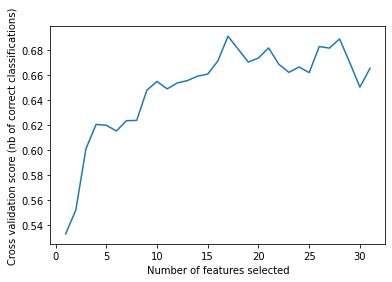

Index(['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'WHR', 'Pulse', 'C5OHC3DC',
       'C101', 'HistoC162', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12',
       'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'C81',
       'HistoC143'],
      dtype='object')


In [92]:
topFeatImptCols =  ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']
combinedTopFeatImportanceDf = data_full[topFeatImptCols]

df = combinedTopFeatImportanceDf
print(f"df.shape: {df.shape}") 
targetFeat = "Cardiac_Category (0=good; 1=poor)"

min_features_to_select = 1

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=0)
print("Initialising models...")
rfecv  = RFECV(estimator=RandomForestClassifier(random_state=0,verbose=False), min_features_to_select=min_features_to_select,cv=cv,scoring='accuracy',verbose=1)
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns
xImputed = x.fillna(x.median())
rfecv.fit(xImputed, y)

print("Optimal number of features : %d" % rfecv.n_features_)

# Plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(min_features_to_select,
               len(rfecv.grid_scores_) + min_features_to_select),
         rfecv.grid_scores_)
plt.show()

optimisedFeatureSet = x[x.columns[rfecv.support_]]
print(optimisedFeatureSet.columns)

In [99]:
optimisedFeatureSet

,Cit1,HistoC143NDOHC123NDDC,HistoC16,WHR,Pulse,C5OHC3DC,C101,HistoC162,VO2Max,Hips_Circumference__cm,HistoC12,HistoC203NDOHC183NDDC,HistoC121NDOH,C28,Tyr1,C81,HistoC143
0,34.982000,1.093284,159.937042,0.81,67,19.634703,61.172977,5.825521,46,83,54.732510,1.531742,11.659808,0.163748,35.929000,209.716251,2.623883
1,51.138000,1.311941,189.770773,0.94,79,23.469703,56.030594,6.355114,25,87,67.009602,3.501126,10.288066,2.512645,82.686000,54.368531,3.279854
2,45.928000,1.337505,192.489073,0.91,76,22.606538,73.088843,8.257396,36,94,80.513919,3.486705,26.124197,2.543838,102.497000,258.735010,5.350022
3,42.695000,0.444364,111.340048,0.84,72,24.479032,47.848728,2.742366,47,84,37.050106,2.301413,8.892025,2.491666,88.039000,46.843553,1.777456
4,24.676000,0.876414,103.235753,0.85,80,21.425747,34.552539,4.941198,39,93,24.333561,1.088249,7.108681,1.770842,93.277000,117.725252,3.067448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,26.011015,1.333092,104.392721,0.88,60,22.762843,46.735701,5.301907,28,98,42.484121,3.452120,22.230064,NaN,29.326996,247.551132,4.443641
82,38.636000,0.889558,155.024022,0.86,78,37.110266,334.492083,5.669260,30,83,51.213824,1.503059,27.372079,0.735478,57.147000,561.189800,4.646567
83,56.543000,1.110910,118.104550,0.78,62,24.200913,153.080921,7.678624,38,93,70.148200,1.841131,10.797459,0.654992,88.356000,125.967326,8.220735
84,15.710000,1.114588,152.119582,0.90,76,27.318398,140.793881,7.156410,28,90,76.374019,1.627129,9.992862,2.863913,33.836000,128.957961,3.789599


In [137]:
#optimisedFeatureSet.columns + 
#['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'WHR', 'Pulse', 'C5OHC3DC','C101', 'HistoC162', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12','HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'C81','HistoC143']

optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]

#optimisedCols = ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']

#print(optimisedCols)
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[optimisedCols]
#print(df)
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=1,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=1,verbose=False)#.fit(xTrain,yTrain)

#model = make_pipeline(StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.15000000000000002, min_samples_leaf=1, min_samples_split=14, n_estimators=100)),StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.15000000000000002, min_samples_leaf=1, min_samples_split=8, n_estimators=100)),GradientBoostingClassifier(learning_rate=0.01, max_depth=4, max_features=0.5, min_samples_leaf=7,min_samples_split=15, n_estimators=100, subsample=0.45))
# Fix random state for all the steps in exported pipeline
#set_param_recursive(model.steps, 'random_state', 1)

model.fit(xTrain,yTrain)
yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
xImputed = x.fillna(x.median())

cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvRocAucScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc')
cvRecallScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='recall')
cvPrecisionScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='precision')
cvF1ScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='f1')

cvAccuracyScore = cvAccuracyScoreArray.mean()
cvRocAucScore = cvRocAucScoreArray.mean()
cvRecallScore = cvRecallScoreArray.mean()
cvPrecisionScore = cvPrecisionScoreArray.mean()
cvF1Score = cvF1ScoreArray.mean()



print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
print(f"cvRocAucScore: {cvRocAucScore}")
print(f"cvRecallScore: {cvRecallScore}")
print(f"cvPrecisionScore: {cvPrecisionScore}")
print(f"cvF1Score: {cvF1Score}")
cvAccuracyScoreArray

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
Accuracy: 0.8076923076923077
Predictions: 
[0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.7399346405228756
cvRocAucScore: 0.8038425925925925
cvRecallScore: 0.7177777777777777
cvPrecisionScore: 0.7725884670884671
cvF1Score: 0.7349962007376867


array([0.72222222, 0.70588235, 0.58823529, 0.76470588, 0.82352941,
       0.83333333, 0.70588235, 0.82352941, 0.82352941, 0.58823529,
       0.55555556, 0.88235294, 0.64705882, 0.82352941, 0.70588235,
       0.66666667, 0.82352941, 0.70588235, 0.64705882, 1.        ,
       0.61111111, 0.76470588, 0.70588235, 0.76470588, 0.70588235,
       0.83333333, 0.88235294, 0.76470588, 0.58823529, 0.58823529,
       0.5       , 0.64705882, 0.88235294, 0.82352941, 0.70588235,
       0.55555556, 0.76470588, 0.88235294, 0.76470588, 0.82352941,
       0.88888889, 0.70588235, 0.70588235, 0.88235294, 0.70588235,
       0.88888889, 0.76470588, 0.76470588, 0.58823529, 0.70588235])

In [138]:
#optimisedFeatureSet.columns + 
#['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'WHR', 'Pulse', 'C5OHC3DC','C101', 'HistoC162', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12','HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'C81','HistoC143']

optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]

#optimisedCols = ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']

#print(optimisedCols)
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[optimisedCols]
#print(df)
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=1,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

#model = RandomForestClassifier(random_state=1,verbose=False)#.fit(xTrain,yTrain)

model = make_pipeline(StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.15000000000000002, min_samples_leaf=1, min_samples_split=14, n_estimators=100)),StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.15000000000000002, min_samples_leaf=1, min_samples_split=8, n_estimators=100)),GradientBoostingClassifier(learning_rate=0.01, max_depth=4, max_features=0.5, min_samples_leaf=7,min_samples_split=15, n_estimators=100, subsample=0.45))
# Fix random state for all the steps in exported pipeline
set_param_recursive(model.steps, 'random_state', 1)

model.fit(xTrain,yTrain)
yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
xImputed = x.fillna(x.median())

cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvRocAucScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc')
cvRecallScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='recall')
cvPrecisionScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='precision')
cvF1ScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='f1')

cvAccuracyScore = cvAccuracyScoreArray.mean()
cvRocAucScore = cvRocAucScoreArray.mean()
cvRecallScore = cvRecallScoreArray.mean()
cvPrecisionScore = cvPrecisionScoreArray.mean()
cvF1Score = cvF1ScoreArray.mean()



print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
print(f"cvRocAucScore: {cvRocAucScore}")
print(f"cvRecallScore: {cvRecallScore}")
print(f"cvPrecisionScore: {cvPrecisionScore}")
print(f"cvF1Score: {cvF1Score}")
cvAccuracyScoreArray

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
Accuracy: 0.8461538461538461
Predictions: 
[0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 1 0]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.75718954248366
cvRocAucScore: 0.7967592592592593
cvRecallScore: 0.7422222222222221
cvPrecisionScore: 0.786295204795205
cvF1Score: 0.7568737664124661


array([0.72222222, 0.82352941, 0.64705882, 0.88235294, 0.88235294,
       0.77777778, 0.76470588, 0.64705882, 0.94117647, 0.64705882,
       0.55555556, 0.82352941, 0.82352941, 0.88235294, 0.76470588,
       0.61111111, 0.82352941, 0.82352941, 0.70588235, 0.70588235,
       0.83333333, 0.82352941, 0.64705882, 0.70588235, 0.64705882,
       0.77777778, 0.88235294, 0.82352941, 0.64705882, 0.64705882,
       0.72222222, 0.70588235, 0.88235294, 0.82352941, 0.64705882,
       0.61111111, 0.88235294, 0.82352941, 0.58823529, 0.70588235,
       0.83333333, 0.70588235, 0.76470588, 0.88235294, 0.82352941,
       0.94444444, 0.70588235, 0.82352941, 0.58823529, 0.70588235])

In [91]:
df = data_full.drop(echoCols+cmrCols, axis=1)
print(df.shape) 
targetFeat = "Cardiac_Category (0=good; 1=poor)"

min_features_to_select = 1

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=0)
print("Initialising models...")
rfecv  = RFECV(estimator=RandomForestClassifier(random_state=0,verbose=False), min_features_to_select=min_features_to_select,cv=cv,scoring='accuracy',verbose=1)
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns
xImputed = x.fillna(x.median())
rfecv.fit(xImputed, y)

print("Optimal number of features : %d" % rfecv.n_features_)

# Plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(min_features_to_select,
               len(rfecv.grid_scores_) + min_features_to_select),
         rfecv.grid_scores_)
plt.show()

optimisedFeatureSet = x[x.columns[rfecv.support_]]
print(optimisedFeatureSet.columns)


Index(['Age', 'Weightkg', 'Pulse', 'WaistCircumferencecm', 'DBP',
       'Hips_Circumference__cm', 'VO2Max', 'BNP', 'HSTNI',
       'extra_tc_HDL_ratio',
       ...
       'HistoC24', 'HistoC28', 'HistoAla1_ConcµM', 'HistoSer1_ConcµM',
       'HistoPro1_ConcµM', 'HistoVal1_ConcµM', 'HistoOrn1_ConcµM',
       'HistoMet1_ConcµM', 'HistoHis1_ConcµM', 'HistoGlu1_ConcµM'],
      dtype='object', length=121)


Comparing models for Model comparison for featureEngineeredDf, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
Top 10 features: ['VO2Max', 'HistoC162', 'C5OHC3DC', 'Tyr1', 'Pulse', 'WHR', 'C81', 'Cit1', 'HistoC143NDOHC123NDDC', 'Hips_Circumference__cm']


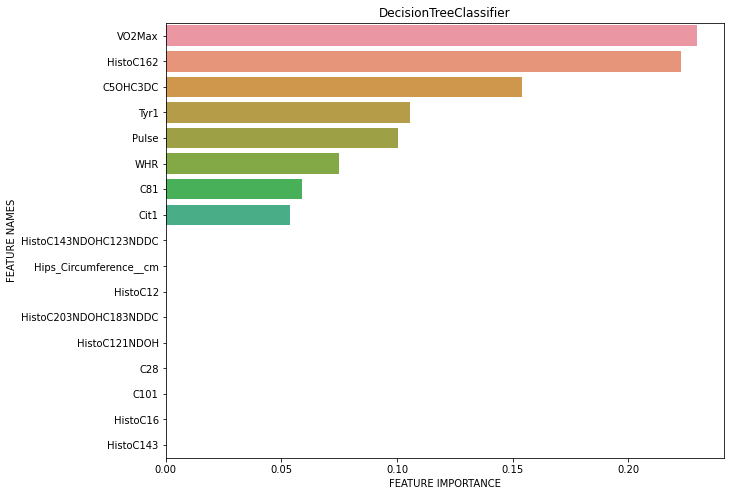

Top 10 features: ['HistoC162', 'Pulse', 'Cit1', 'HistoC16', 'HistoC121NDOH', 'C5OHC3DC', 'HistoC143', 'HistoC203NDOHC183NDDC', 'VO2Max', 'C28']


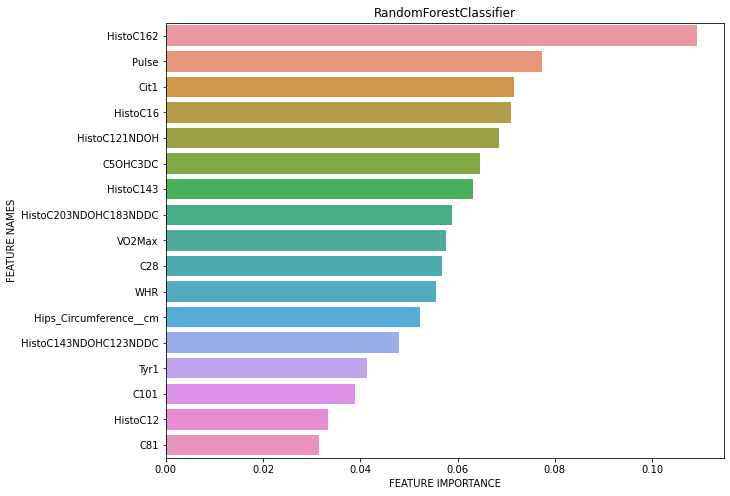

Top 10 features: ['HistoC162', 'VO2Max', 'C5OHC3DC', 'Tyr1', 'HistoC121NDOH', 'Pulse', 'Cit1', 'Hips_Circumference__cm', 'HistoC203NDOHC183NDDC', 'C28']


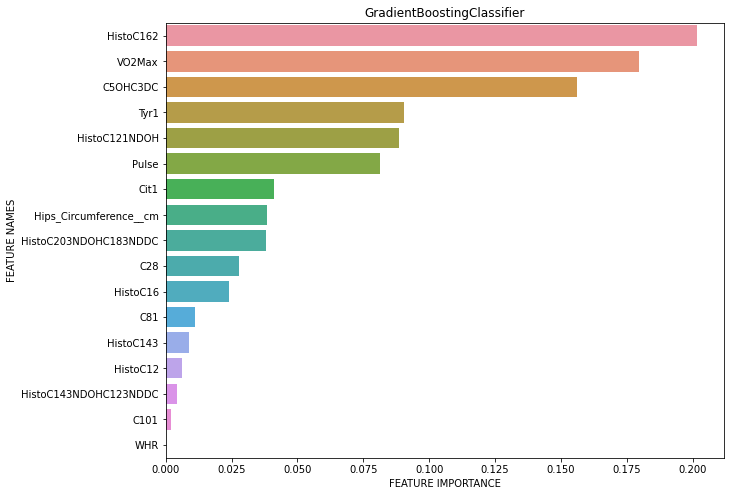

Top 10 features: ['HistoC162', 'VO2Max', 'HistoC121NDOH', 'Pulse', 'Hips_Circumference__cm', 'C5OHC3DC', 'Tyr1', 'HistoC12', 'Cit1', 'HistoC143NDOHC123NDDC']


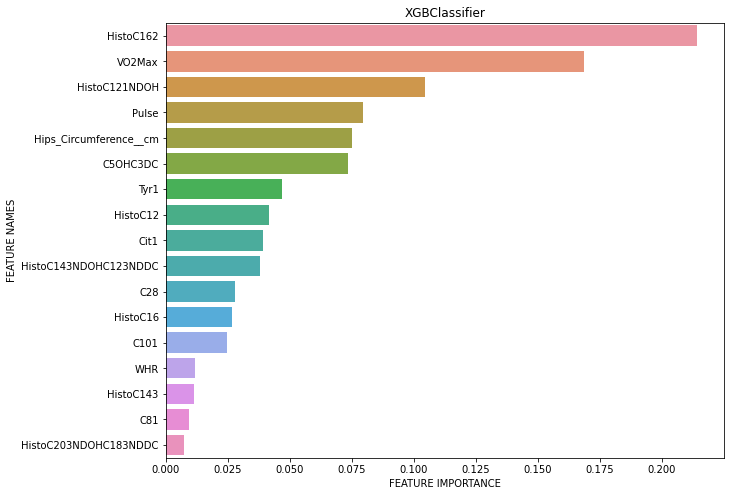

Top 10 features: ['Pulse', 'Cit1', 'HistoC16', 'WHR', 'HistoC143NDOHC123NDDC', 'HistoC121NDOH', 'C28', 'C5OHC3DC', 'HistoC162', 'Tyr1']


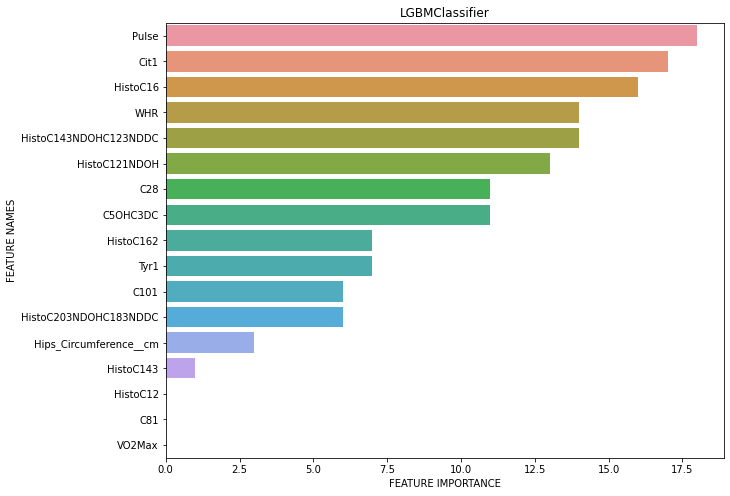

                        Model  AccuracyScore  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression       0.636364        0.614379      0.660216   
0                  GaussianNB       0.681818        0.637190      0.735741   
0        KNeighborsClassifier       0.590909        0.628170      0.673519   
0      DecisionTreeClassifier       0.500000        0.595425      0.594583   
0      RandomForestClassifier       0.681818        0.748758      0.812469   
0  GradientBoostingClassifier       0.590909        0.699935      0.750000   
0               XGBClassifier       0.545455        0.674379      0.731265   
0              LGBMClassifier       0.500000        0.646667      0.702068   
0                         SVC       0.636364        0.554052      0.610370   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.587778              0.633377       0.601828  
0           0.495000              0.733485       0.573056  
0           0.653889              0.640

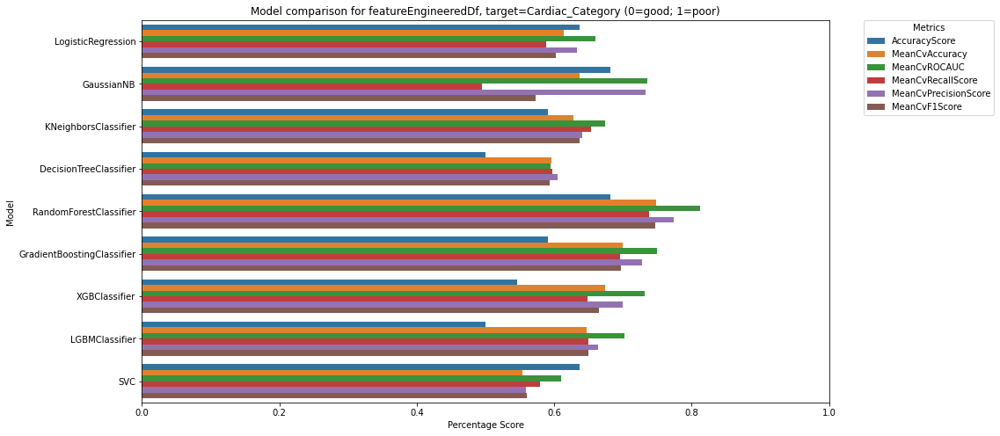

***********************************************


,Model,AccuracyScore,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.636364,0.614379,0.660216,0.587778,0.633377,0.601828
0,GaussianNB,0.681818,0.637190,0.735741,0.495000,0.733485,0.573056
0,KNeighborsClassifier,0.590909,0.628170,0.673519,0.653889,0.640994,0.637362
0,DecisionTreeClassifier,0.500000,0.595425,0.594583,0.596944,0.605154,0.592947
0,RandomForestClassifier,0.681818,0.748758,0.812469,0.738056,0.773538,0.747384
0,GradientBoostingClassifier,0.590909,0.699935,0.750000,0.695278,0.728043,0.696474
0,XGBClassifier,0.545455,0.674379,0.731265,0.648611,0.699073,0.665062
0,LGBMClassifier,0.500000,0.646667,0.702068,0.650278,0.664372,0.649822
0,SVC,0.636364,0.554052,0.610370,0.579722,0.559242,0.559568


In [123]:
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]
featureEngineeredDf = data_full[optimisedCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(featureEngineeredDf,targetFeat,title=f"Model comparison for featureEngineeredDf, target={targetFeat}",showImportance=True)

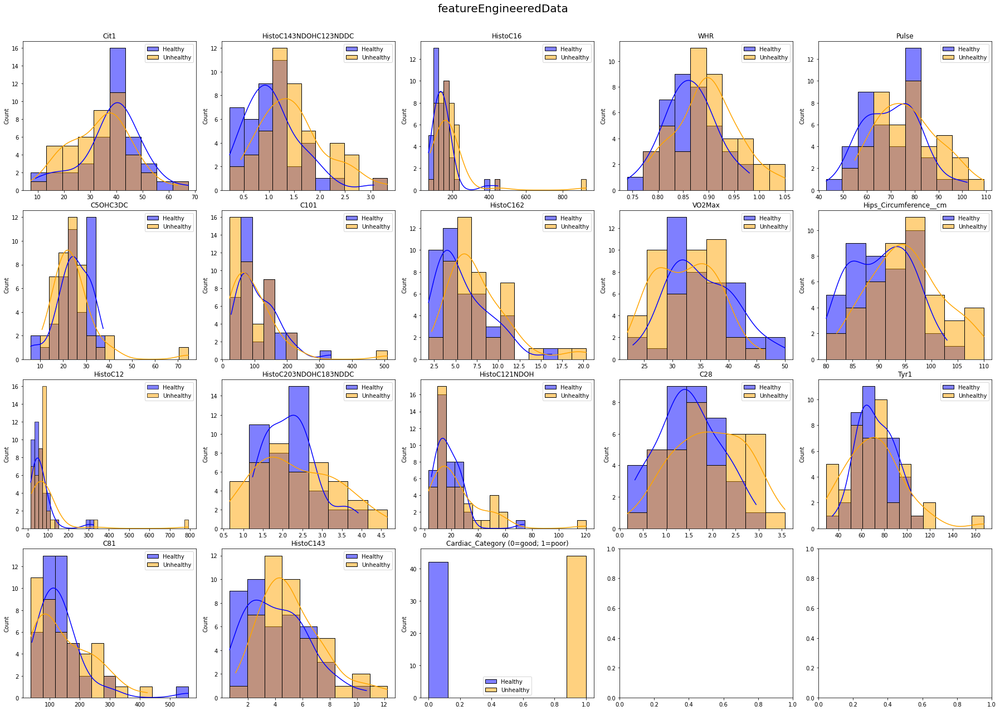

In [129]:
title = "featureEngineeredData"
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]
featureEngineeredDf = data_full[optimisedCols]

mainDf = preprocessDf(featureEngineeredDf,verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)

for idx,column in enumerate(mainDf.columns):
    #plt.figure()    
    # use bins of mainDf, dropping na values in the process         
    bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
    sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
    sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
    #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
#plt.tight_layout()
fig.suptitle(title,fontsize=20, ha='center', va ='center')
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
plt.show()

In [ ]:
# CELLS BELOW ARE OLDER STUFF WITH WRONG/IRRELEVANT PORTIONS

In [ ]:
    
def compareClasModel(df,target,test_size=0.25,title="Dataset",showImportance=False,confusionMatrix=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df)
    
    print("Initialising models...")
    xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=0)
    xTrain = xTrain.fillna(xTrain.median())
    xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LogisticRegression(solver="liblinear").fit(xTrain,yTrain)
    gnb = GaussianNB().fit(xTrain,yTrain)
    knnc = KNeighborsClassifier().fit(xTrain,yTrain)
    dtc = DecisionTreeClassifier(random_state=0).fit(xTrain,yTrain)
    rfc = RandomForestClassifier(random_state=0,verbose=False).fit(xTrain,yTrain)
    gbmc = GradientBoostingClassifier(verbose=False).fit(xTrain,yTrain)
    xgbc = XGBClassifier(use_label_encoder=False,eval_metric= "error").fit(xTrain,yTrain)
    lgbmc = LGBMClassifier().fit(xTrain,yTrain)
    sv = SVC().fit(xTrain,yTrain)

    models = [lr,gnb,knnc,dtc,rfc,gbmc,xgbc,lgbmc,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","AccuracyScore","MeanR2CVScore","MeanCVError"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        predict = model.predict(xTest)
        accuracy = accuracy_score(yTest,predict)

        #confusionMatrixArray = confusion_matrix(yTest, predict)
        #plot_roc_curve(model, xTest, yTest)  
        #print(confusionMatrixArray)

        r2CV = cross_val_score(model,xTest,yTest,cv=5).mean()
        error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=5,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,accuracy,r2CV,error]],columns=["Model","AccuracyScore","MeanR2CVScore","MeanCVError"])
        comparison = comparison.append(result)
        
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name)
            except AttributeError:
                continue
    
    print(comparison)
    print("\n")
    print(f"Highest Accuracy Score: {comparison.loc[comparison['AccuracyScore'] == comparison['AccuracyScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['AccuracyScore'].max(),2)}")
    print(f"Highest CV Score: {comparison.loc[comparison['MeanR2CVScore'] == comparison['MeanR2CVScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVScore'].max(),2)}")
    print(f"Lowest CV Error: {comparison.loc[comparison['MeanCVError'] == comparison['MeanCVError'].min(), 'Model'].iloc[0]}. Score: {round(comparison['MeanCVError'].min(),2)}")
    print("\n")
    comparisonMelted = pd.melt(comparison,id_vars=['Model'])

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Percentage Score')
    plt.xlim(0, 1)
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    
    return comparison
    
def compareRegModel(df,target,test_size=0.25,title="Dataset",showImportance=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df)
    
    print("Predicting " + title)
    xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=0)
    xTrain = xTrain.fillna(xTrain.median())
    xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LinearRegression().fit(xTrain,yTrain)
    pls = PLSRegression().fit(xTrain,yTrain)
    ridge = Ridge().fit(xTrain,yTrain)
    lasso = Lasso().fit(xTrain,yTrain)
    elasticnet = ElasticNet().fit(xTrain,yTrain)
    knnr = KNeighborsRegressor().fit(xTrain,yTrain)
    dtr = DecisionTreeRegressor(random_state=0).fit(xTrain,yTrain)
    baggr = BaggingRegressor(random_state=0,bootstrap_features=True,verbose=False).fit(xTrain,yTrain)
    rfr = RandomForestRegressor(random_state=0,verbose=False).fit(xTrain,yTrain)
    gbmr = GradientBoostingRegressor(verbose=False).fit(xTrain,yTrain)
    xgbr = XGBRegressor().fit(xTrain,yTrain)
    lgbmr = LGBMRegressor().fit(xTrain,yTrain)
    sv = SVR().fit(xTrain,yTrain)

    models = [lr,pls,ridge,lasso,elasticnet,knnr,dtr,baggr,rfr,gbmr,xgbr,lgbmr,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","MeanR2CVScore","MeanR2CVError"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        r2CV = cross_val_score(model,xTest,yTest,cv=5,scoring="r2").mean()
        error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=5,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,r2CV,error]],columns=["Model","MeanR2CVScore","MeanR2CVError"])
        comparison = comparison.append(result)
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name)
            except AttributeError:
                continue
    
    print(comparison)
    print("\n")
    print(f"Highest R2CV Score: {comparison.loc[comparison['MeanR2CVScore'] == comparison['MeanR2CVScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVScore'].max(),2)}")
    print(f"Lowest CV Error: {comparison.loc[comparison['MeanR2CVError'] == comparison['MeanR2CVError'].min(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVError'].min(),2)}")
    print("\n")
    comparison = comparison.drop(["MeanR2CVError"],axis = 1)
    comparisonMelted = pd.melt(comparison,id_vars=['Model'])

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Values')
    plt.xlim(-1,1)
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    
    return comparison
    

Comparing models for Model comparison for full data, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
    feature_names  feature_importance
37      E_A_ratio                 1.0
214     HistoC103                 0.0
194          Arg1                 0.0
193          Phe1                 0.0
192          His1                 0.0


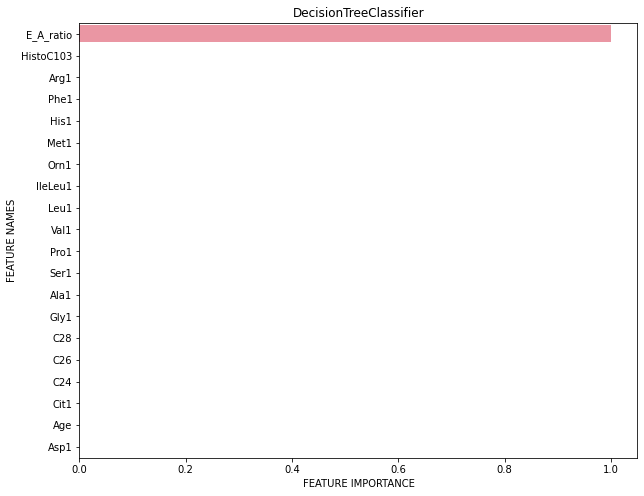

             feature_names  feature_importance
37               E_A_ratio            0.128019
35          MV_E_peak__m_s            0.028979
36          MV_A_peak__m_s            0.021641
236              HistoC162            0.020767
231  HistoC143NDOHC123NDDC            0.015801


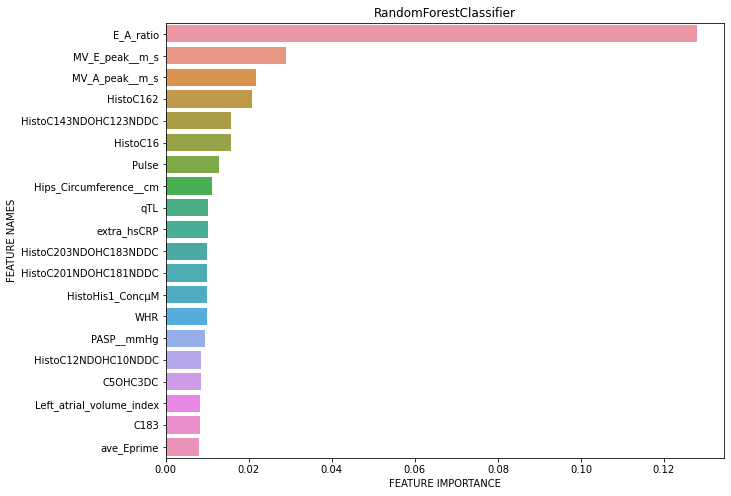

             feature_names  feature_importance
37               E_A_ratio        1.000000e+00
224  HistoC122NDOHC102NDDC        1.245627e-16
207      HistoC5NDOHC3NDDC        1.032644e-16
20                IVSD__cm        7.831556e-17
197                   Asp1        6.652909e-17


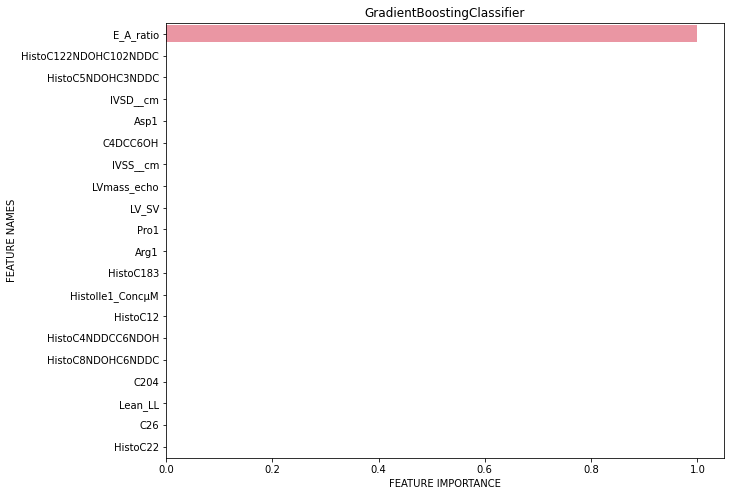

    feature_names  feature_importance
37      E_A_ratio                 1.0
214     HistoC103                 0.0
194          Arg1                 0.0
193          Phe1                 0.0
192          His1                 0.0


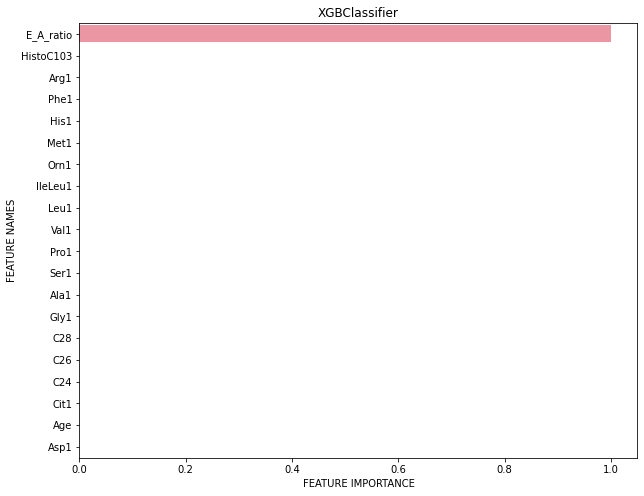

             feature_names  feature_importance
37               E_A_ratio                  58
231  HistoC143NDOHC123NDDC                   7
35          MV_E_peak__m_s                   5
260              HistoC225                   5
22                LVIDD_cm                   5


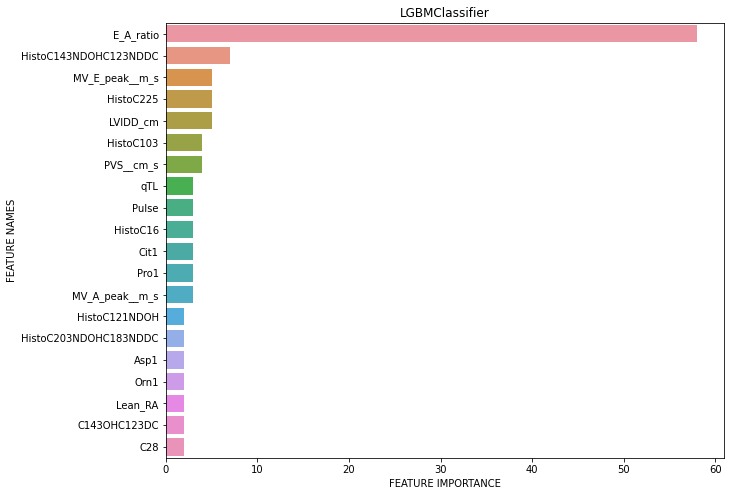

                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.590909           0.35     0.806226
0                  GaussianNB       0.636364           0.41     0.768115
0        KNeighborsClassifier       0.318182           0.28     0.848528
0      DecisionTreeClassifier       1.000000           1.00    -0.000000
0      RandomForestClassifier       0.954545           0.76     0.489898
0  GradientBoostingClassifier       1.000000           1.00    -0.000000
0               XGBClassifier       1.000000           1.00    -0.000000
0              LGBMClassifier       0.954545           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 1.0
Highest CV Score: DecisionTreeClassifier. Score: 1.0
Lowest CV Error: DecisionTreeClassifier. Score: -0.0




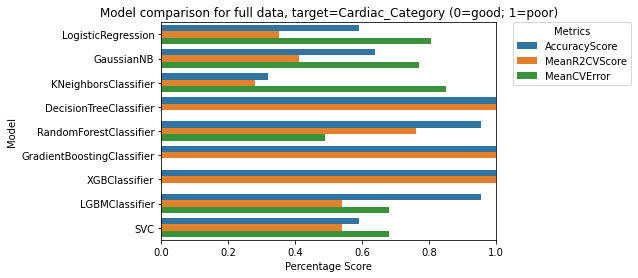

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.590909,0.35,0.806226
0,GaussianNB,0.636364,0.41,0.768115
0,KNeighborsClassifier,0.318182,0.28,0.848528
0,DecisionTreeClassifier,1.000000,1.00,-0.000000
0,RandomForestClassifier,0.954545,0.76,0.489898
0,GradientBoostingClassifier,1.000000,1.00,-0.000000
0,XGBClassifier,1.000000,1.00,-0.000000
0,LGBMClassifier,0.954545,0.54,0.678233
0,SVC,0.590909,0.54,0.678233


In [10]:
# Cell 8
# Using full data to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModel(data_full,targetFeat,title=f"Model comparison for full data, target={targetFeat}",showImportance = True)


Comparing models for Model comparison without E_A_ratio, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
             feature_names  feature_importance
35          MV_E_peak__m_s            0.253910
235              HistoC162            0.222727
195                   Tyr1            0.147321
60                     SRs            0.100595
223  HistoC122NDOHC102NDDC            0.100347


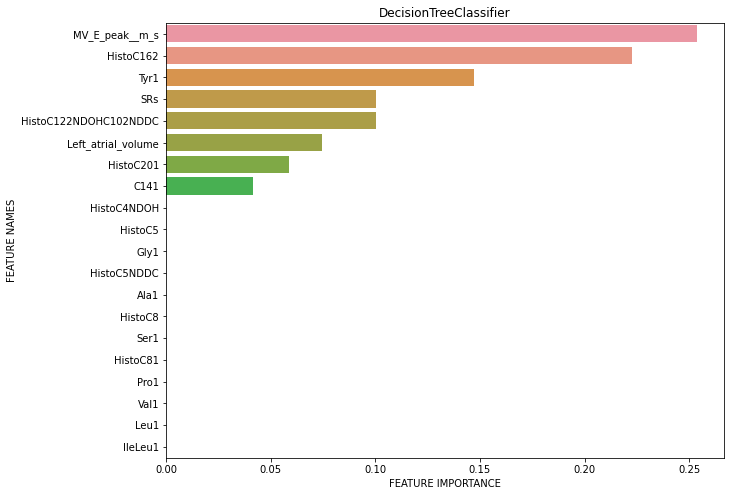

      feature_names  feature_importance
235       HistoC162            0.025754
35   MV_E_peak__m_s            0.017548
18           VO2Max            0.016659
194            Cit1            0.014052
135            C121            0.013712


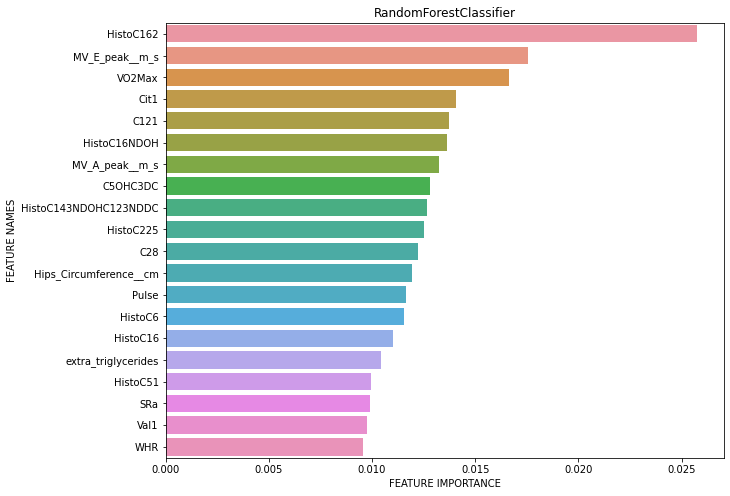

      feature_names  feature_importance
35   MV_E_peak__m_s            0.274912
235       HistoC162            0.162469
36   MV_A_peak__m_s            0.104549
192            Phe1            0.067943
60              SRs            0.059010


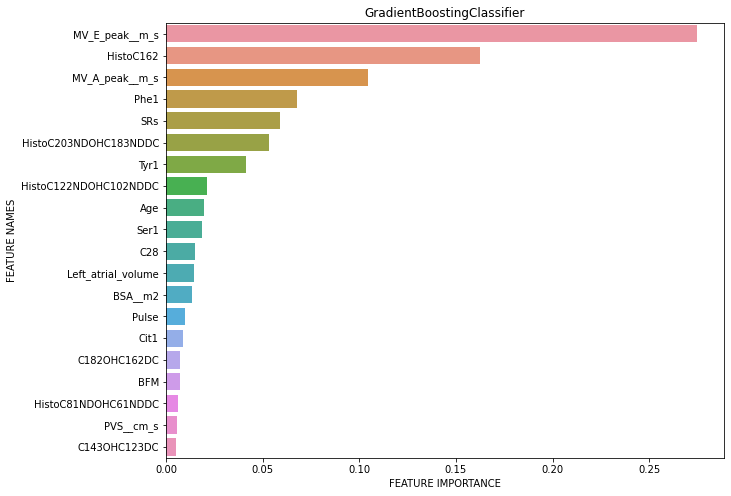

     feature_names  feature_importance
168            C20            0.081136
235      HistoC162            0.078231
68     LAGlobalGLS            0.074640
0              Age            0.057182
70   LAvolumeminml            0.055041


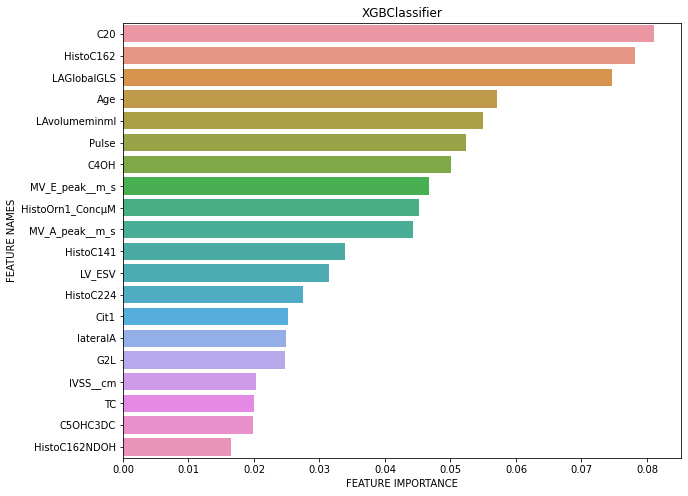

             feature_names  feature_importance
35          MV_E_peak__m_s                  17
194                   Cit1                  13
36          MV_A_peak__m_s                  13
237               HistoC16                   8
230  HistoC143NDOHC123NDDC                   8


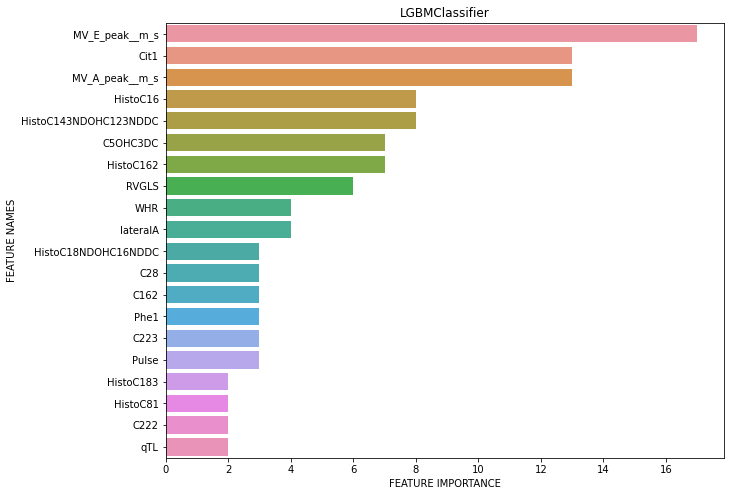

                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.636364           0.35     0.806226
0                  GaussianNB       0.636364           0.37     0.793725
0        KNeighborsClassifier       0.318182           0.28     0.848528
0      DecisionTreeClassifier       0.727273           0.52     0.692820
0      RandomForestClassifier       0.727273           0.62     0.616441
0  GradientBoostingClassifier       0.636364           0.43     0.754983
0               XGBClassifier       0.863636           0.48     0.721110
0              LGBMClassifier       0.818182           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: XGBClassifier. Score: 0.86
Highest CV Score: RandomForestClassifier. Score: 0.62
Lowest CV Error: RandomForestClassifier. Score: 0.62




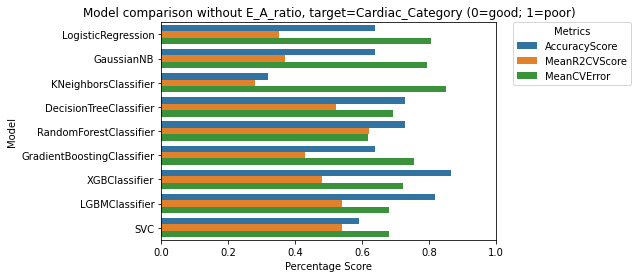

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.636364,0.35,0.806226
0,GaussianNB,0.636364,0.37,0.793725
0,KNeighborsClassifier,0.318182,0.28,0.848528
0,DecisionTreeClassifier,0.727273,0.52,0.692820
0,RandomForestClassifier,0.727273,0.62,0.616441
0,GradientBoostingClassifier,0.636364,0.43,0.754983
0,XGBClassifier,0.863636,0.48,0.721110
0,LGBMClassifier,0.818182,0.54,0.678233
0,SVC,0.590909,0.54,0.678233


In [13]:
# Cell 10
# Use of full data EXCEPT E_A_ratio to classify cardiac cateogry. Performance worsens significantly
targetFeat = "Cardiac_Category (0=good; 1=poor)"
noEAratio = data_full.drop("E_A_ratio",axis = 1)
compareClasModel(noEAratio,targetFeat,title=f"Model comparison without E_A_ratio, target={targetFeat}",showImportance = True)
# Results here shows that only E_A_ratio is necessary to predict cardiac category. Other params have little relevance


In [19]:
data_trunc = data_full.drop(echoCols+cmrCols, axis=1)
data_trunc # Removal of the 2 most predictive sets of features
targetFeat = "Cardiac_Category (0=good; 1=poor)"
confusionMatrixForEachModel(data_trunc,targetFeat)

NameError: name 'confusionMatrixForEachModel' is not defined

Comparing models for Model comparison for clinParams, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.46     0.734847
0                  GaussianNB       0.409091           0.56     0.663325
0        KNeighborsClassifier       0.636364           0.55     0.670820
0      DecisionTreeClassifier       0.454545           0.41     0.768115
0      RandomForestClassifier       0.454545           0.63     0.608276
0  GradientBoostingClassifier       0.318182           0.45     0.707107
0               XGBClassifier       0.590909           0.50     0.707107
0              LGBMClassifier       0.363636           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.68
Highest CV Score: RandomForestClassifier. Score: 0.63
Lowest CV Error: RandomForestClassifier.

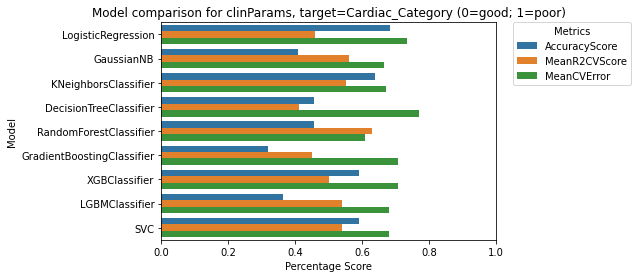

***********************************************
Comparing models for Model comparison for exercise, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.545455           0.49     0.714143
0                  GaussianNB       0.500000           0.46     0.734847
0        KNeighborsClassifier       0.636364           0.39     0.781025
0      DecisionTreeClassifier       0.590909           0.64     0.600000
0      RandomForestClassifier       0.681818           0.41     0.768115
0  GradientBoostingClassifier       0.590909           0.46     0.734847
0               XGBClassifier       0.636364           0.18     0.905539
0              LGBMClassifier       0.454545           0.54     0.678233
0                         SVC       0.454545           0.54     0.678233


Highest Accuracy Score: RandomForestClassifier. Score: 0.68
Highest CV Score: DecisionTreeClassifier. Sc

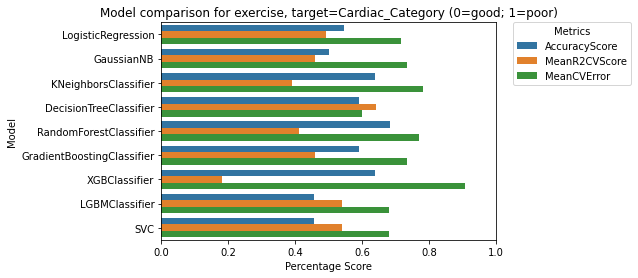

***********************************************
Comparing models for Model comparison for echo, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.35     0.806226
0                  GaussianNB       0.772727           0.68     0.565685
0        KNeighborsClassifier       0.454545           0.55     0.670820
0      DecisionTreeClassifier       1.000000           1.00    -0.000000
0      RandomForestClassifier       1.000000           0.76     0.489898
0  GradientBoostingClassifier       1.000000           1.00    -0.000000
0               XGBClassifier       1.000000           1.00    -0.000000
0              LGBMClassifier       0.954545           0.54     0.678233
0                         SVC       0.500000           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 1.0
Highest CV Score: DecisionTreeClassifier. Score: 

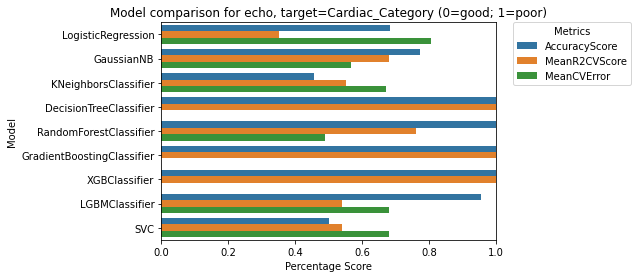

***********************************************
Comparing models for Model comparison for cmr, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.59     0.640312
0                  GaussianNB       0.636364           0.54     0.678233
0        KNeighborsClassifier       0.545455           0.68     0.565685
0      DecisionTreeClassifier       0.727273           0.74     0.509902
0      RandomForestClassifier       0.681818           0.73     0.519615
0  GradientBoostingClassifier       0.727273           0.64     0.600000
0               XGBClassifier       0.681818           0.69     0.556776
0              LGBMClassifier       0.727273           0.54     0.678233
0                         SVC       0.636364           0.59     0.640312


Highest Accuracy Score: DecisionTreeClassifier. Score: 0.73
Highest CV Score: DecisionTreeClassifier. Score: 

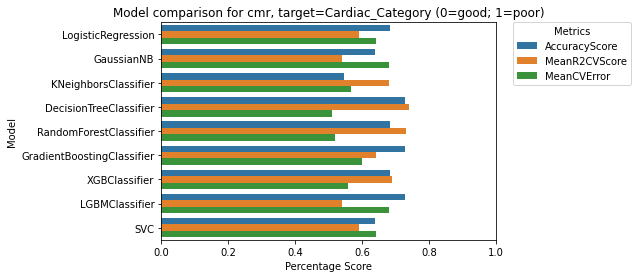

***********************************************
Comparing models for Model comparison for bloodBio, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.636364           0.77     0.479583
0                  GaussianNB       0.545455           0.64     0.600000
0        KNeighborsClassifier       0.545455           0.58     0.648074
0      DecisionTreeClassifier       0.500000           0.39     0.781025
0      RandomForestClassifier       0.545455           0.66     0.583095
0  GradientBoostingClassifier       0.454545           0.40     0.774597
0               XGBClassifier       0.363636           0.52     0.692820
0              LGBMClassifier       0.681818           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: LGBMClassifier. Score: 0.68
Highest CV Score: LogisticRegression. Score: 0.77
Lo

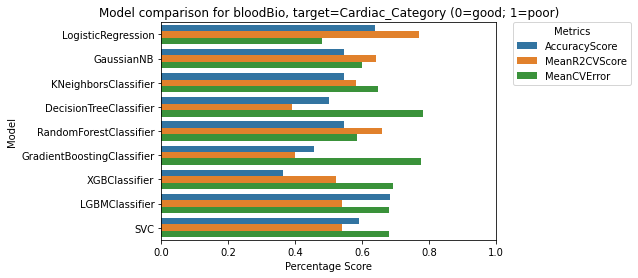

***********************************************
Comparing models for Model comparison for physFuncParams, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.636364           0.52     0.692820
0                  GaussianNB       0.409091           0.73     0.519615
0        KNeighborsClassifier       0.409091           0.73     0.519615
0      DecisionTreeClassifier       0.545455           0.53     0.685565
0      RandomForestClassifier       0.363636           0.67     0.574456
0  GradientBoostingClassifier       0.500000           0.49     0.714143
0               XGBClassifier       0.363636           0.63     0.608276
0              LGBMClassifier       0.636364           0.54     0.678233
0                         SVC       0.363636           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.64
Highest CV Score: GaussianNB. Score: 0.73


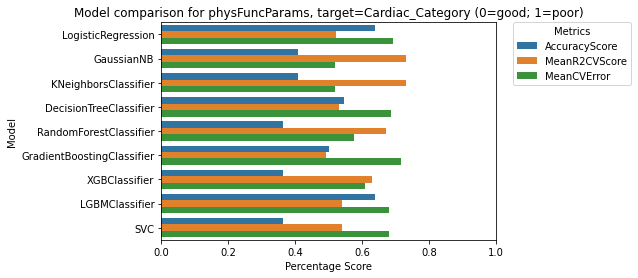

***********************************************
Comparing models for Model comparison for curMeta, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.500000           0.67     0.574456
0                  GaussianNB       0.500000           0.28     0.848528
0        KNeighborsClassifier       0.500000           0.36     0.800000
0      DecisionTreeClassifier       0.318182           0.22     0.883176
0      RandomForestClassifier       0.545455           0.23     0.877496
0  GradientBoostingClassifier       0.363636           0.22     0.883176
0               XGBClassifier       0.545455           0.37     0.793725
0              LGBMClassifier       0.500000           0.54     0.678233
0                         SVC       0.500000           0.49     0.714143


Highest Accuracy Score: RandomForestClassifier. Score: 0.55
Highest CV Score: LogisticRegression. Score: 

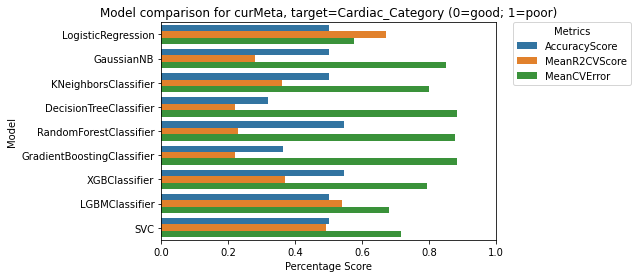

***********************************************
Comparing models for Model comparison for histMeta, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.363636           0.50     0.707107
0                  GaussianNB       0.636364           0.53     0.685565
0        KNeighborsClassifier       0.590909           0.46     0.734847
0      DecisionTreeClassifier       0.772727           0.43     0.754983
0      RandomForestClassifier       0.545455           0.62     0.616441
0  GradientBoostingClassifier       0.500000           0.43     0.754983
0               XGBClassifier       0.590909           0.53     0.685565
0              LGBMClassifier       0.545455           0.54     0.678233
0                         SVC       0.545455           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 0.77
Highest CV Score: RandomForestClassifier. Sc

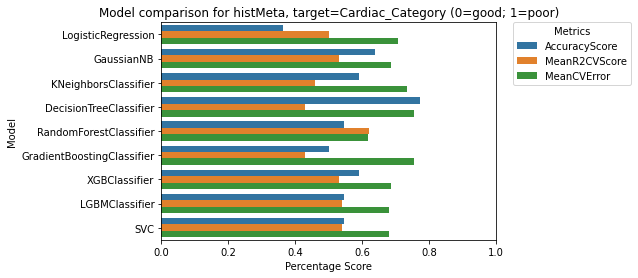

***********************************************


In [11]:
# Cell 9
warnings.filterwarnings(action='ignore', category=UserWarning)

# Use of each group of featrues to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
for key in cc_dfDict:
    compareClasModel(cc_dfDict[key],targetFeat,title=f"Model comparison for {key}, target={targetFeat}")

Comparing models for predicting E_A_ratio with full data
Predicting predicting E_A_ratio with full data
      feature_names  feature_importance
36   MV_A_peak__m_s            0.545294
241    HistoC16NDOH            0.196232
35   MV_E_peak__m_s            0.128819
124            C5DC            0.056258
180             C26            0.013157


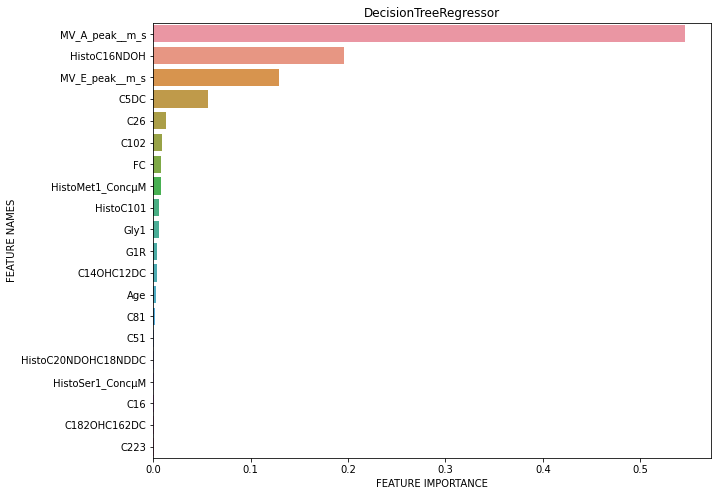

             feature_names  feature_importance
36          MV_A_peak__m_s            0.465546
35          MV_E_peak__m_s            0.104983
18                  VO2Max            0.019739
230  HistoC143NDOHC123NDDC            0.016738
63            SRe_SRaratio            0.014227


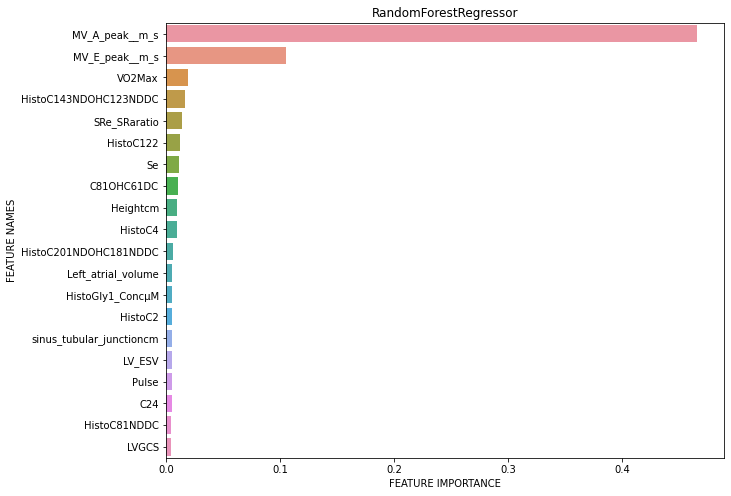

        feature_names  feature_importance
36     MV_A_peak__m_s            0.552100
35     MV_E_peak__m_s            0.216165
241      HistoC16NDOH            0.087494
125        C81OHC61DC            0.019160
280  HistoTyr1_ConcµM            0.010690


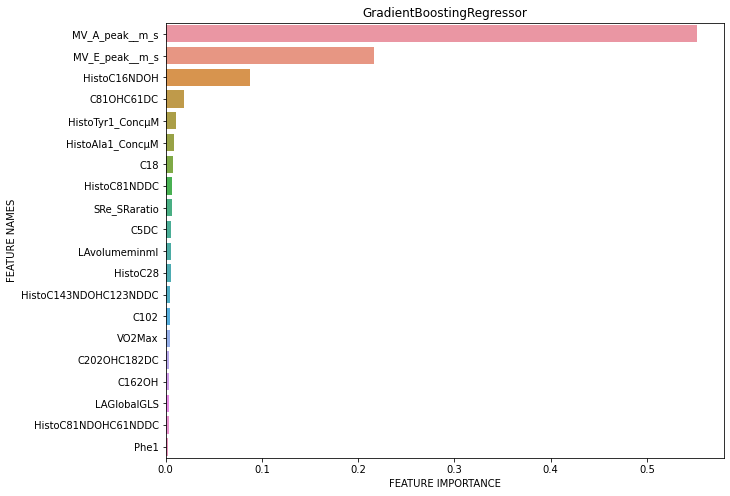

             feature_names  feature_importance
241           HistoC16NDOH            0.410457
230  HistoC143NDOHC123NDDC            0.116876
36          MV_A_peak__m_s            0.109310
77                MCP1pgmL            0.070093
37               MV_DT__ms            0.049180


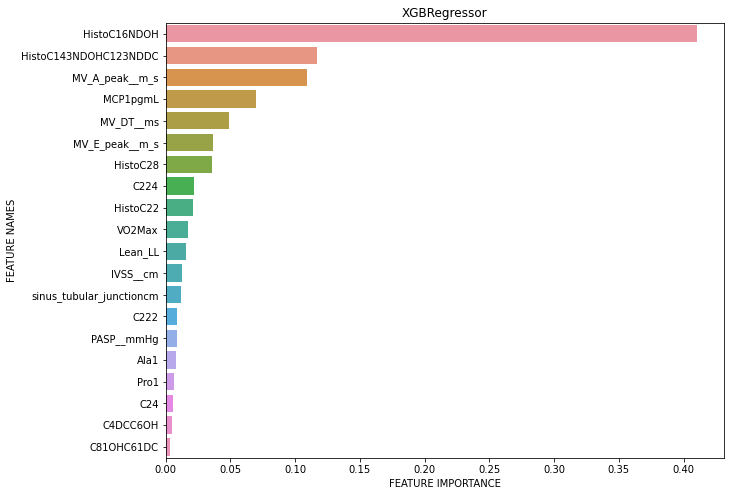

             feature_names  feature_importance
36          MV_A_peak__m_s                  23
35          MV_E_peak__m_s                  20
230  HistoC143NDOHC123NDDC                   7
132                  C81DC                   6
226              HistoC143                   6


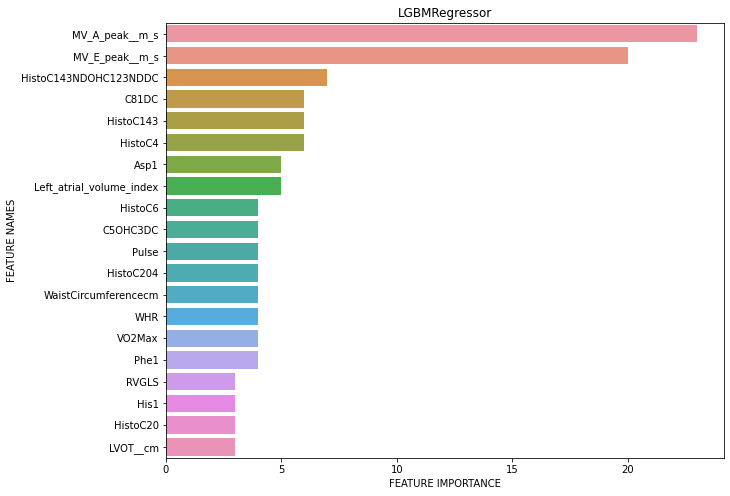

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression     -16.447137       0.476066
0              PLSRegression      -5.725057       0.340032
0                      Ridge     -16.447044       0.476065
0                      Lasso     -26.992927       0.603711
0                 ElasticNet     -31.943195       0.630700
0        KNeighborsRegressor      -1.022298       0.350012
0      DecisionTreeRegressor     -14.612441       0.440236
0           BaggingRegressor      -1.208383       0.316846
0      RandomForestRegressor      -1.773705       0.341803
0  GradientBoostingRegressor      -1.075203       0.291730
0               XGBRegressor      -3.197770       0.409145
0              LGBMRegressor      -0.829219       0.355676
0                        SVR      -0.445836       0.349967


Highest R2CV Score: SVR. Score: -0.45
Lowest CV Error: GradientBoostingRegressor. Score: 0.29




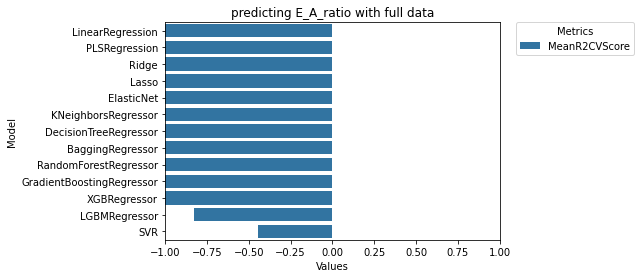

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-16.447137
0,PLSRegression,-5.725057
0,Ridge,-16.447044
0,Lasso,-26.992927
0,ElasticNet,-31.943195
0,KNeighborsRegressor,-1.022298
0,DecisionTreeRegressor,-14.612441
0,BaggingRegressor,-1.208383
0,RandomForestRegressor,-1.773705
0,GradientBoostingRegressor,-1.075203


In [15]:
# Cell 12
# Use all features tgt except cardiac category to predict E_A_ratio through regression
# Results here show that other parameters are insufficient to predict E_A_ratio 
targetFeat = "E_A_ratio"
regOnEARatio = data_full.drop("Cardiac_Category (0=good; 1=poor)",axis = 1)

compareRegModel(regOnEARatio,targetFeat,title="predicting E_A_ratio with full data",showImportance = True)


Comparing models for Cardiac category with echo
Predicting Cardiac category with echo
                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression      -8.291304       1.496730
0              PLSRegression      -0.450084       0.583698
0                      Ridge      -3.305939       1.006642
0                      Lasso      -0.524034       0.599301
0                 ElasticNet      -0.843139       0.659095
0        KNeighborsRegressor      -0.152000       0.521153
0      DecisionTreeRegressor       1.000000      -0.000000
0           BaggingRegressor       0.469333       0.350286
0      RandomForestRegressor       0.920543       0.140029
0  GradientBoostingRegressor       1.000000       0.000013
0               XGBRegressor       1.000000       0.000201
0              LGBMRegressor      -0.105284       0.505290
0                        SVR      -0.549408       0.604434


Highest R2CV Score: DecisionTreeRegressor. Score: 1.0
Lowest CV Error: DecisionTreeReg

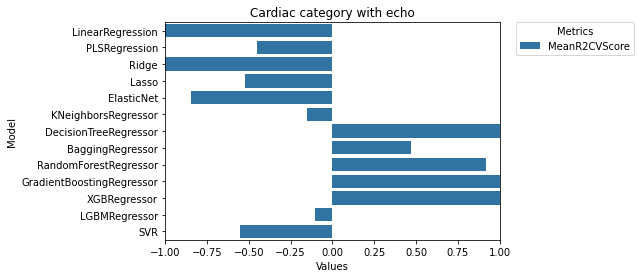

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-8.291304
0,PLSRegression,-0.450084
0,Ridge,-3.305939
0,Lasso,-0.524034
0,ElasticNet,-0.843139
0,KNeighborsRegressor,-0.152000
0,DecisionTreeRegressor,1.000000
0,BaggingRegressor,0.469333
0,RandomForestRegressor,0.920543
0,GradientBoostingRegressor,1.000000


In [14]:
# Cell 11
# Predicting cardiac cateogory with regression methods using echo params. 
# Demonstrate that regression methods are also useful in prediction
compareRegModel(cc_dfDict["echo"],"Cardiac_Category (0=good; 1=poor)",title="Cardiac category with echo",showImportance=False)

Comparing models for LVEF using physFuncParamsCols
Predicting LVEF using physFuncParamsCols
   feature_names  feature_importance
1            G1L            0.240008
14       Lean_RL            0.169822
10           BMR            0.153406
2            G2L            0.104795
4            G2R            0.103295


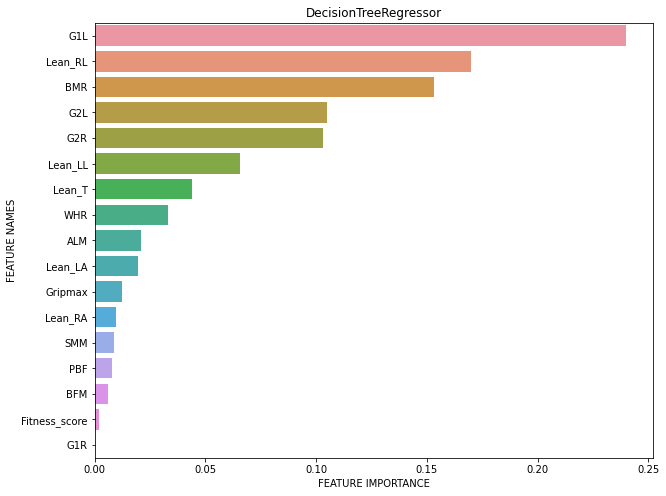

   feature_names  feature_importance
4            G2R            0.113192
9  Fitness_score            0.087380
7            PBF            0.076449
2            G2L            0.069341
6            BFM            0.068221


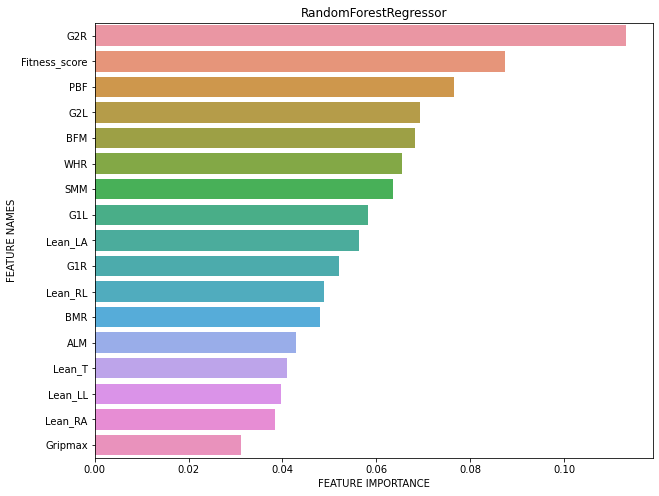

   feature_names  feature_importance
1            G1L            0.145391
5            SMM            0.099611
13       Lean_LL            0.099595
7            PBF            0.083905
2            G2L            0.079643


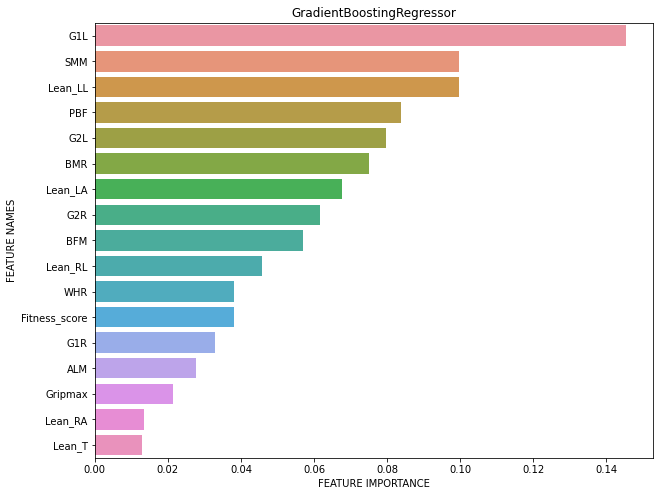

   feature_names  feature_importance
16           ALM            0.176009
15        Lean_T            0.151248
14       Lean_RL            0.132927
7            PBF            0.098546
10           BMR            0.095847


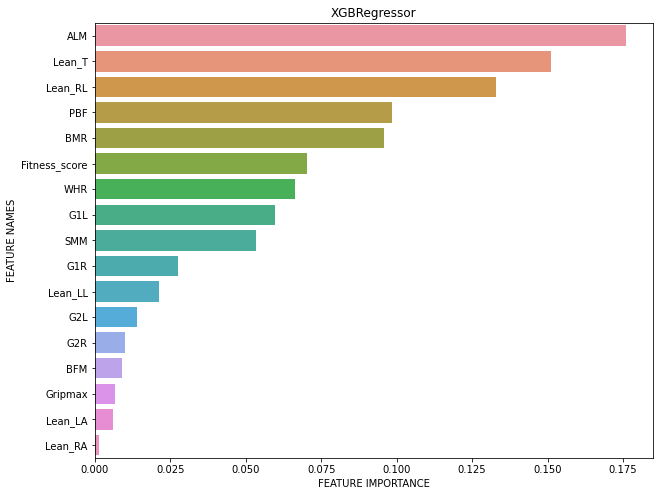

   feature_names  feature_importance
1            G1L                  25
4            G2R                  22
2            G2L                  15
7            PBF                  14
9  Fitness_score                  13


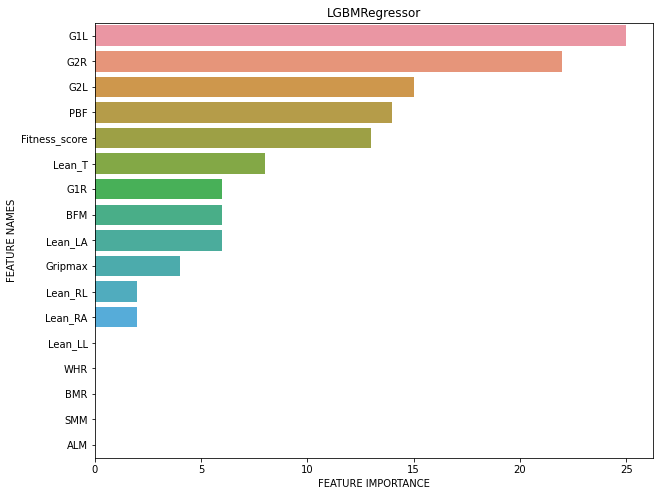

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression    -141.643312      60.268071
0              PLSRegression      -1.165972       9.220132
0                      Ridge      -4.650870      13.442243
0                      Lasso      -4.567326      12.931992
0                 ElasticNet      -4.767279      13.340798
0        KNeighborsRegressor      -0.610478       7.814793
0      DecisionTreeRegressor      -2.483624      11.468083
0           BaggingRegressor      -0.428481       7.691354
0      RandomForestRegressor      -0.633695       7.810748
0  GradientBoostingRegressor      -1.046094       8.627741
0               XGBRegressor      -1.037528       8.603921
0              LGBMRegressor      -0.131926       7.195193
0                        SVR      -0.149191       7.348617


Highest R2CV Score: LGBMRegressor. Score: -0.13
Lowest CV Error: LGBMRegressor. Score: 7.2




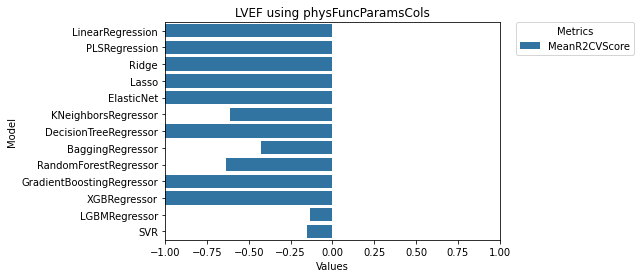

***********************************************
Comparing models for E_A_ratio using physFuncParamsCols
Predicting E_A_ratio using physFuncParamsCols
  feature_names  feature_importance
2           G2L            0.379393
8           WHR            0.335086
6           BFM            0.098398
4           G2R            0.038248
1           G1L            0.037635


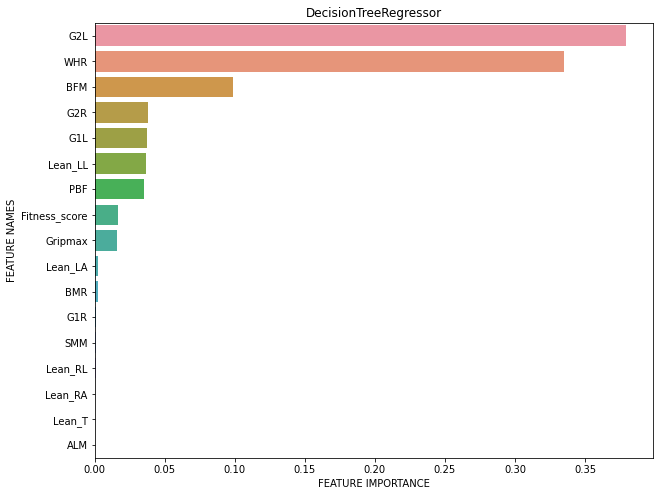

  feature_names  feature_importance
8           WHR            0.196441
7           PBF            0.125523
6           BFM            0.108209
2           G2L            0.100833
1           G1L            0.068552


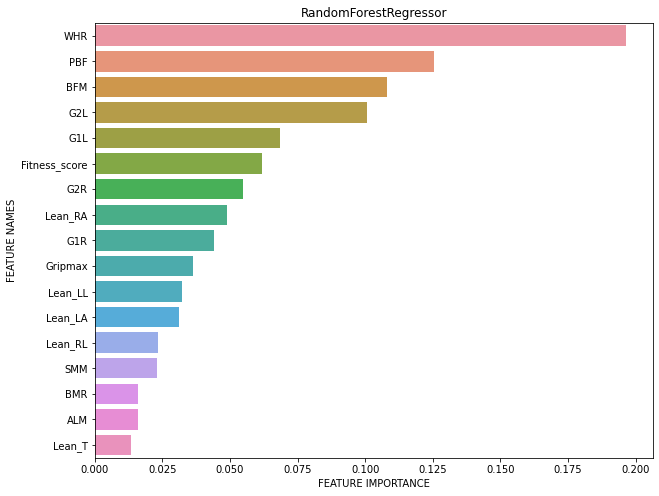

  feature_names  feature_importance
8           WHR            0.228516
2           G2L            0.215569
4           G2R            0.102338
1           G1L            0.088883
6           BFM            0.078107


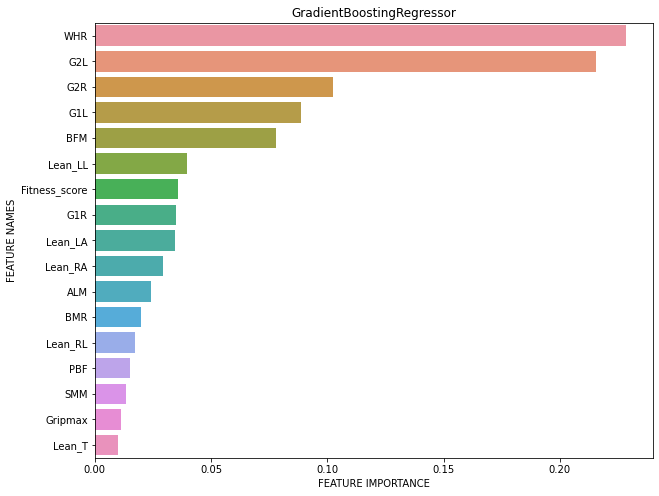

   feature_names  feature_importance
8            WHR            0.428150
2            G2L            0.127935
13       Lean_LL            0.097695
4            G2R            0.070806
12       Lean_RA            0.061096


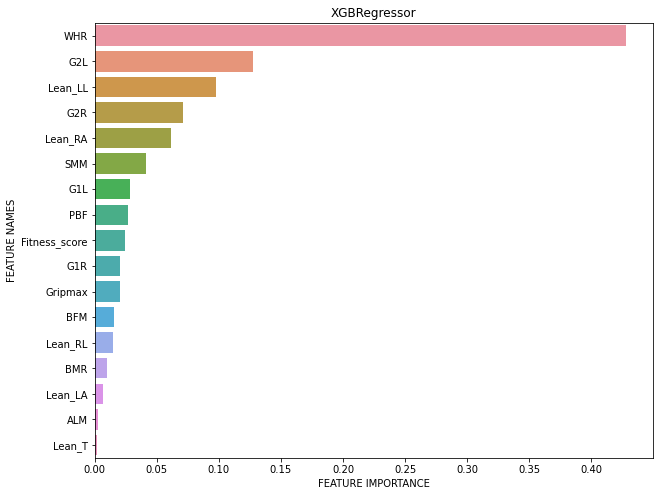

  feature_names  feature_importance
2           G2L                  23
1           G1L                  21
8           WHR                  20
4           G2R                  10
7           PBF                  10


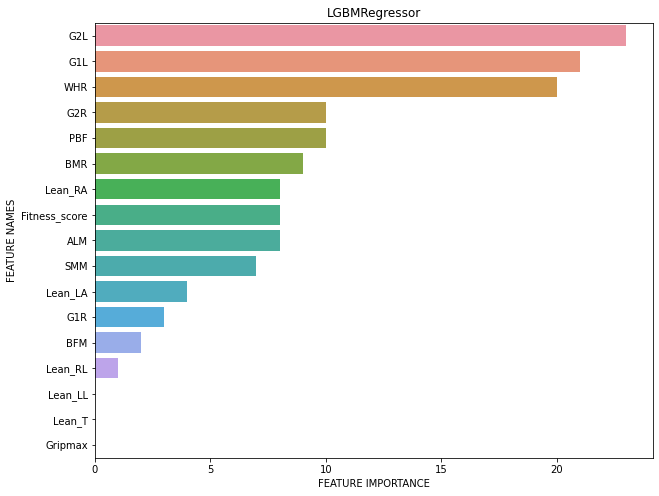

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression -537051.349666     121.366646
0              PLSRegression     -10.186138       0.413199
0                      Ridge     -49.669986       1.131993
0                      Lasso      -7.197342       0.362123
0                 ElasticNet      -7.915685       0.385541
0        KNeighborsRegressor     -11.374406       0.403204
0      DecisionTreeRegressor     -11.879152       0.526562
0           BaggingRegressor      -8.512666       0.407048
0      RandomForestRegressor      -9.442160       0.416582
0  GradientBoostingRegressor     -10.793473       0.471810
0               XGBRegressor     -12.384297       0.509520
0              LGBMRegressor      -0.829219       0.355676
0                        SVR      -3.724190       0.360071


Highest R2CV Score: LGBMRegressor. Score: -0.83
Lowest CV Error: LGBMRegressor. Score: 0.36




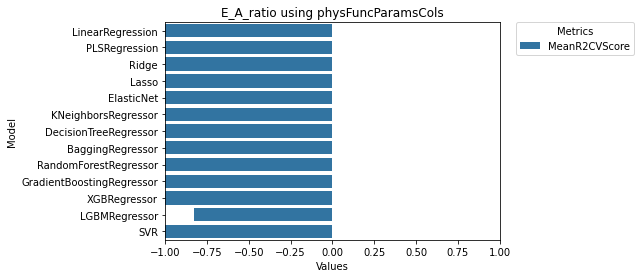

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-537051.349666
0,PLSRegression,-10.186138
0,Ridge,-49.669986
0,Lasso,-7.197342
0,ElasticNet,-7.915685
0,KNeighborsRegressor,-11.374406
0,DecisionTreeRegressor,-11.879152
0,BaggingRegressor,-8.512666
0,RandomForestRegressor,-9.442160
0,GradientBoostingRegressor,-10.793473


In [16]:
# Cell 13
# Attempting to predict LVEF and E_A_ratio using physical functional parameters through regression

#regData1 = data[physFuncParamsCols + ["LVEF"]]
#regData2 = data[physFuncParamsCols + ["E_A_ratio"]]
compareRegModel(regData1,"LVEF",title="LVEF using physFuncParamsCols", showImportance=True)
compareRegModel(regData2,"E_A_ratio",title="E_A_ratio using physFuncParamsCols", showImportance=True)


Comparing models for Model comparison for curated data, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.545455           0.35     0.806226
0                  GaussianNB       0.500000           0.45     0.741620
0        KNeighborsClassifier       0.500000           0.50     0.707107
0      DecisionTreeClassifier       0.500000           0.26     0.860233
0      RandomForestClassifier       0.545455           0.34     0.812404
0  GradientBoostingClassifier       0.454545           0.49     0.714143
0               XGBClassifier       0.454545           0.44     0.748331
0              LGBMClassifier       0.500000           0.54     0.678233
0                         SVC       0.500000           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.55
Highest CV Score: LGBMClassifier. Score: 0.54
Lowest CV Error: LGBMClassifier. Score: 0.68



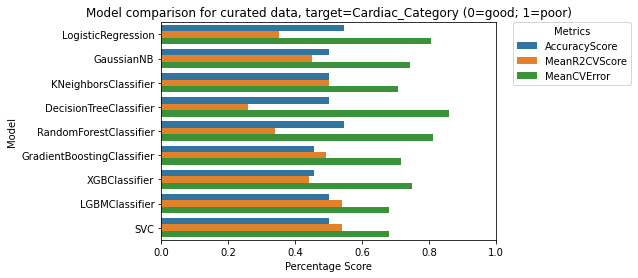

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.545455,0.35,0.806226
0,GaussianNB,0.500000,0.45,0.741620
0,KNeighborsClassifier,0.500000,0.50,0.707107
0,DecisionTreeClassifier,0.500000,0.26,0.860233
0,RandomForestClassifier,0.545455,0.34,0.812404
0,GradientBoostingClassifier,0.454545,0.49,0.714143
0,XGBClassifier,0.454545,0.44,0.748331
0,LGBMClassifier,0.500000,0.54,0.678233
0,SVC,0.500000,0.54,0.678233


In [8]:
# Cell 15
# Manually combine most important features
mostImptCols = ["VO2Max","HistoC162","C5OHC3DC","WHR","HistoC163NDOHC143NDDC","HistoHis1_ConcµM","C222","Pulse","Hips_Circumference__cm","Cit1","qTL","HistoC16","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[mostImptCols]

# Scores got even worse
targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModel(curatedDf,targetFeat,title=f"Model comparison for curated data, target={targetFeat}")

In [74]:
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[selfMadeCols]

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=1,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=0,verbose=False).fit(xTrain,yTrain)

yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
xImputed = x.fillna(x.median())
cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvAccuracyScore = cvAccuracyScoreArray.mean()
#cvRocAucScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='roc_auc').mean()
#cvRecallScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='recall').mean()
#cvPrecisionScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='precision').mean()
#cvF1Score = cross_val_score(model,xTest,yTest,cv=cv,scoring='f1').mean()

print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
cvAccuracyScoreArray

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28      13.95
C102      6.98
WHR       5.81
HSTNI     4.65
qTL       1.16
C101      1.16
C222      1.16
dtype: float64
Original Shape:(86, 31)
Final Shape:(86, 31)
______________________________
Initialising models...
Accuracy: 0.6923076923076923
Predictions: 
[0 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.678169934640523


array([0.77777778, 0.64705882, 0.52941176, 0.70588235, 0.76470588,
       0.66666667, 0.52941176, 0.64705882, 0.58823529, 0.52941176,
       0.55555556, 0.70588235, 0.64705882, 0.82352941, 0.76470588,
       0.61111111, 0.82352941, 0.76470588, 0.64705882, 0.82352941,
       0.61111111, 0.88235294, 0.64705882, 0.70588235, 0.64705882,
       0.72222222, 0.94117647, 0.64705882, 0.58823529, 0.41176471,
       0.55555556, 0.64705882, 0.88235294, 0.64705882, 0.64705882,
       0.55555556, 0.64705882, 0.58823529, 0.58823529, 0.76470588,
       0.72222222, 0.70588235, 0.70588235, 0.88235294, 0.70588235,
       0.77777778, 0.58823529, 0.64705882, 0.64705882, 0.64705882])

In [57]:
mostImptCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[mostImptCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
plotAOCForSVM(curatedDf,targetFeat)

KeyError: "None of [Int64Index([11, 13, 16, 18, 19, 21, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,\n            35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,\n            52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,\n            69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,\n            85],\n           dtype='int64')] are in the [columns]"

In [25]:
# Cell 16
# Grid Search for tuning LGBM to predict E_A_Ratio using physical functional params
df = regData2
target = "E_A_ratio"
params = {"n_estimators": [50,100, 500],
          "subsample": [0.2,0.4, 0.6, 0.8, 1.0],
          "max_depth": [2, 3, 4, 5],
          "learning_rate": [0.1, 0.01, 0.02, 0.05],
          "min_child_samples": [5, 10, 20, 40]}
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df)

#print("Predicting " + title)
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.25,random_state=0)  
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
lgbmr = LGBMRegressor().fit(xTrain,yTrain)
cv = GridSearchCV(lgbmr,params,cv=5,verbose=1,n_jobs=-1,scoring="r2").fit(xTrain,yTrain)
print(cv.best_params_)
print(cv.best_score_)

Fitting 5 folds for each of 960 candidates, totalling 4800 fits
{'learning_rate': 0.01, 'max_depth': 2, 'min_child_samples': 5, 'n_estimators': 100, 'subsample': 0.2}
0.0706065044524327


In [26]:
# Cell 17
# Hyperparameter tuning for random forest using grid search

df = regData2
target = "E_A_ratio"
params = {
    'bootstrap': [True],
    'max_depth': [80,100, 120, 150],
    'max_features': [2, 3, 4, 5],
    'min_samples_leaf': [3, 4, 5, 6,7,8],
    'min_samples_split': [14,16,18,20],
    'n_estimators': [5,10,25]
}
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df)

#print("Predicting " + title)
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.25,random_state=0)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
rf = RandomForestRegressor().fit(xTrain,yTrain)
# Instantiate the grid search model
cv = GridSearchCV(rf,params,cv = 5, n_jobs = -1, verbose = 2,scoring="r2").fit(xTrain,yTrain)

print(cv.best_params_)
print(cv.best_score_)

Fitting 5 folds for each of 1152 candidates, totalling 5760 fits
{'bootstrap': True, 'max_depth': 120, 'max_features': 4, 'min_samples_leaf': 8, 'min_samples_split': 16, 'n_estimators': 10}
0.15674596450999442
